# Can neural responses distinguish static vs. dynamic stimuli?

We're working with data from a session (ID: 798911424) of the experiments performed by The Allen Brain Observatory as part of their Visual Coding Neuropixels project. We specifically take neural data in response to the Brain Observatory 1.1 stimulus set, which is one of the stimulus sets created by them for the experiments. More in general, by looking at this particular session we try to gain knowledge on neural coding of visual information in the mouse brain.
We work also with data from another session (ID: 766640955). This data takes response to the Functional Connectivity stimulus set. In this set the natural movie one is shown to the specimen both naturally and shuffled.

## Session characteristics

The session 798911424 has the following properties:

- **Recording date**: October 2018 (published on 2019-10-03)
- **Specimen**: Female mouse (110 days old)
- **Genotype**: Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt
- **Neural data**: 825 isolated units (putative neurons) across 2233 channels
- **Recording equipment**: 6 Neuropixels probes with 374 data channels each
- **Brain regions recorded**: Multiple areas including visual cortex (VISp, VISrl, VISl, VISal), hippocampus (CA1, CA3, DG, HPF), thalamus (TH, LP), and other regions (APN, Eth)

The session 766640955 has the following properties:

- **Recording date**: October 2018 (published on 2019-10-03)
- **Specimen**: Male mouse (133 days old)
- **Genotype**: wt/wt
- **Neural data**: 842 isolated units (putative neurons) across 2233 channels
- **Recording equipment**: 6 Neuropixels probes 
- **Brain regions recorded**: Multiple areas including visual cortex (VISp, VISrl, VISl, VISal), hippocampus (CA1, CA3, DG), thalamus (TH, LP), and other regions (APN, MGd)


## Stimulus set (Brain Observatory 1.1)

The session includes various visual stimuli presented to the mouse while recording neural activity:

- **Natural scenes**: 118 static natural images (plus 1 blank screen control) presented for 250ms each, with each image repeated 50 times in randomised order
- **Natural movie one**: A 30-second clip from "Touch of Evil" (Zugsmith & Welles, 1958) repeated 20 times (organised as 2 blocks of 10 repetitions)
- **Natural movie three**: A 120-second clip from the same film repeated 10 times (organised as 2 blocks of 5 repetitions)
- **Additional stimuli**: Spontaneous activity, gabors, flashes, drifting gratings, static gratings, and drifting gratings with contrast variations

## Stimulus set (Functional Connectivity)

The session includes:
- **Natural movie one more repeats**:  A 30-second clip from "Touch of Evil" (Zugsmith & Welles, 1958) repeated 60 times
- **Natural movie shuffled**: The same 30-second clip but the frames are shuffled, repeated 20 times
- **Additional stimuli**: Spontaneous activity, gabors, flashes, drifting gratings, static gratings, dot motions, and drifting gratings with contrast variations

## Data organisation

The neural data in these sessions is organized in the Neurodata Without Borders (NWB) format and includes:

- **Spike times**: Timestamps for each action potential recorded from each isolated unit
- **Spike amplitudes**: Amplitude values for each recorded spike
- **Mean waveforms**: Average spike waveform for each unit
- **Stimulus information**: Detailed timing and parameter information for each stimulus presentation
- **Quality metrics**: Metrics for assessing unit isolation quality (ISI violations, amplitude cutoff, presence ratio)
- **LFP data**: Local field potential recordings sampled at ~1250 Hz (downsampled from 2.5 kHz)
- **Behavioral data**: Running speed and eye tracking information during the recording session

Sources:\
[1] https://brainmapportal-live-4cc80a57cd6e400d854-f7fdcae.divio-media.net/filer_public/80/75/8075a100-ca64-429a-b39a-569121b612b2/neuropixels_visual_coding_-_white_paper_v10.pdf \
[2] https://allensdk.readthedocs.io/en/latest/visual_coding_neuropixels.html

## How we use this data

Our goal is to analyse the differences between neural encoding of static images compared to individual frames from a movie, so the difference between how the brain perceives static vs. dynamic stimuli. After an initial data exploration we hope to build a machine learning model (specifically a Support Vector Machine) which learns to predict whether the picture presented to it is an image from the natural scenes or a frame from one of the natural movies (natural movie 1 or natural movie 3). 

Then we also do in-depth statistical analysis, based on different metrics (firing rate, Fano factor, latency) and incorporating differences between activity in various brain areas. In the end we also look at the differences between normal and shuffled movies.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import joblib
import os
import seaborn as sns
from scipy import stats
from tqdm import tqdm 

from scipy.stats import gaussian_kde, pointbiserialr, ttest_ind, wilcoxon, mannwhitneyu
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from allensdk.brain_observatory.ecephys.ecephys_project_cache import EcephysProjectCache
from allensdk.core.mouse_connectivity_cache import MouseConnectivityCache

from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, balanced_accuracy_score
from sklearn.utils.class_weight import compute_class_weight

/opt/anaconda3/envs/envallen/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
cache = EcephysProjectCache.from_warehouse(manifest="./allendata/manifest.json")
# the manifest.json file is a configuration file used by the AllenSDK to track:
# which data files have been downloaded, where they're stored locally, and metadata about data versions and formats
session = cache.get_session_data(798911424)

print("Stimulus types:", session.stimulus_names)
print("Structures recorded:", session.structure_acronyms)
print("Units count:", len(session.units))

/opt/anaconda3/envs/envallen/lib/python3.11/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/opt/anaconda3/envs/envallen/lib/python3.11/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


Stimulus types: ['spontaneous', 'gabors', 'flashes', 'drifting_gratings', 'natural_movie_three', 'natural_movie_one', 'static_gratings', 'natural_scenes', 'drifting_gratings_contrast']
Structures recorded: ['LP', 'DG', 'CA1', 'VISam', nan, 'APN', 'TH', 'Eth', 'CA3', 'VISrl', 'HPF', 'ProS', 'SUB', 'VISp', 'CA2', 'VISl', 'MB', 'NOT', 'LGv', 'VISal']
Units count: 825


(nan = could not be mapped to a specific brain region)

In [3]:
session1 = cache.get_session_data(766640955)

print("Stimulus types:", session1.stimulus_names)
print("Structures recorded:", session1.structure_acronyms)
print("Units count:", len(session1.units))

Stimulus types: ['spontaneous', 'gabors', 'flashes', 'drifting_gratings_contrast', 'natural_movie_one_more_repeats', 'natural_movie_one_shuffled', 'drifting_gratings_75_repeats', 'dot_motion']
Structures recorded: [nan, 'MB', 'APN', 'NOT', 'DG', 'CA1', 'VISam', 'PF', 'TH', 'LP', 'VISmma', 'VISp', 'VISl', 'MGd', 'CA3', 'VPM', 'LGd', 'VISal', 'VISrl']
Units count: 842


Each unit likely corresponds to one neuron.

## Importing and visualising the data

The Natural Images stimulus consisted of 118 natural images taken from the Berkeley Segmentation Dataset (Martin et al., 2001), the van Hateren Natural Image Dataset (van Hateren and van der Schaaf,1998), and the McGill Calibrated Colour Image Database (Olmos and Kingdom, 2004). The images were presented in grayscale and were contrast normalized and resized to 1174 x 918 pixels. The images were presented in a random order for 0.25 seconds each, with no intervening gray period. Two natural movie clips were taken from the opening scene of the movie Touch of Evil (Welles, 1958). Natural Movie One was a 30 second clips repeated 20 times (2 blocks of 10), while Natural Movie Three was a 120 second clip repeated 10 times (2 blocks of 5).

Natural scenes: 118 images × 50 repeats (250ms each) \
Movies: Continuous 30s/120s clips × 20/10 repeats

In [4]:
data_dir = "./allendata"
movie_dir = os.path.join(data_dir, "natural_movie_templates")
os.makedirs(movie_dir, exist_ok=True)

Downloading the movies and doing the following visualisations is not necessary for the study, but useful to get an idea of the appearance of the stimuli.

In [5]:
cache.get_natural_movie_template(1)
cache.get_natural_movie_template(3)

movie_dir = os.path.join(data_dir, "natural_movie_templates")
movie1_path = os.path.join(movie_dir, "natural_movie_1.h5")
movie3_path = os.path.join(movie_dir, "natural_movie_3.h5")

print(f"Natural Movie 1 path: {movie1_path}")
print(f"Natural Movie 3 path: {movie3_path}")

Natural Movie 1 path: ./allendata/natural_movie_templates/natural_movie_1.h5
Natural Movie 3 path: ./allendata/natural_movie_templates/natural_movie_3.h5


In [6]:
movie1_data = cache.get_natural_movie_template(1)
movie3_data = cache.get_natural_movie_template(3)

In [ ]:
# display a grid of frames from movie 1
fig, axes = plt.subplots(ncols=5, nrows=5, figsize=(15, 15), layout="constrained")
frames_to_show = np.linspace(0, movie1_data.shape[0]-1, 25).astype(int)  # 25 evenly spaced frame indices from 0 to the last frame index

for i, frame_idx in enumerate(frames_to_show):
    x, y = i // 5, i % 5
    axes[x, y].imshow(movie1_data[frame_idx], cmap="gray")
    axes[x, y].set_title(f"Frame {frame_idx}")
    axes[x, y].set_xticks([])
    axes[x, y].set_yticks([])

plt.suptitle("Movie 1 - Sample Frames", fontsize=16)
plt.savefig("movie1_frames.pdf", dpi=300, bbox_inches="tight")
plt.show()

# display a grid of frames from movie 3
fig, axes = plt.subplots(ncols=5, nrows=5, figsize=(15, 15), layout="constrained")
frames_to_show = np.linspace(0, movie3_data.shape[0]-1, 25).astype(int)

for i, frame_idx in enumerate(frames_to_show):
    x, y = i // 5, i % 5
    axes[x, y].imshow(movie3_data[frame_idx], cmap="gray")
    axes[x, y].set_title(f"Frame {frame_idx}")
    axes[x, y].set_xticks([])
    axes[x, y].set_yticks([])

plt.suptitle("Movie 3 - Sample Frames", fontsize=16)
plt.savefig("movie3_frames.pdf", dpi=300, bbox_inches="tight")
plt.show()

In [8]:
# create an animation from a movie (basically a GIF)
def create_movie_animation(movie_data, step=5, frames=100, filename=None):
    fig, ax = plt.subplots(figsize=(8, 8))
    
    img = ax.imshow(movie_data[0], cmap='gray')
    ax.set_xticks([])
    ax.set_yticks([])
    title = ax.set_title(f"Frame: 0")
    
    # update function for animation
    def update(frame_idx): # frame_idx is the index of the frame in the animation
        real_idx = frame_idx * step
        if real_idx < len(movie_data):
            img.set_array(movie_data[real_idx])
            title.set_text(f"Frame: {real_idx}")
        return [img, title]
    
    # create animation
    anim = FuncAnimation(fig, update, frames=min(frames, len(movie_data)//step), 
                         interval=100, blit=True) # blit=True means only re-draw the parts that have changed (might be more efficient)
    
    # save if filename provided
    if filename:
        anim.save(filename, writer='pillow', fps=10) # 'pillow': python imaging lib that allows saving animations in GIF format
    
    plt.close()
    return anim

# create animations for both movies
anim1 = create_movie_animation(movie1_data, step=10, frames=50, filename="movie1_animation.gif")
anim3 = create_movie_animation(movie3_data, step=40, frames=50, filename="movie3_animation.gif")

print("Animations saved as 'movie1_animation.gif' and 'movie3_animation.gif'")

Animations saved as 'movie1_animation.gif' and 'movie3_animation.gif'


In [9]:
nphotos = 118
for i in range(nphotos):
    tmp = cache.get_natural_scene_template(i)
del tmp
# we create a temporary variable to force the cache to download the data (natural scenes)

In [ ]:
#Let's create a beautiful 11x11 reference plot with all the images
fig, axes = plt.subplots(ncols=11, nrows=11, figsize=(15,15), layout="constrained")
L = 11
for x in range(L):
    for y in range(L):
        index = y + x*L # index is the number of the image
        axes[x,y].set_title(index)
        axes[x,y].set_xticks([])
        axes[x,y].set_yticks([])
        if index < 118:
            axes[x,y].imshow(cache.get_natural_scene_template(index), cmap="gray")

plt.savefig("natural_scenes.pdf", dpi=300, bbox_inches="tight")
plt.show()

In [11]:
scene_shapes = []
scene_min_values = []
scene_max_values = []
scene_mean_values = []

# sample a few images for analysis
sample_indices = [0, 25, 50, 75, 100]
print("Sample of natural scene image metadata:")
print("-" * 60)
print(f"{'Index':<10}{'Shape':<20}{'Min':<10}{'Max':<10}{'Mean':<10}")
print("-" * 60)

for i in sample_indices:
    if i < 118:
        img = cache.get_natural_scene_template(i)
        scene_shapes.append(img.shape)
        scene_min_values.append(img.min())
        scene_max_values.append(img.max())
        scene_mean_values.append(img.mean())
        # values are the colour values of the pixels in the image (grayscale)
        print(f"{i:<10}{str(img.shape):<20}{img.min():<10.2f}{img.max():<10.2f}{img.mean():<10.2f}")

# summary statistics for all images
print("\nSummary for all natural scene images:")
print(f"All images have the same shape: {all(shape == scene_shapes[0] for shape in scene_shapes)}")
if all(shape == scene_shapes[0] for shape in scene_shapes):
    print(f"Image shape: {scene_shapes[0]}")

# compare with movie frames
print("\nComparison with movie frames:")
print(f"Natural scene image shape: {scene_shapes[0]}")
print(f"Movie 1 frame shape: {movie1_data[0].shape}")
print(f"Movie 3 frame shape: {movie3_data[0].shape}")

Sample of natural scene image metadata:
------------------------------------------------------------
Index     Shape               Min       Max       Mean      
------------------------------------------------------------
0         (918, 1174)         0.00      255.00    123.47    
25        (918, 1174)         0.00      255.00    122.81    
50        (918, 1174)         0.00      255.00    81.68     
75        (918, 1174)         0.00      255.00    105.39    
100       (918, 1174)         0.00      255.00    118.85    

Summary for all natural scene images:
All images have the same shape: True
Image shape: (918, 1174)

Comparison with movie frames:
Natural scene image shape: (918, 1174)
Movie 1 frame shape: (304, 608)
Movie 3 frame shape: (304, 608)


The images have size 918 x 1174 pixels, so their resolution is higher than that of movie frames (304 x 608), but this is not likely to cause major differences in firing rates. Either case, it could be an interesting aspect to analyse whether the differences in resolutions cause different firing rates in the brain, but this data is not suitable for such an analysis.

In [12]:
# get stimulus tables
scene_table = session.get_stimulus_table('natural_scenes')
movie1_table = session.get_stimulus_table('natural_movie_one')
movie3_table = session.get_stimulus_table('natural_movie_three')

print("Natural scenes:", scene_table['frame'].nunique(), "unique images")
print("Movie 1 frames:", movie1_table['frame'].nunique())
print("Movie 3 frames:", movie3_table['frame'].nunique())
# .nunique() returns total number of unique frames

Natural scenes: 119 unique images
Movie 1 frames: 900
Movie 3 frames: 3600


There's an extra image! It's most likely a blank or gray screen, which serves as a baseline control measurement to establish neural activity during non-stimulus periods.\
We don't need it, so let's find and remove it.

In [13]:
print(scene_table['frame'].unique())
# looking for -1 or a value not in 0-117
# .unique() returns array of all unique frame IDs

[13.0 38.0 30.0 35.0 112.0 8.0 85.0 78.0 26.0 39.0 80.0 61.0 7.0 2.0 98.0
 86.0 102.0 28.0 73.0 9.0 63.0 6.0 56.0 23.0 67.0 109.0 115.0 114.0 99.0
 1.0 10.0 20.0 76.0 4.0 105.0 53.0 21.0 -1.0 64.0 3.0 68.0 41.0 70.0 66.0
 47.0 74.0 31.0 87.0 88.0 100.0 51.0 72.0 89.0 117.0 58.0 77.0 104.0 17.0
 48.0 97.0 25.0 5.0 90.0 84.0 71.0 113.0 22.0 95.0 14.0 108.0 45.0 96.0
 110.0 93.0 18.0 46.0 15.0 19.0 59.0 81.0 111.0 12.0 52.0 69.0 107.0 42.0
 16.0 54.0 94.0 50.0 60.0 75.0 27.0 106.0 101.0 92.0 44.0 91.0 32.0 0.0
 49.0 79.0 34.0 37.0 116.0 43.0 55.0 57.0 11.0 62.0 82.0 103.0 40.0 65.0
 83.0 36.0 24.0 33.0 29.0]


Bingo!\
The -1.0 frame is indeed the blank/gray screen used as a control stimulus in Allen Institute experiments, as per their documentation.\
The casual order of the frames is because of presentation order randomisation i.e. stimuli are shuffled to avoid temporal biases.

In [14]:
scene_table = scene_table[scene_table['frame'] != -1.0]
print(scene_table['frame'].nunique())

118


Now we have the correct number (118).

In [15]:
scene_table

,stimulus_block,start_time,stop_time,stimulus_name,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,
51355,9.0,5909.794447,5910.044666,natural_scenes,13.0,0.250219,4908
51356,9.0,5910.044666,5910.294885,natural_scenes,38.0,0.250219,4909
51357,9.0,5910.294885,5910.545104,natural_scenes,30.0,0.250219,4910
51358,9.0,5910.545104,5910.795324,natural_scenes,35.0,0.250219,4911
51359,9.0,5910.795324,5911.045522,natural_scenes,112.0,0.250198,4912
...,...,...,...,...,...,...,...
68224,13.0,8568.266451,8568.516655,natural_scenes,91.0,0.250204,5005
68225,13.0,8568.516655,8568.766859,natural_scenes,83.0,0.250204,5022
68226,13.0,8568.766859,8569.017064,natural_scenes,55.0,0.250204,5014


In [16]:
movie1_table

,stimulus_block,start_time,stop_time,contrast,stimulus_name,size,orientation,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
22000,4.0,2847.234747,2847.268107,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,0.0,0.033361,3887
22001,4.0,2847.268107,2847.301468,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,1.0,0.033361,3888
22002,4.0,2847.301468,2847.334829,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,2.0,0.033361,3889
22003,4.0,2847.334829,2847.368190,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,3.0,0.033361,3890
22004,4.0,2847.368190,2847.401551,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,4.0,0.033361,3891
...,...,...,...,...,...,...,...,...,...,...
66113,12.0,8011.384321,8011.417682,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,895.0,0.033361,4782
66114,12.0,8011.417682,8011.451043,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,896.0,0.033361,4783
66115,12.0,8011.451043,8011.484404,1.0,natural_movie_one,"[1920.0, 1080.0]",0.0,897.0,0.033361,4784


In [17]:
movie3_table

,stimulus_block,start_time,stop_time,contrast,stimulus_name,size,orientation,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
3999,3.0,2216.707717,2216.741078,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,0.0,0.033362,287
4000,3.0,2216.741078,2216.774440,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,1.0,0.033362,288
4001,3.0,2216.774440,2216.807802,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,2.0,0.033362,289
4002,3.0,2216.807802,2216.841164,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,3.0,0.033362,290
4003,3.0,2216.841164,2216.874526,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,4.0,0.033362,291
...,...,...,...,...,...,...,...,...,...,...
49197,6.0,4678.598778,4678.632139,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,3595.0,0.033362,3882
49198,6.0,4678.632139,4678.665501,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,3596.0,0.033362,3883
49199,6.0,4678.665501,4678.698863,1.0,natural_movie_three,"[1920.0, 1080.0]",0.0,3597.0,0.033362,3884


In [18]:
good_units = session.units[
    (session.units.amplitude_cutoff < 0.1) &
    (session.units.presence_ratio > 0.9) &
    (session.units.isi_violations < 0.5)
]
print("Good units:", len(good_units))

Good units: 825


Indeed, the good units are the same as the original units, as the data has already been filtered with the exact same quality metrics.
- Amplitude cutoff < 0.1: Ensures consistent spike waveform amplitude (removes unstable units)
- Presence ratio > 0.9: Unit was active >90% of recording time (avoids transient units)
- ISI violations < 0.5: Limits contamination from refractory period violations (falling within this limit would suggest that the unit corresponds to more than one neuron)

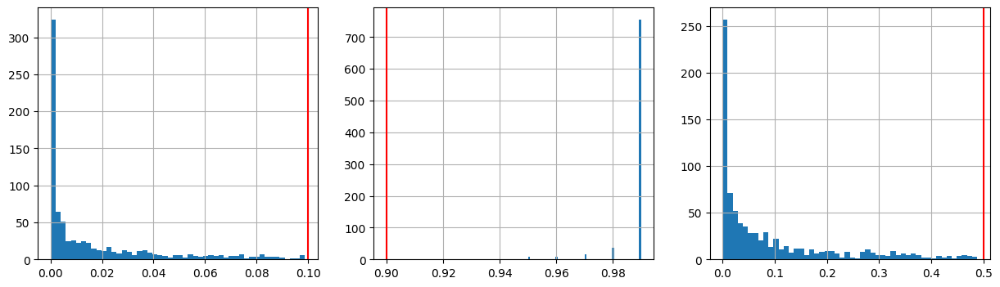

In [19]:
fig, ax = plt.subplots(1,3, figsize=(15,4))
session.units['amplitude_cutoff'].hist(ax=ax[0], bins=50)
ax[0].axvline(0.1, color='r')
session.units['presence_ratio'].hist(ax=ax[1], bins=50)
ax[1].axvline(0.9, color='r')
session.units['isi_violations'].hist(ax=ax[2], bins=50)
ax[2].axvline(0.5, color='r')

In [20]:
session.units

,waveform_PT_ratio,waveform_amplitude,amplitude_cutoff,cluster_id,cumulative_drift,d_prime,firing_rate,isi_violations,isolation_distance,L_ratio,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
951088679,0.620607,82.147455,0.023654,1,480.97,2.575648,7.429131,0.053350,51.364291,0.028062,...,215.0,APN,8328.0,3018.0,7095.0,probeA,See electrode locations,29999.965974,1249.998582,True
951088664,0.587044,78.399165,0.001739,0,427.07,3.085334,6.843864,0.033732,40.358293,0.051513,...,215.0,APN,8328.0,3018.0,7095.0,probeA,See electrode locations,29999.965974,1249.998582,True
951088734,0.560996,187.504005,0.001249,5,311.01,5.152564,1.418476,0.356931,56.950961,0.001292,...,215.0,APN,8316.0,2988.0,7099.0,probeA,See electrode locations,29999.965974,1249.998582,True
951088721,0.474457,196.741545,0.000059,4,355.17,4.295014,11.517381,0.000271,58.358552,0.020218,...,215.0,APN,8316.0,2988.0,7099.0,probeA,See electrode locations,29999.965974,1249.998582,True
951088862,0.534674,92.125020,0.089901,16,239.50,4.043348,19.953126,0.013619,79.934237,0.011335,...,215.0,APN,8304.0,2958.0,7103.0,probeA,See electrode locations,29999.965974,1249.998582,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
951117435,0.565021,100.299225,0.004762,377,135.28,5.824413,0.198506,0.000000,49.584501,0.002925,...,417.0,VISrl,7281.0,1194.0,8910.0,probeF,See electrode locations,30000.038460,1250.001602,True
951117571,0.219237,142.853685,0.001151,394,51.09,5.542278,0.241426,0.000000,65.892097,0.000296,...,417.0,VISrl,7267.0,1136.0,8953.0,probeF,See electrode locations,30000.038460,1250.001602,True
951117127,0.367834,45.597435,0.068652,335,171.02,3.295105,10.886100,0.037876,118.906935,0.007595,...,417.0,VISrl,7263.0,1121.0,8963.0,probeF,See electrode locations,30000.038460,1250.001602,True


Our main metric to classify the stimuli will be the average firing rate. We have a firing_rate data for each unit in the session we're working with, however, this column represents the overall average firing rate for each unit across the entire recording session. So it's not useful for our classification task.

Instead, we calculate stimulus-specific firing rates by following these three main steps:
1. We retrieve spike counts for specific stimulus presentations
2. We normalise by bin width to convert to firing rates (spikes/second)
3. We group responses by stimulus (across all presentations) and calculate the means

In [21]:
# here we retrieve the spike counts for each unit for each stimulus presentation
# natural scenes
scene_spikes = session.presentationwise_spike_counts(
    stimulus_presentation_ids=scene_table.index.values,
    bin_edges=np.linspace(0, 0.250219, 2),  # 0-250ms window
    unit_ids=session.units.index.values
)

# movie 1 (use frame-aligned approach)
movie1_spikes = session.presentationwise_spike_counts(
    stimulus_presentation_ids=movie1_table.index.values,
    bin_edges=np.linspace(0, 0.033361, 2),  # ~30Hz frame rate
    unit_ids=session.units.index.values
)

# movie 3
movie3_spikes = session.presentationwise_spike_counts(
    stimulus_presentation_ids=movie3_table.index.values,
    bin_edges=np.linspace(0, 0.033362, 2),  # ~30Hz frame rate
    unit_ids=session.units.index.values
)

print(f"Dimensions: {scene_spikes.dims}")
print("Natural scenes spike counts shape:", scene_spikes.shape)
print("Movie 1 spike counts shape:", movie1_spikes.shape)
print("Movie 3 spike counts shape:", movie3_spikes.shape)

print(f"Total spikes in scenes: {scene_spikes.sum().values}")
print(f"Total spikes in movie 1: {movie1_spikes.sum().values}")
print(f"Total spikes in movie 3: {movie3_spikes.sum().values}")

Dimensions: ('stimulus_presentation_id', 'time_relative_to_stimulus_onset', 'unit_id')
Natural scenes spike counts shape: (5900, 1, 825)
Movie 1 spike counts shape: (18000, 1, 825)
Movie 3 spike counts shape: (36000, 1, 825)
Total spikes in scenes: 9872034
Total spikes in movie 1: 3525469
Total spikes in movie 3: 6603113


1st dimension: number of times a stimulus of that type was presented (contains presentation ids)\
2nd dimension: number of time bins (contains number of spikes)\
3rd dimension: number of units we're recording (contains unit ids)

In [22]:
scene_spikes

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 5900,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 825)>
array([[[ 4,  4,  0, ...,  6, 11,  0]],

       [[ 1,  3,  2, ...,  2,  4,  5]],

       [[ 3, 10,  0, ...,  6,  4,  0]],

       ...,

       [[ 0,  0,  0, ...,  4,  3,  0]],

       [[ 2,  5,  0, ...,  4,  0,  0]],

       [[ 3,  4,  0, ...,  3,  1,  0]]], dtype=uint16)
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 51355 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 951088679 ... 951117155

In [23]:
movie1_spikes

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 825)>
array([[[0, 1, 0, ..., 0, 0, 0]],

       [[1, 1, 0, ..., 0, 0, 0]],

       [[0, 1, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 2, 1, 0]],

       [[1, 0, 0, ..., 1, 1, 0]],

       [[1, 2, 0, ..., 1, 0, 0]]], dtype=uint16)
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 22000 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 951088679 ... 951117155

The movies are displayed at 30 fps (30Hz), so the duration of one frame is 1/30 ≈ 0.03333 seconds, but in the movie1_table and movie3_table above the exact duration is given as 0.033361 and 0.033362 seconds, so we use that. 

The temporal difference between stimuli turns out to be a fundamental challenge, as it makes direct comparison problematic without proper normalisation. That's why we take firing rates as our main metric of comparison.

In [24]:
# here we convert spike counts to firing rates (spikes/second)
scene_rates = scene_spikes / 0.250219  # normalise by 250ms bin width
movie1_rates = movie1_spikes / 0.033361  # normalise by 33ms bin width
movie3_rates = movie3_spikes / 0.033362

print("Natural scenes firing rates shape:", scene_rates.shape)
print("Movie 1 firing rates shape:", movie1_rates.shape)
print("Movie 3 firing rates shape:", movie3_rates.shape)

Natural scenes firing rates shape: (5900, 1, 825)
Movie 1 firing rates shape: (18000, 1, 825)
Movie 3 firing rates shape: (36000, 1, 825)


As we can see, this operation preserves the original array shape but converts the values in the middle dimension from spike counts to firing rates.

In [25]:
scene_rates

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 5900,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 825)>
array([[[15.98599627, 15.98599627,  0.        , ..., 23.9789944 ,
         43.96148973,  0.        ]],

       [[ 3.99649907, 11.9894972 ,  7.99299813, ...,  7.99299813,
         15.98599627, 19.98249533]],

       [[11.9894972 , 39.96499067,  0.        , ..., 23.9789944 ,
         15.98599627,  0.        ]],

       ...,

       [[ 0.        ,  0.        ,  0.        , ..., 15.98599627,
         11.9894972 ,  0.        ]],

       [[ 7.99299813, 19.98249533,  0.        , ..., 15.98599627,
          0.        ,  0.        ]],

       [[11.9894972 , 15.98599627,  0.        , ..., 11.9894972 ,
          3.99649907,  0.        ]]])
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 51355 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 951088679 ... 951117155

In [26]:
movie1_rates

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 825)>
array([[[ 0.        , 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[29.97512065, 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        , 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       ...,

       [[ 0.        ,  0.        ,  0.        , ..., 59.9502413 ,
         29.97512065,  0.        ]],

       [[29.97512065,  0.        ,  0.        , ..., 29.97512065,
         29.97512065,  0.        ]],

       [[29.97512065, 59.9502413 ,  0.        , ..., 29.97512065,
          0.        ,  0.        ]]])
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 22000 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 951088679 ... 951117155

We create dictionaries containing for each image and each movie frame the firing rate averaged across all trials.\
Main benefits: noise reduction, consistent formatting

In [27]:
# we get mean response for a group of presentations of the same 'frame' for every stimulus
def get_mean_response(group, rates_data):
    presentation_ids = group.index.values
    return rates_data.sel(stimulus_presentation_id=presentation_ids).mean(dim='stimulus_presentation_id')

# natural scenes
scene_groups = scene_table.groupby('frame')
scene_resp_by_image = {frame_id: get_mean_response(group, scene_rates) 
                       for frame_id, group in scene_groups}

# movie 1
movie1_groups = movie1_table.groupby('frame')
movie1_resp_by_frame = {frame_id: get_mean_response(group, movie1_rates) 
                        for frame_id, group in movie1_groups}

# movie 3
movie3_groups = movie3_table.groupby('frame')
movie3_resp_by_frame = {frame_id: get_mean_response(group, movie3_rates) 
                        for frame_id, group in movie3_groups}

In [28]:
scene_resp_by_image

{0.0: <xarray.DataArray 'spike_counts' (time_relative_to_stimulus_onset: 1,
                                   unit_id: 825)>
 array([[ 7.19369832,  7.51341825,  0.63943985, 13.50816685, 17.9842458 ,
          7.19369832,  1.51866965,  3.99649907, 45.4002294 ,  4.63593892,
         39.00583089, 47.15868899, 12.94865698, 34.28996199,  7.11376834,
          3.19719925,  1.03908976,  3.11726927, 26.61668379,  6.63418845,
          9.59159776, 30.93290278, 51.47490798,  4.79579888,  7.11376834,
         24.37864431, 17.18494599, 69.53908376,  2.95740931, 37.40723127,
          9.03208789, 24.69836423, 23.33955455,  7.99299813,  0.39964991,
          9.8313877 , 15.58634636, 10.55075754,  2.47782942,  6.79404841,
         13.18844692,  2.23803948,  2.71761937,  4.15635903,  1.59859963,
          1.19894972,  0.95915978,  1.11901974,  1.43873966,  5.59509869,
          1.2788797 ,  8.31271806, 10.15110763,  7.59334823,  5.51516871,
          5.91481862,  9.67152774,  5.9947486 ,  5.51516871,

In [29]:
movie1_resp_by_frame

{0.0: <xarray.DataArray 'spike_counts' (time_relative_to_stimulus_onset: 1,
                                   unit_id: 825)>
 array([[ 8.99253619, 14.98756032,  1.49875603,  8.99253619, 16.48631636,
          2.99751206,  0.        ,  4.4962681 , 32.97263271,  7.49378016,
         38.96765684, 43.46392494, 16.48631636, 14.98756032,  1.49875603,
          1.49875603,  4.4962681 ,  1.49875603, 25.47885255,  5.99502413,
          8.99253619, 25.47885255, 37.46890081, 10.49129223, 38.96765684,
         19.48382842, 11.99004826, 43.46392494,  1.49875603, 67.44402146,
          4.4962681 , 23.98009652,  4.4962681 ,  4.4962681 ,  0.        ,
          8.99253619,  4.4962681 ,  2.99751206,  1.49875603,  2.99751206,
          5.99502413,  0.        ,  0.        ,  1.49875603,  0.        ,
          0.        ,  1.49875603,  5.99502413,  1.49875603,  1.49875603,
          0.        ,  4.4962681 ,  8.99253619,  8.99253619,  2.99751206,
          8.99253619,  4.4962681 ,  8.99253619,  4.4962681 ,

In [30]:
movie3_resp_by_frame

{0.0: <xarray.DataArray 'spike_counts' (time_relative_to_stimulus_onset: 1,
                                   unit_id: 825)>
 array([[ 5.99484443,  5.99484443,  2.99742222,  8.99226665, 20.98195552,
          5.99484443,  2.99742222,  0.        , 44.96133325,  0.        ,
         29.97422217, 44.96133325, 14.98711108, 11.98968887,  0.        ,
          2.99742222,  5.99484443,  8.99226665, 32.97164439,  0.        ,
          2.99742222, 32.97164439, 26.97679995,  2.99742222,  2.99742222,
         23.97937774,  8.99226665, 95.91751094,  5.99484443, 20.98195552,
         14.98711108,  8.99226665,  2.99742222,  8.99226665,  0.        ,
         11.98968887,  5.99484443,  2.99742222,  0.        ,  2.99742222,
         11.98968887,  0.        ,  0.        , 11.98968887,  0.        ,
          0.        ,  5.99484443,  2.99742222,  0.        ,  2.99742222,
          0.        ,  5.99484443, 20.98195552,  0.        ,  0.        ,
          5.99484443,  8.99226665,  8.99226665,  2.99742222,

## Investigate the data (session 766640955) 

In the session 76640955 is shown 60 times with the frames in natural order and 20 times with the frames shuffled.

In [31]:
print(session1.stimulus_names)

['spontaneous', 'gabors', 'flashes', 'drifting_gratings_contrast', 'natural_movie_one_more_repeats', 'natural_movie_one_shuffled', 'drifting_gratings_75_repeats', 'dot_motion']


In [32]:
movie1rep_table = session1.get_stimulus_table('natural_movie_one_more_repeats')
movie1shu_table = session1.get_stimulus_table('natural_movie_one_shuffled')

print("Movie 1 with repetitions frames:", movie1rep_table['frame'].nunique())
print("Movie 1 shuffled frames:", movie1shu_table['frame'].nunique())

Movie 1 with repetitions frames: 900
Movie 1 shuffled frames: 900


In [33]:
movie1rep_table

,stimulus_block,start_time,stop_time,contrast,stimulus_name,size,orientation,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
4339,3.0,2297.212884,2297.246246,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,0.0,0.033361,282
4340,3.0,2297.246246,2297.279607,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,1.0,0.033361,283
4341,3.0,2297.279607,2297.312968,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,2.0,0.033361,284
4342,3.0,2297.312968,2297.346330,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,3.0,0.033361,285
4343,3.0,2297.346330,2297.379691,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,4.0,0.033361,286
...,...,...,...,...,...,...,...,...,...,...
76936,8.0,8302.063780,8302.097141,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,895.0,0.033361,1177
76937,8.0,8302.097141,8302.130501,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,896.0,0.033361,1178
76938,8.0,8302.130501,8302.163862,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,897.0,0.033361,1179


In [34]:
movie1shu_table

,stimulus_block,start_time,stop_time,contrast,stimulus_name,size,orientation,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
31339,4.0,3197.965544,3197.998907,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,0.0,0.033362,1182
31340,4.0,3197.998907,3198.032269,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,1.0,0.033362,1183
31341,4.0,3198.032269,3198.065631,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,2.0,0.033362,1184
31342,4.0,3198.065631,3198.098994,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,3.0,0.033362,1185
31343,4.0,3198.098994,3198.132356,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,4.0,0.033362,1186
...,...,...,...,...,...,...,...,...,...,...
49936,7.0,7401.311110,7401.344471,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,895.0,0.033361,2077
49937,7.0,7401.344471,7401.377831,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,896.0,0.033361,2078
49938,7.0,7401.377831,7401.411192,1.0,natural_movie_one_shuffled,"[1920.0, 1080.0]",0.0,897.0,0.033361,2079


As expected the frames and their duration are the same for both movies. We have more rows for the natural movie because it get repeated more times. For our analysis we will take into consideration only the first 20 repetitions, in order to be coherent with using the shuffled movie.

In [35]:
movie1crop_table = movie1rep_table.iloc[:18000]
movie1crop_table

,stimulus_block,start_time,stop_time,contrast,stimulus_name,size,orientation,frame,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,
4339,3.0,2297.212884,2297.246246,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,0.0,0.033361,282
4340,3.0,2297.246246,2297.279607,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,1.0,0.033361,283
4341,3.0,2297.279607,2297.312968,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,2.0,0.033361,284
4342,3.0,2297.312968,2297.346330,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,3.0,0.033361,285
4343,3.0,2297.346330,2297.379691,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,4.0,0.033361,286
...,...,...,...,...,...,...,...,...,...,...
22334,3.0,2897.547885,2897.581247,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,895.0,0.033362,1177
22335,3.0,2897.581247,2897.614608,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,896.0,0.033362,1178
22336,3.0,2897.614608,2897.647970,1.0,natural_movie_one_more_repeats,"[1920.0, 1080.0]",0.0,897.0,0.033362,1179


In [36]:
good_units1 = session1.units[
    (session1.units.amplitude_cutoff < 0.1) &
    (session1.units.presence_ratio > 0.9) &
    (session1.units.isi_violations < 0.5)
]
print("Good units:", len(good_units1))

Good units: 842


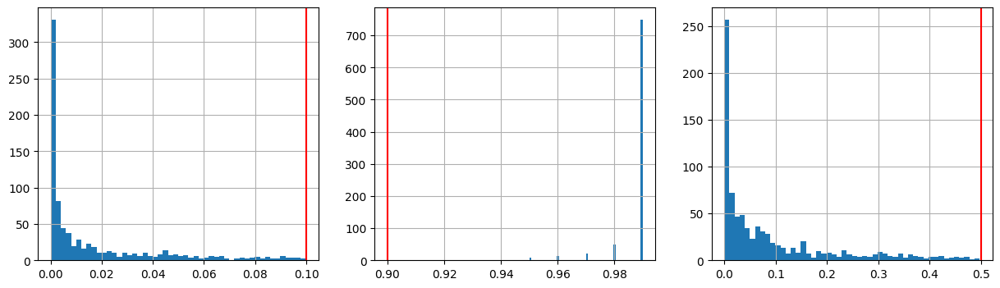

In [37]:
fig, ax = plt.subplots(1,3, figsize=(15,4))
session1.units['amplitude_cutoff'].hist(ax=ax[0], bins=50)
ax[0].axvline(0.1, color='r')
session1.units['presence_ratio'].hist(ax=ax[1], bins=50)
ax[1].axvline(0.9, color='r')
session1.units['isi_violations'].hist(ax=ax[2], bins=50)
ax[2].axvline(0.5, color='r')

In [38]:
session1.units

,waveform_PT_ratio,waveform_amplitude,amplitude_cutoff,cluster_id,cumulative_drift,d_prime,firing_rate,isi_violations,isolation_distance,L_ratio,...,ecephys_structure_id,ecephys_structure_acronym,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,probe_description,location,probe_sampling_rate,probe_lfp_sampling_rate,probe_has_lfp_data
unit_id,,,,,,,,,,,,,,,,,,,,,
950911624,0.451580,156.94965,0.000344,2,127.43,5.128493,8.905862,0.026995,105.642029,0.000127,...,313.0,MB,8121.0,3321.0,6562.0,probeA,See electrode locations,29999.968499,1249.998687,True
950911641,0.794832,144.38775,0.000609,3,318.83,5.588427,9.531874,0.000842,111.293247,0.000238,...,313.0,MB,8119.0,3312.0,6563.0,probeA,See electrode locations,29999.968499,1249.998687,True
950911686,0.263552,132.55983,0.045403,6,271.37,3.977572,19.019987,0.006341,103.608231,0.003470,...,313.0,MB,8111.0,3287.0,6567.0,probeA,See electrode locations,29999.968499,1249.998687,True
950911657,0.340280,108.66375,0.042647,4,185.38,4.761646,7.271007,0.020972,91.041858,0.000744,...,313.0,MB,8114.0,3295.0,6565.0,probeA,See electrode locations,29999.968499,1249.998687,True
950911696,0.590669,186.91374,0.002805,7,216.73,5.187974,8.191716,0.015953,68.792457,0.001647,...,313.0,MB,8103.0,3262.0,6570.0,probeA,See electrode locations,29999.968499,1249.998687,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
950950813,0.688431,72.42261,0.036799,322,121.29,2.706410,12.917462,0.005957,71.787925,0.008826,...,417.0,VISrl,7534.0,1205.0,8638.0,probeF,See electrode locations,30000.038718,1250.001613,True
950950915,0.445917,118.49019,0.024431,330,354.80,3.501528,1.005986,0.075559,55.744525,0.002247,...,417.0,VISrl,7530.0,1182.0,8656.0,probeF,See electrode locations,30000.038718,1250.001613,True
950950901,0.849860,91.92378,0.038033,329,220.91,4.218596,4.567127,0.454576,58.451624,0.012946,...,417.0,VISrl,7531.0,1190.0,8650.0,probeF,See electrode locations,30000.038718,1250.001613,True


We repeat the same steps we followed for the other session.

In [39]:
# here we retrieve the spike counts for each unit for each stimulus presentation

# movie 1 
movie1rep_spikes = session1.presentationwise_spike_counts(
    stimulus_presentation_ids=movie1crop_table.index.values,
    bin_edges=np.linspace(0, 0.033361, 2),  # ~30Hz frame rate
    unit_ids=session1.units.index.values
)

# movie 3
movie1shu_spikes = session1.presentationwise_spike_counts(
    stimulus_presentation_ids=movie1shu_table.index.values,
    bin_edges=np.linspace(0, 0.033362, 2),  # ~30Hz frame rate
    unit_ids=session1.units.index.values
)

print(f"Dimensions: {movie1rep_spikes.dims}")
print("Movie 1 spike counts shape:", movie1rep_spikes.shape)
print("Movie 1 shuffled spike counts shape:", movie1shu_spikes.shape)

print(f"Total spikes in movie 1: {movie1rep_spikes.sum().values}")
print(f"Total spikes in movie 1 shuffled: {movie1shu_spikes.sum().values}")

Dimensions: ('stimulus_presentation_id', 'time_relative_to_stimulus_onset', 'unit_id')
Movie 1 spike counts shape: (18000, 1, 842)
Movie 1 shuffled spike counts shape: (18000, 1, 842)
Total spikes in movie 1: 3936098
Total spikes in movie 1 shuffled: 4284508


It seems like the number spikes when the movie is shown with shuffled frames is higher.

In [40]:
movie1rep_spikes

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 842)>
array([[[1, 1, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 2, 1]],

       [[1, 0, 0, ..., 0, 0, 2]],

       ...,

       [[0, 1, 0, ..., 0, 0, 0]],

       [[0, 1, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0]]], dtype=uint16)
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 4339 .....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 950911624 ... 950950976

In [41]:
movie1shu_spikes

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 842)>
array([[[0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 1, 2]],

       ...,

       [[0, 0, 2, ..., 0, 0, 0]],

       [[0, 1, 2, ..., 0, 1, 0]],

       [[0, 1, 0, ..., 0, 0, 0]]], dtype=uint16)
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 31339 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 950911624 ... 950950976

we continue by computing the firing rate

In [42]:
movie1rep_rates = movie1rep_spikes / 0.033361  # normalise by 33ms bin width
movie1shu_rates = movie1shu_spikes / 0.033361

print("Movie 1 firing rates shape:", movie1rep_rates.shape)
print("Movie 1 shuffled firing rates shape:", movie1shu_rates.shape)

Movie 1 firing rates shape: (18000, 1, 842)
Movie 1 shuffled firing rates shape: (18000, 1, 842)


In [43]:
movie1rep_rates

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 842)>
array([[[29.97512065, 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         59.9502413 , 29.97512065]],

       [[29.97512065,  0.        ,  0.        , ...,  0.        ,
          0.        , 59.9502413 ]],

       ...,

       [[ 0.        , 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        , 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        ,  0.        ,  0.        , ...,  0.        ,
          0.        ,  0.        ]]])
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 4339 .....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 950911624 ... 950950976

In [44]:
movie1shu_rates

<xarray.DataArray 'spike_counts' (stimulus_presentation_id: 18000,
                                  time_relative_to_stimulus_onset: 1,
                                  unit_id: 842)>
array([[[ 0.        ,  0.        ,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        ,  0.        ,  0.        , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         29.97512065, 59.9502413 ]],

       ...,

       [[ 0.        ,  0.        , 59.9502413 , ...,  0.        ,
          0.        ,  0.        ]],

       [[ 0.        , 29.97512065, 59.9502413 , ...,  0.        ,
         29.97512065,  0.        ]],

       [[ 0.        , 29.97512065,  0.        , ...,  0.        ,
          0.        ,  0.        ]]])
Coordinates:
  * stimulus_presentation_id         (stimulus_presentation_id) int64 31339 ....
  * time_relative_to_stimulus_onset  (time_relative_to_stimulus_onset) float64 ...
  * unit_id                          (unit_id) int64 950911624 ... 950950976

In [45]:
# we get mean response for a group of presentations of the same 'frame' for every stimulus
def get_mean_response(group, rates_data):
    presentation_ids = group.index.values
    return rates_data.sel(stimulus_presentation_id=presentation_ids).mean(dim='stimulus_presentation_id')

# movie 1
movie1rep_groups = movie1crop_table.groupby('frame')
movie1rep_resp_by_frame = {frame_id: get_mean_response(group, movie1rep_rates) 
                        for frame_id, group in movie1rep_groups}

# movie 1 shuffled
movie1shu_groups = movie1shu_table.groupby('frame')
movie1shu_resp_by_frame = {frame_id: get_mean_response(group, movie1shu_rates) 
                        for frame_id, group in movie1shu_groups}

In [46]:
movie1rep_resp_by_frame

{0.0: <xarray.DataArray 'spike_counts' (time_relative_to_stimulus_onset: 1,
                                   unit_id: 842)>
 array([[  7.49378016,   7.49378016,   0.        ,   7.49378016,
          10.49129223,  52.45646114,  10.49129223,  11.99004826,
           0.        ,  14.98756032,  14.98756032,  13.48880429,
          26.97760858,  29.97512065,   2.99751206,  31.47387668,
          14.98756032,   4.4962681 ,   7.49378016,  52.45646114,
           0.        ,  13.48880429,   0.        ,  26.97760858,
           7.49378016,   2.99751206,  11.99004826,   8.99253619,
           1.49875603,   7.49378016,  47.96019304,  55.4539732 ,
          22.48134049,   1.49875603,  44.96268097,  49.45894907,
          65.94526543,   7.49378016,  14.98756032,   0.        ,
          13.48880429,  77.93531369,  37.46890081,  73.43904559,
          32.97263271,   2.99751206,   4.4962681 ,   7.49378016,
           4.4962681 ,  10.49129223,  10.49129223,   8.99253619,
           4.4962681 ,   4.49

In [47]:
movie1shu_resp_by_frame

{0.0: <xarray.DataArray 'spike_counts' (time_relative_to_stimulus_onset: 1,
                                   unit_id: 842)>
 array([[ 11.99004826,  11.99004826,  22.48134049,   4.4962681 ,
           0.        ,  11.99004826,   2.99751206,  31.47387668,
           0.        ,  10.49129223,  17.98507239,   0.        ,
          31.47387668,  20.98258445,  11.99004826,  29.97512065,
          25.47885255,   4.4962681 ,   2.99751206,  44.96268097,
           1.49875603,   5.99502413,   2.99751206,  16.48631636,
           2.99751206,   1.49875603,  17.98507239,   2.99751206,
           2.99751206,   0.        ,  10.49129223,  46.46143701,
          40.46641288,   0.        ,  53.95521717,  53.95521717,
          25.47885255,   1.49875603,  11.99004826,   0.        ,
           2.99751206,  80.93282575,  59.9502413 ,  47.96019304,
          10.49129223,   5.99502413,  11.99004826,   2.99751206,
           5.99502413,   1.49875603,   8.99253619,   0.        ,
          10.49129223,   5.99

## Comparison of the data

Since movie 1 and movie 3 differ both in their characteristics and their presentation, we want to compare them.

In [48]:
print(f"Movie 1: {movie1_table['frame'].nunique()} unique frames, {len(movie1_table)/movie1_table['frame'].nunique()} repetitions")
print(f"Movie 3: {movie3_table['frame'].nunique()} unique frames, {len(movie3_table)/movie3_table['frame'].nunique()} repetitions")

# duration of each movie
movie1_duration = movie1_table['stop_time'].max() - movie1_table['start_time'].min()
movie3_duration = movie3_table['stop_time'].max() - movie3_table['start_time'].min()

print(f"Movie 1 total duration: {movie1_duration:.1f} seconds")
print(f"Movie 3 total duration: {movie3_duration:.1f} seconds")

# check frame rates
movie1_frame_rate = movie1_table['frame'].nunique() / (movie1_duration / (len(movie1_table)/movie1_table['frame'].nunique()))
movie3_frame_rate = movie3_table['frame'].nunique() / (movie3_duration / (len(movie3_table)/movie3_table['frame'].nunique()))
# the frame rate is the number of unique frames divided by the duration of the movie in seconds
# the duration of the movie in seconds is the total duration divided by the number of repetitions
# the number of repetitions is the total number of stimulus presentations divided by the number of unique frames

print(f"Movie 1 frame rate: {movie1_frame_rate:.1f} Hz")
print(f"Movie 3 frame rate: {movie3_frame_rate:.1f} Hz")

Movie 1: 900 unique frames, 20.0 repetitions
Movie 3: 3600 unique frames, 10.0 repetitions
Movie 1 total duration: 5164.3 seconds
Movie 3 total duration: 2462.1 seconds
Movie 1 frame rate: 3.5 Hz
Movie 3 frame rate: 14.6 Hz


Why doesn't the frame rate match the one in the documentation (30 Hz)?\
Our code above divided total unique frames / total duration, which assumes continuous playback with no gaps. However, the Allen Brain Observatory data includes inter-repeat intervals (gaps between movie repeats) and other experimental design elements that inflate the total duration.

For Natural Movie 1:\
30-second clip × 20 repeats = 600 seconds of actual movie content -- compared to the 5164.3 seconds calculated above.\
So 4564.3 seconds are gaps between repeats.

For Natural Movie 3:\
120-second clip × 10 repeats = 1200 seconds of actual movie -- compared to 2462.1 seconds above.\
So 1262 seconds of gaps.

In our further analysis we rely on the documentation and use the given frame rate of 30 Hz, this was just to shed some light on experimental protocols.

Now we pass to compare actual neural data, starting with firing rate distribution. 

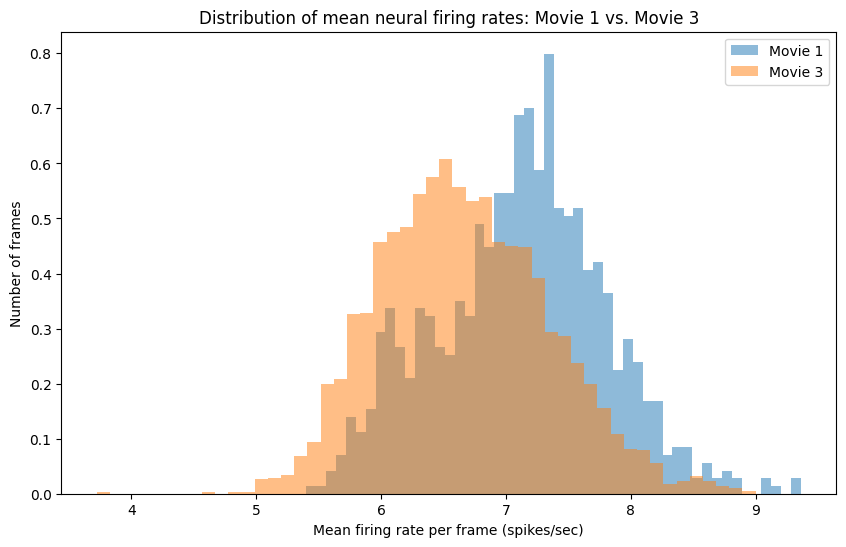

In [49]:
# average responses (across all units) for each frame
movie1_frame_rates = np.array([resp.values.flatten().mean() for resp in movie1_resp_by_frame.values()])
movie3_frame_rates = np.array([resp.values.flatten().mean() for resp in movie3_resp_by_frame.values()])

plt.figure(figsize=(10, 6))
plt.hist(movie1_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 1')
plt.hist(movie3_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 3')
plt.xlabel('Mean firing rate per frame (spikes/sec)')
plt.ylabel('Number of frames')
plt.title('Distribution of mean neural firing rates: Movie 1 vs. Movie 3')
plt.legend()
plt.show()

(these histograms are normalised)\
Movie 3 (orange) has an approximately normal distribution centered around 6.5 spikes/second.\
Movie 1 (blue) shows a more irregular distribution.\
This difference suggests that neural responses are more consistent/predictable for Movie 3, while Movie 1 may contain more varied visual content that drives neurons to different firing rate regimes. But neither of the two distributions are really that regular.

The different firing rate distributions suggest that visual content characteristics affect neural coding in ways that might be even more pronounced between static and dynamic stimuli.

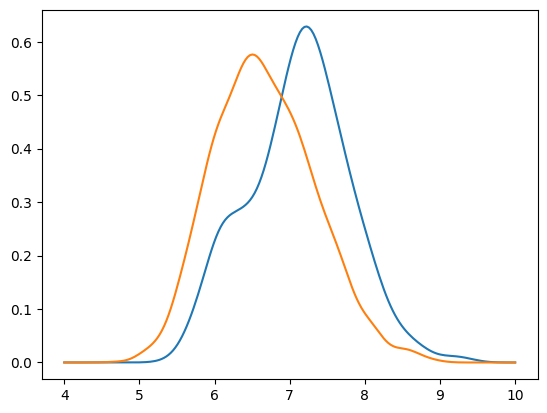

In [50]:
# using kernel density estimation instead of histogram
movie1_density = gaussian_kde(movie1_frame_rates)
movie3_density = gaussian_kde(movie3_frame_rates)
x = np.linspace(4, 10, 200)
plt.plot(x, movie1_density(x), label='Movie 1')
plt.plot(x, movie3_density(x), label='Movie 3')

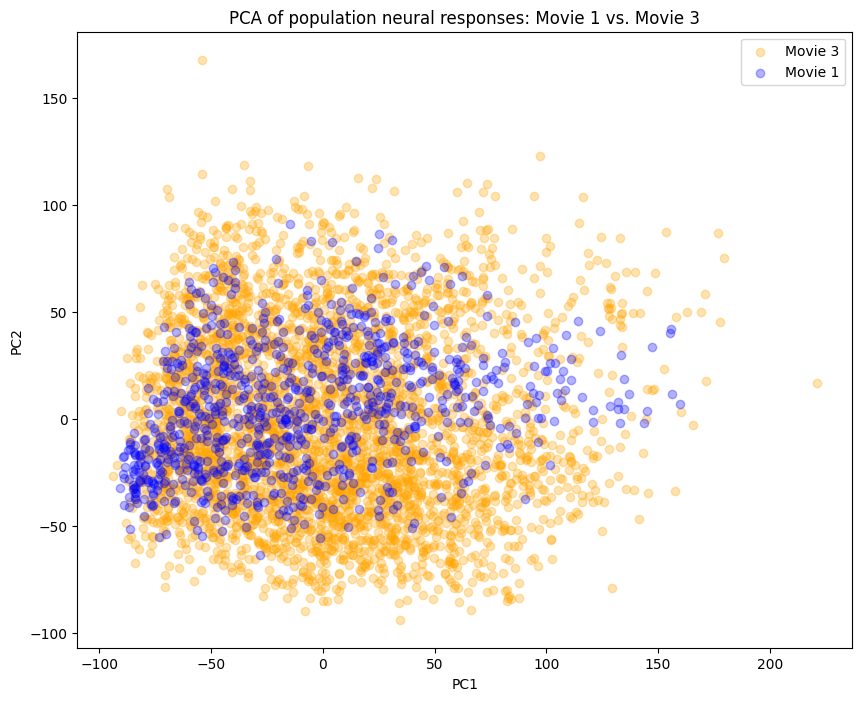

In [51]:
# feature matrices
X_movie1 = np.array([resp.values.flatten() for resp in movie1_resp_by_frame.values()])
# we have a list of arrays, each array is the response of a unit to a frame
# we convert the list of arrays to a 2D array (number of frames x number of units)
X_movie3 = np.array([resp.values.flatten() for resp in movie3_resp_by_frame.values()])

X = np.vstack([X_movie1, X_movie3])
y = np.array([1]*len(X_movie1) + [3]*len(X_movie3))  # 1 = movie 1, 3 = movie 3

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(10, 8))
plt.scatter(X_pca[y==3, 0], X_pca[y==3, 1], alpha=0.3, label='Movie 3', color='orange')
plt.scatter(X_pca[y==1, 0], X_pca[y==1, 1], alpha=0.3, label='Movie 1', color='blue')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA of population neural responses: Movie 1 vs. Movie 3')
plt.legend()
plt.show()

Both movies occupy largely overlapping regions in the 2D principal component space.\
Movie 3 (orange) shows greater spread/variability and more outliers.\
Movie 1 (blue) appears more clustered, particularly toward the left side of the plot.\
The substantial overlap suggests that at the population level, neural responses to both movies engage similar firing patterns.

Our goal is to group both movies together (vs. static images), so the partial overlap in the PCA visualisation is beneficial for our task, because it shows that Movie 1 and Movie 3 neural responses share common patterns. They also have distinctive characteristics. Our classifier should be able to learn the common "movie" patterns while ignoring movie-specific differences. Hopefully the neural responses of static natural scenes show significant differences from those of both movies.

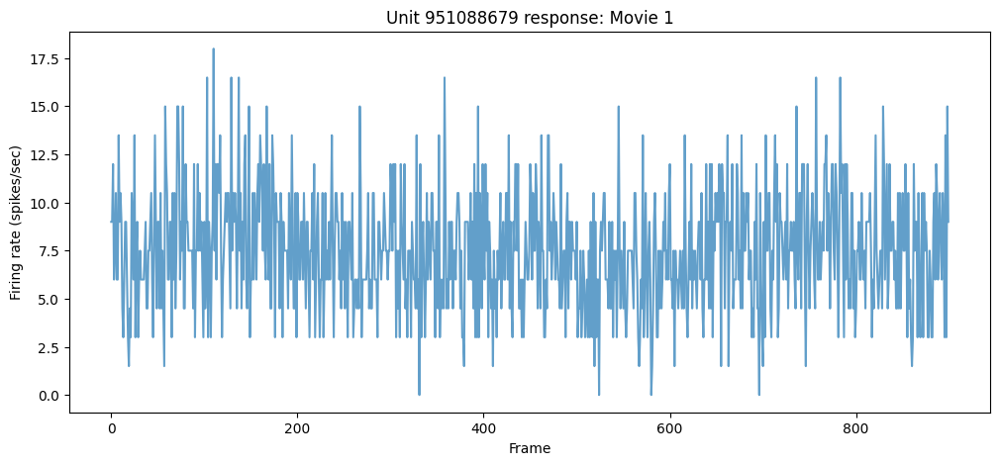

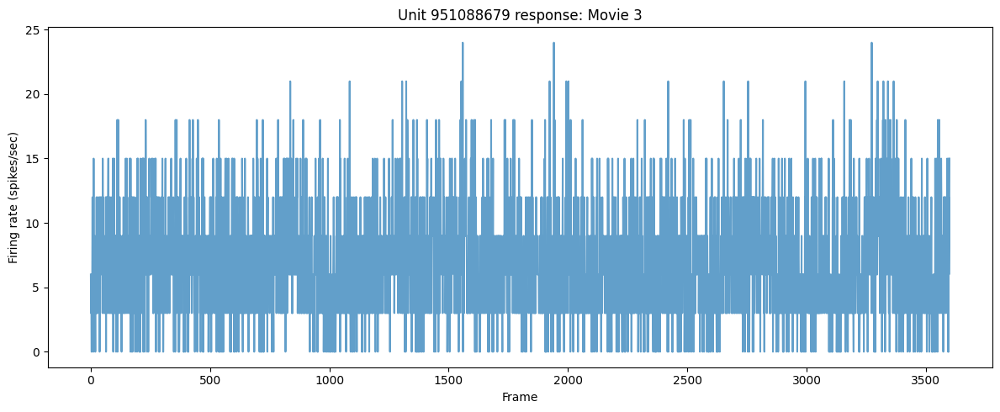

In [52]:
# take a sample unit and plot its mean response to each frame in both movies
unit_id = session.units.index[0]
movie1_unit = np.array([resp.sel(unit_id=unit_id).values.item() for resp in movie1_resp_by_frame.values()])
movie3_unit = np.array([resp.sel(unit_id=unit_id).values.item() for resp in movie3_resp_by_frame.values()])

plt.figure(figsize=(12, 5))
plt.plot(movie1_unit, alpha=0.7)
plt.title(f'Unit {unit_id} response: Movie 1')
plt.xlabel('Frame')
plt.ylabel('Firing rate (spikes/sec)')
plt.show()

plt.figure(figsize=(12, 5))
plt.plot(movie3_unit, alpha=0.7)
plt.title(f'Unit {unit_id} response: Movie 3')
plt.xlabel('Frame')
plt.ylabel('Firing rate (spikes/sec)')
plt.tight_layout()
plt.show()

The same neuron (unit 951088679) responds differently to the two movies.\
For Movie 3, the firing rates appear distributed in a larger interval (y-axis extends to 25 spikes/sec vs 17.5 for Movie 1).

The individual unit response shows clear temporal structure that differs between movies - this temporal dimension will likely be a key feature for distinguishing static vs. dynamic stimuli. These results suggest that including both firing rate statistics and temporal pattern features will be important for building an effective classifier.\
Incorporating temporal dynamics would likely improve our classifier's performance, because static images have no inherent temporal structure, while movies show rich temporal dynamics.

However, before incorporating temporal dynamics in our model, we will try to see how a simpler one considering only firing rates would perform. And to have an idea of that, we first make a comparison analysis similar to the one above incorporating also the natural scenes.

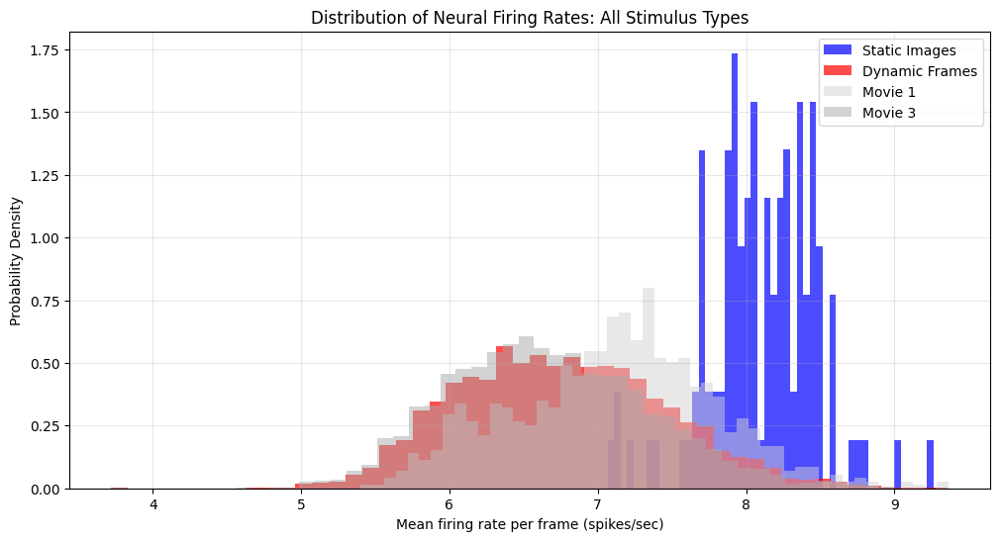

In [53]:
# mean firing rates for each image and movie frame
scene_frame_rates = np.array([resp.values.flatten().mean() for resp in scene_resp_by_image.values()])
movie1_frame_rates = np.array([resp.values.flatten().mean() for resp in movie1_resp_by_frame.values()])
movie3_frame_rates = np.array([resp.values.flatten().mean() for resp in movie3_resp_by_frame.values()])

# combine movie frame rates for dynamic stimuli comparison
movie_frame_rates = np.concatenate([movie1_frame_rates, movie3_frame_rates])

plt.figure(figsize=(12, 6))
plt.hist(scene_frame_rates, bins=50, alpha=0.7, density=True, label='Static Images', color='blue')
plt.hist(movie_frame_rates, bins=50, alpha=0.7, density=True, label='Dynamic Frames', color='red')
plt.hist(movie1_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 1', color='lightgray')
plt.hist(movie3_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 3', color='darkgray')
plt.xlabel('Mean firing rate per frame (spikes/sec)')
plt.ylabel('Probability Density')
plt.title('Distribution of Neural Firing Rates: All Stimulus Types')
plt.legend()
plt.grid(alpha=0.3)
plt.show()

The histogram clearly shows distinct neural response patterns between stimulus types.\
Static images (blue) produce consistently higher firing rates, with a peak around 8 spikes/second. This distribution is narrower and shifted rightward, indicating that neurons respond more strongly and consistently to static images.\
Dynamic frames (red) elicit lower overall firing rates, centered around 6.5 spikes/second, with a broader, more Gaussian-shaped distribution. This suggests more variable neural responses to dynamic stimuli.\
As for movie 1 vs movie 3 (light and dark gray), they show similar distributions to each other, confirming they can be appropriately grouped as "dynamic stimuli" despite being from different film segments.

Where could this difference come from?
- Movies represent a continuous stimulation for neurons, so they tend to adapt and reduce their firing rates (also making them smoother in distribution) compared to the responses triggered by suddenly appearing static images.
- The static natural scenes are also independent from each other, while each coming movie frame is processed in the context of the preceding frames.
- Because of this continuity given by movie frames the visual cortex might require less neural activity to process the next frame, as it's more "predictable", while because the images are mixed and independent, the surprise effect is bigger there. 

This suggest that while here we can separate movies from natural scenes relatively easily, it might be that in a more action-packed movie scene, or one where the frames change suddenly and a lot, the differences between static and dynamic stimuli diminish. This is a limitation of our study that we need to take into consideration, but cannot address directly now, as the data is limited in this sense. We would need to do more experiments directly on mice.

However, in the scope of our study, seeing these differences is promising for our goal of building a classifier that can distinguish between static and dynamic stimuli based on neural activity.

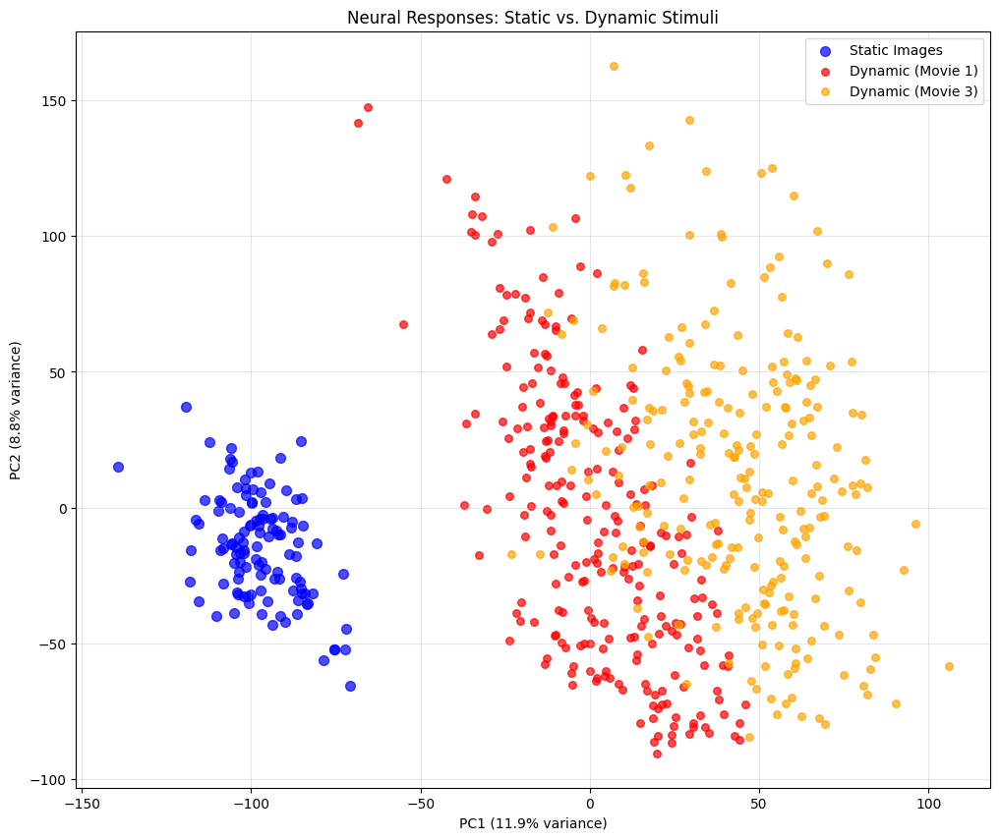

Static: 118
Movie 1: 250
Movie 3: 250


In [54]:
# frame responses into feature matrices
X_scenes = np.array([resp.values.flatten() for resp in scene_resp_by_image.values()])
X_movie1 = np.array([resp.values.flatten() for resp in movie1_resp_by_frame.values()])
X_movie3 = np.array([resp.values.flatten() for resp in movie3_resp_by_frame.values()])

# we sample frames to balance dataset sizes
max_samples = min(1000, len(X_movie1) + len(X_movie3))
scene_samples = min(max_samples // 2, len(X_scenes)) # 500 for static images (but in reality 118)
movie1_samples = min(max_samples // 4, len(X_movie1)) # 250 for each movie
movie3_samples = min(max_samples // 4, len(X_movie3))

if len(X_scenes) > scene_samples:
    scene_idx = np.random.choice(len(X_scenes), scene_samples, replace=False)
    X_scenes_sampled = X_scenes[scene_idx]
else:
    X_scenes_sampled = X_scenes

if len(X_movie1) > movie1_samples:
    movie1_idx = np.random.choice(len(X_movie1), movie1_samples, replace=False) # sampling w/o replacement, of course
    X_movie1_sampled = X_movie1[movie1_idx]
else:
    X_movie1_sampled = X_movie1

if len(X_movie3) > movie3_samples:
    movie3_idx = np.random.choice(len(X_movie3), movie3_samples, replace=False)
    X_movie3_sampled = X_movie3[movie3_idx]
else:
    X_movie3_sampled = X_movie3

# combine all data for PCA
X_combined = np.vstack([X_scenes_sampled, X_movie1_sampled, X_movie3_sampled])
# vstack stacks arrays in sequence vertically (row-wise), here we stack by the frame responses
stimulus_type = np.array(['Static'] * len(X_scenes_sampled) + 
                         ['Movie 1'] * len(X_movie1_sampled) + 
                         ['Movie 3'] * len(X_movie3_sampled))

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_combined)

plt.figure(figsize=(12, 10))
plt.scatter(X_pca[stimulus_type=='Static', 0], X_pca[stimulus_type=='Static', 1], 
            color='blue', alpha=0.7, s=50, label='Static Images')
plt.scatter(X_pca[stimulus_type=='Movie 1', 0], X_pca[stimulus_type=='Movie 1', 1], 
            color='red', alpha=0.7, s=30, label='Dynamic (Movie 1)')
plt.scatter(X_pca[stimulus_type=='Movie 3', 0], X_pca[stimulus_type=='Movie 3', 1], 
            color='orange', alpha=0.7, s=30, label='Dynamic (Movie 3)')

plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.1%} variance)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.1%} variance)')
plt.title('Neural Responses: Static vs. Dynamic Stimuli')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

print("Static:", len(X_scenes_sampled))
print("Movie 1:", len(X_movie1_sampled))
print("Movie 3:", len(X_movie3_sampled))

We are aware that the specific samples (both their distribution and number) influence a lot the value of the explained variance, but even by varying these numbers we can always see a clear separation between static and dynamic stimuli, so that's just the details. Also, by using stratified sampling, we can capture more significant explained variance by the principal components.

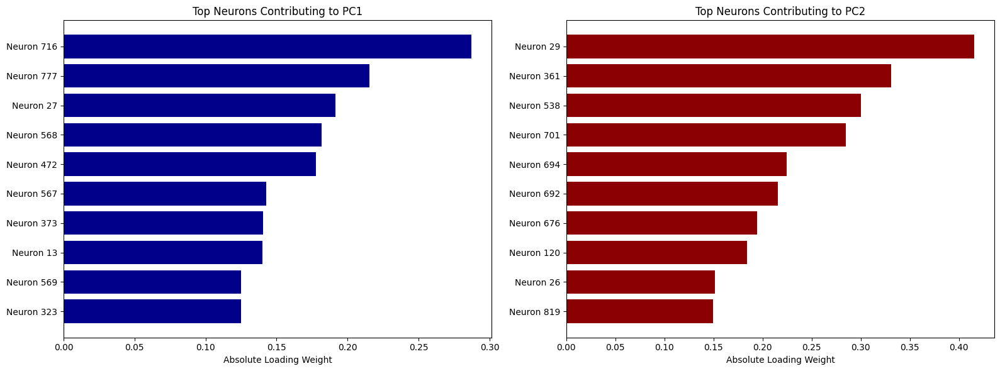

In [55]:
loadings = pca.components_

pc1_loadings = np.abs(loadings[0])
pc2_loadings = np.abs(loadings[1])

top_n = 10
top_pc1_idx = np.argsort(pc1_loadings)[-top_n:] # indices of highest weights (minus sign is for descending order)
top_pc2_idx = np.argsort(pc2_loadings)[-top_n:]

# barplots for top contributors
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

ax1.barh(range(top_n), pc1_loadings[top_pc1_idx], color='darkblue')
ax1.set_yticks(range(top_n))
ax1.set_yticklabels([f"Neuron {i}" for i in top_pc1_idx])
ax1.set_title('Top Neurons Contributing to PC1')
ax1.set_xlabel('Absolute Loading Weight')

ax2.barh(range(top_n), pc2_loadings[top_pc2_idx], color='darkred')
ax2.set_yticks(range(top_n))
ax2.set_yticklabels([f"Neuron {i}" for i in top_pc2_idx])
ax2.set_title('Top Neurons Contributing to PC2')
ax2.set_xlabel('Absolute Loading Weight')

plt.tight_layout()
plt.show()

## Machine Learning model training with average firing rate data

We now get to the part where we train our model, which is a Support Vector Machine (SVM), as that's the most appropriate for this type of data.

The goal of our SVM classifier is to learn to distinguish between static (natural scenes) and dynamic (frames from movie 1 and movie 3) stimuli based on average firing rates when the mice are presented with them. 

Our data is the following:
- static (118 samples): average firing rates for 118 unique natural scene images (averaged across 50 repetitions each)
- dynamic (4500 samples in total):
    - movie 1: average firing rates for 900 unique frames (averaged across 20 repetitions)
    - movie 3: average firing rates for 3600 unique frames (averaged across 10 repetitions)

There are a few things to consider before we start. We treat each unique stimulus (scene or frame) as a single data point, so naturally all repetitions of the same stimulus belong to the same split to avoid data leakage. 

There's also a strong imbalance between the number of data points which we will account for when setting up our model.

In [56]:
# prepare stimulus metadata
static_frames = list(scene_resp_by_image.keys())
movie1_frames = list(movie1_resp_by_frame.keys())
movie3_frames = list(movie3_resp_by_frame.keys())

# ID arrays with stimulus type markers
all_stimuli = (
    [('static', f) for f in static_frames] +
    [('movie1', f) for f in movie1_frames] +
    [('movie3', f) for f in movie3_frames]
)

# shuffle stimuli while preserving type info
np.random.shuffle(all_stimuli)

In [57]:
# extract labels for stratification (0=static, 1=dynamic)
labels = np.array([0 if s[0] == 'static' else 1 for s in all_stimuli])

# split 60-20-20 with stimulus-level isolation
train_val, test = train_test_split(all_stimuli, test_size=0.2, stratify=labels, random_state=42)
train, val = train_test_split(train_val, test_size=0.25, stratify=[l for s,l in zip(all_stimuli,labels) if s in train_val], random_state=42)

def check_leakage(split1, split2):
    """Check if any stimuli appear in both splits"""
    # we create a set of unique stimulus identifiers for each split
    # and check if there are any common identifiers
    # identifiers are created by combining stimulus type and frame ID
    set1 = set(f"{stim_type}_{frame_id}" for stim_type, frame_id in split1)
    set2 = set(f"{stim_type}_{frame_id}" for stim_type, frame_id in split2)
    return len(set1 & set2)

# verify stimulus isolation
print("=== Data Leakage Check ===")
print(f"Train-Val leakage: {check_leakage(train, val)} stimuli")
print(f"Train-Test leakage: {check_leakage(train, test)} stimuli")
print(f"Val-Test leakage: {check_leakage(val, test)} stimuli")

# verify unique stimuli counts
print("\n=== Unique Stimuli Counts ===")
print(f"Total unique stimuli: {len(all_stimuli)}")
print(f"Train stimuli: {len(train)}")
print(f"Validation stimuli: {len(val)}")
print(f"Test stimuli: {len(test)}")
print(f"Sum of splits: {len(train)+len(val)+len(test)}")

=== Data Leakage Check ===
Train-Val leakage: 0 stimuli
Train-Test leakage: 0 stimuli
Val-Test leakage: 0 stimuli

=== Unique Stimuli Counts ===
Total unique stimuli: 4618
Train stimuli: 2770
Validation stimuli: 924
Test stimuli: 924
Sum of splits: 4618


In [58]:
def get_features(stimuli_list):
    features = []
    # features are average firing rates for each frame
    for stim_type, frame_id in stimuli_list:
        if stim_type == 'static':
            features.append(scene_resp_by_image[frame_id].values.flatten())
        elif stim_type == 'movie1':
            features.append(movie1_resp_by_frame[frame_id].values.flatten())
        else:
            features.append(movie3_resp_by_frame[frame_id].values.flatten())
    return np.array(features)

X_train = get_features(train)
X_val = get_features(val)
X_test = get_features(test)

y_train = np.array([0 if s[0]=='static' else 1 for s in train])
y_val = np.array([0 if s[0]=='static' else 1 for s in val])
y_test = np.array([0 if s[0]=='static' else 1 for s in test])

print(f"Train set size: {len(X_train)}")
print(f"Validation set size: {len(X_val)}")
print(f"Test set size: {len(X_test)}")

def print_class_distribution(data, name):
    static = sum(1 for s in data if s[0] == 'static')
    dynamic = len(data) - static
    print(f"{name} set: {static} static ({static/len(data):.1%}), {dynamic} dynamic ({dynamic/len(data):.1%})")

print("\n=== Class Distribution ===")
print_class_distribution(train, "Training")
print_class_distribution(val, "Validation")
print_class_distribution(test, "Test")

print("\n=== Feature Correlation Check ===")
high_corr_features = []
for i in range(X_train.shape[1]):
    corr, _ = pointbiserialr(X_train[:,i], y_train)
    # pointbiserialr computes the correlation between a continuous variable and a binary variable
    if abs(corr) > 0.95:
        high_corr_features.append(i)

if high_corr_features:
    print(f"Warning: {len(high_corr_features)} features with >0.95 correlation to class")
else:
    print("No features with suspiciously high correlation to class")

# features with high correlation to class can lead to overfitting, 
# where the model learns to rely on these features 
# instead of generalizing to the underlying patterns in the data

Train set size: 2770
Validation set size: 924
Test set size: 924

=== Class Distribution ===
Training set: 76 static (2.7%), 2694 dynamic (97.3%)
Validation set: 18 static (1.9%), 906 dynamic (98.1%)
Test set: 24 static (2.6%), 900 dynamic (97.4%)

=== Feature Correlation Check ===
No features with suspiciously high correlation to class


In [59]:
# feature scaling
scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

In [60]:
# handling class imbalance
class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weight_dict = {0: class_weights[0], 1: class_weights[1]}

print(f"Class weights: {class_weight_dict}")

Class weights: {0: 18.223684210526315, 1: 0.514105419450631}


In [61]:
param_grid = {
    'C': [0.1, 1, 10],
    'gamma': ['scale', 'auto', 0.01],
    'kernel': ['linear', 'rbf']
}

grid_search = GridSearchCV(
    SVC(class_weight=class_weight_dict, probability=True, random_state=42),
    param_grid,
    cv=StratifiedKFold(5, shuffle=True, random_state=42), # StratifiedKFold preserves the percentage of samples for each class in each fold 
    scoring='balanced_accuracy',
    n_jobs=-1 # n_jobs=-1 means using all processors
)
grid_search.fit(X_train_scaled, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=SVC(class_weight={0: 18.223684210526315,
                                         1: 0.514105419450631},
                           probability=True, random_state=42),
             n_jobs=-1,
             param_grid={'C': [0.1, 1, 10], 'gamma': ['scale', 'auto', 0.01],
                         'kernel': ['linear', 'rbf']},
             scoring='balanced_accuracy')

Best parameters: {'C': 0.1, 'gamma': 'scale', 'kernel': 'linear'}
Validation Report:
              precision    recall  f1-score   support

      Static       1.00      1.00      1.00        18
     Dynamic       1.00      1.00      1.00       906

    accuracy                           1.00       924
   macro avg       1.00      1.00      1.00       924
weighted avg       1.00      1.00      1.00       924


Test Report:
              precision    recall  f1-score   support

      Static       1.00      1.00      1.00        24
     Dynamic       1.00      1.00      1.00       900

    accuracy                           1.00       924
   macro avg       1.00      1.00      1.00       924
weighted avg       1.00      1.00      1.00       924



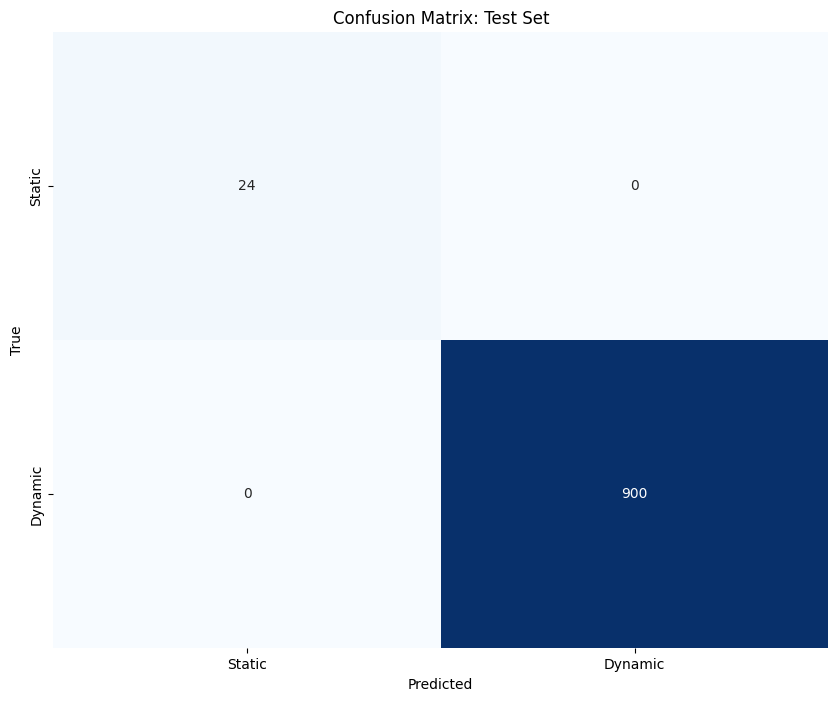

In [62]:
# evaluate the best model
print("Best parameters:", grid_search.best_params_)
best_model = grid_search.best_estimator_

print("Validation Report:")
val_pred = best_model.predict(X_val_scaled)
print(classification_report(y_val, val_pred, target_names=['Static', 'Dynamic']))

print("\nTest Report:")
test_pred = best_model.predict(X_test_scaled)
print(classification_report(y_test, test_pred, target_names=['Static', 'Dynamic']))

plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, test_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['Static', 'Dynamic'], yticklabels=['Static', 'Dynamic'])
plt.title('Confusion Matrix: Test Set')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [63]:
# save pipeline
joblib.dump({
    'train_stimuli': train,
    'val_stimuli': val,
    'test_stimuli': test,
    'scaler': scaler,
    'model': best_model
}, 'best_model.pkl')

['best_model.pkl']

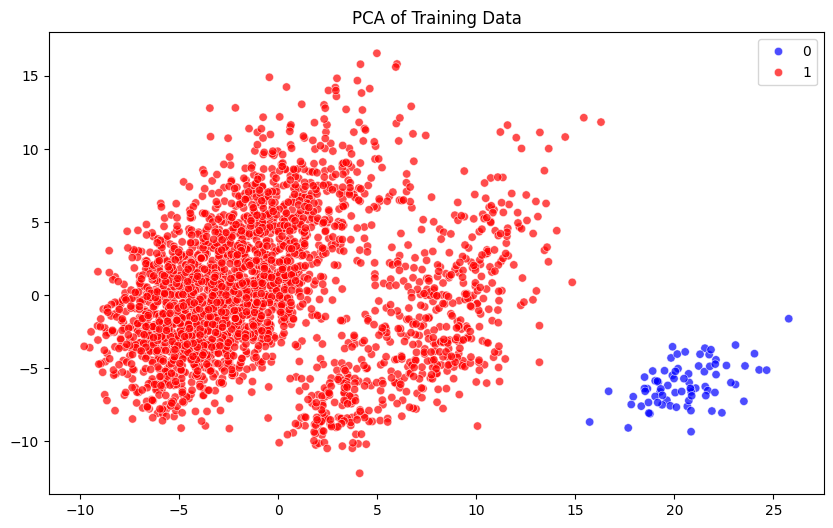

In [64]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train_scaled)

plt.figure(figsize=(10,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=y_train, 
                palette={0:'blue', 1:'red'}, alpha=0.7)
plt.title("PCA of Training Data")
plt.show()

### Biological validation of perfect accuracy

Here we use the Mann-Whitney test with a particularly strict p-value to identify the top discriminative neurons only for the stimuli we're interested in, so natural scenes, natural movie one and three. The Mann-Whitney test is suitable for independent samples (we assume independence of activity for presentation of different stimuli), which are continuously distributed, but the distribution is not normal, which is exactly our case (see plot above with distribution of average firing rates).

In [65]:
unit_ids = session.units.index.values
assert len(unit_ids) == X_train.shape[1], "Unit IDs don't match feature dimensions!"

# find discriminative neurons using original unit IDs
neuron_pvalues = []  # (unit_id, p_value) pairs
for idx, unit_id in enumerate(unit_ids):
    static_responses = X_train[y_train == 0, idx]
    dynamic_responses = X_train[y_train == 1, idx]
    
    # statistical test
    stat, p_value = mannwhitneyu(static_responses, dynamic_responses, alternative='greater')
    
    if p_value < 1e-10:  # very strict threshold
        neuron_pvalues.append((unit_id, p_value))

# sort neurons by p-value (ascending, so lower p-values indicate stronger evidence)
neuron_pvalues.sort(key=lambda x: x[1])  

# extract just the sorted unit IDs
discriminative_neurons = [unit_id for unit_id, _ in neuron_pvalues]

print(f"{len(discriminative_neurons)} neurons show p<1e-10 separation")
print("First 10 discriminative units:", discriminative_neurons[:10])
print("First 10 p-values:", [p for _, p in neuron_pvalues[:10]])

451 neurons show p<1e-10 separation
First 10 discriminative units: [951102860, 951113692, 951117571, 951103080, 951111774, 951113802, 951100200, 951095829, 951113727, 951111142]
First 10 p-values: [9.420758923680638e-254, 3.017689114482641e-215, 1.8310826527135285e-206, 3.95718636440274e-203, 1.3812114893117139e-196, 7.13979918347428e-183, 4.26893903526983e-175, 3.1428373195607417e-173, 1.2150214632775237e-168, 1.3930870952340287e-168]


The fact that 451 neurons (more than half) show p<1e-10 separation between static and dynamic stimuli (static > dynamic) is significant. It indicates a strong biological basis for our perfect classification accuracy, because it reveals that the neural encoding for static images vs dynamic movie frames is fundamentally different in the mouse brain, across different regions.

The hypothesis is that static firing rates are higher compared to dynamic ones, so we used a one-sided Mann-Whitney test, but the first 10 neurons (which we analyse below) are the same in both cases, and the only difference is in the total number of discriminative neurons, about 30 less this way compared to the two-sided test, but this is less significant in light of the total number. Further research could explore the brain areas which record a higher firing rate for dynamic stimuli.

Now we plot upon each other the firing rates for the top discriminative units for static and dynamic stimuli, to see how quickly the units respond to them in comparison. Natural scenes last 250ms, while movie frames change approximately every 33ms. So for response latency analysis a 250ms timespan with appropriate binning is suitable.

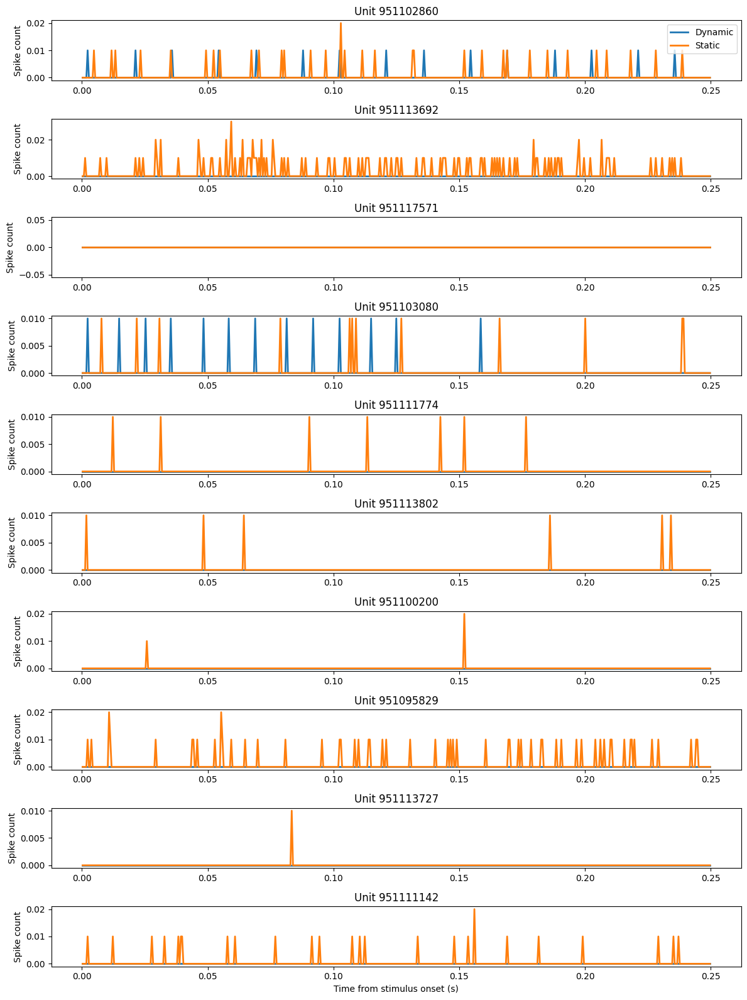

In [66]:
# Let's analyse response latencies between neurons i.e. how quickly top discriminative neurons respond after stimulus onset
detailed_time_bins = np.linspace(0, 0.25, 500)  # 500 bins of 0.5ms each

# static images (using scene_table)
static_temporal = session.presentationwise_spike_counts(
    stimulus_presentation_ids=scene_table.index[:100],
    bin_edges=detailed_time_bins,
    unit_ids=discriminative_neurons[:10]  # top 10 validated units
)

# dynamic stimuli (combine movie1 and movie3)
movie_stim_ids = np.concatenate([movie1_table.index[:50], movie3_table.index[:50]])
movie_temporal = session.presentationwise_spike_counts(
    stimulus_presentation_ids=movie_stim_ids,
    bin_edges=detailed_time_bins,
    unit_ids=discriminative_neurons[:10]
)

static_avg = static_temporal.mean(dim='stimulus_presentation_id')
movie_avg = movie_temporal.mean(dim='stimulus_presentation_id')

# bin centers for plotting (midpoints of bins, so the time points at which we measure firing rates)
bin_centers = 0.5 * (detailed_time_bins[:-1] + detailed_time_bins[1:])

# plotting temporal evolution
plt.figure(figsize=(12, 16))
for i, unit_id in enumerate(discriminative_neurons[:10]):  # first 10 units
    plt.subplot(10, 1, i+1)
    plt.plot(bin_centers, movie_avg.sel(unit_id=unit_id).values.squeeze(), 
             label='Dynamic', linewidth=2)
    plt.plot(bin_centers, static_avg.sel(unit_id=unit_id).values.squeeze(),
             label='Static', linewidth=2)
    plt.title(f'Unit {unit_id}')
    plt.ylabel('Spike count')
    if i == 0:
        plt.legend()

plt.xlabel('Time from stimulus onset (s)')
plt.tight_layout()
plt.show()

For each neuron, the orange line (static) exhibits many more spikes in this initial timeframe in almost all units compared to the blue line (dynamic). This suggests that in top discriminative neurons response is not just higher, but also quicker to static stimuli. There are some units where this is not the case, particularly Unit 951117571 here, which were included because of the low p-value, but we don't observe the difference in the beginning, it is likely to be more pronounced later. 

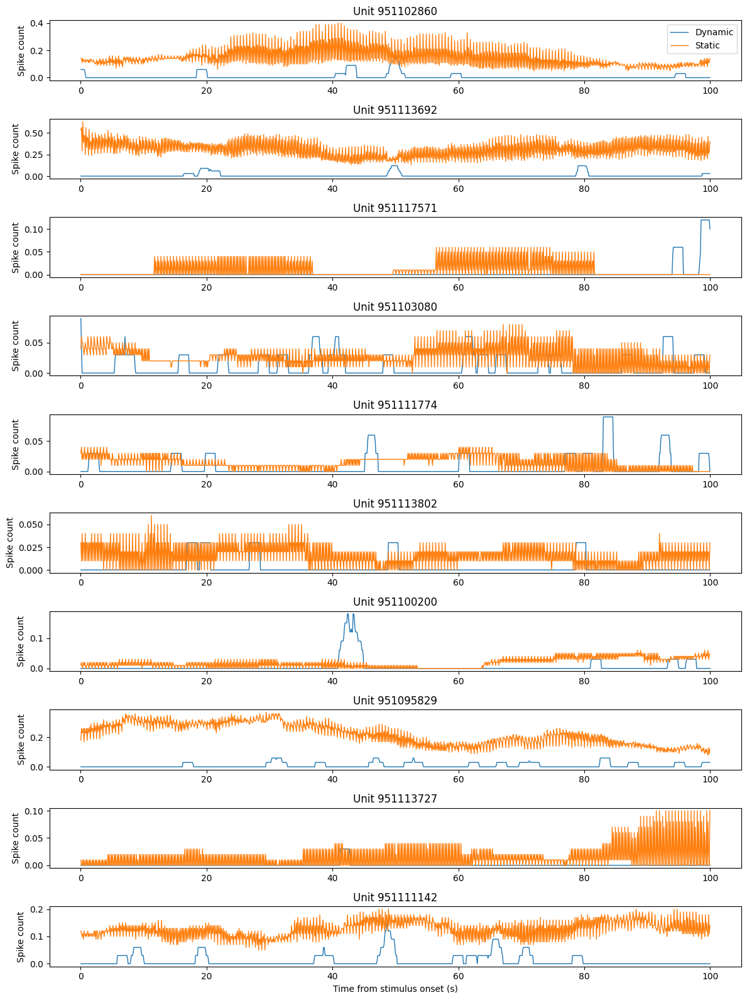

In [67]:
# Let's analyse response latencies between neurons i.e. how quickly top discriminative neurons respond after stimulus onset
detailed_time_bins = np.linspace(0, 100, 1000)  # 750 bins of 1ms each

# static images (using scene_table)
static_temporal = session.presentationwise_spike_counts(
    stimulus_presentation_ids=scene_table.index[:100],
    bin_edges=detailed_time_bins,
    unit_ids=discriminative_neurons[:10]  # top 10 validated units
)

# dynamic stimuli (combine movie1 and movie3)
movie_stim_ids = np.concatenate([movie1_table.index[:50], movie3_table.index[:50]])
movie_temporal = session.presentationwise_spike_counts(
    stimulus_presentation_ids=movie_stim_ids,
    bin_edges=detailed_time_bins,
    unit_ids=discriminative_neurons[:10]
)

static_avg = static_temporal.mean(dim='stimulus_presentation_id')
movie_avg = movie_temporal.mean(dim='stimulus_presentation_id')

# bin centers for plotting (midpoints of bins, so the time points at which we measure firing rates)
bin_centers = 0.5 * (detailed_time_bins[:-1] + detailed_time_bins[1:])

# plotting temporal evolution
plt.figure(figsize=(12, 16))
for i, unit_id in enumerate(discriminative_neurons[:10]):  # first 10 units
    plt.subplot(10, 1, i+1)
    plt.plot(bin_centers, movie_avg.sel(unit_id=unit_id).values.squeeze(), 
             label='Dynamic', linewidth=1)
    plt.plot(bin_centers, static_avg.sel(unit_id=unit_id).values.squeeze(),
             label='Static', linewidth=1)
    plt.title(f'Unit {unit_id}')
    plt.ylabel('Spike count')
    if i == 0:
        plt.legend()

plt.xlabel('Time from stimulus onset (s)')
plt.tight_layout()
plt.show()

In fact, if we take a much larger timeframe, the differences can already be seen, but the only purpose of this latter plot is to resolve the apparent paradox, we're more interested in the initial responses shown before. 

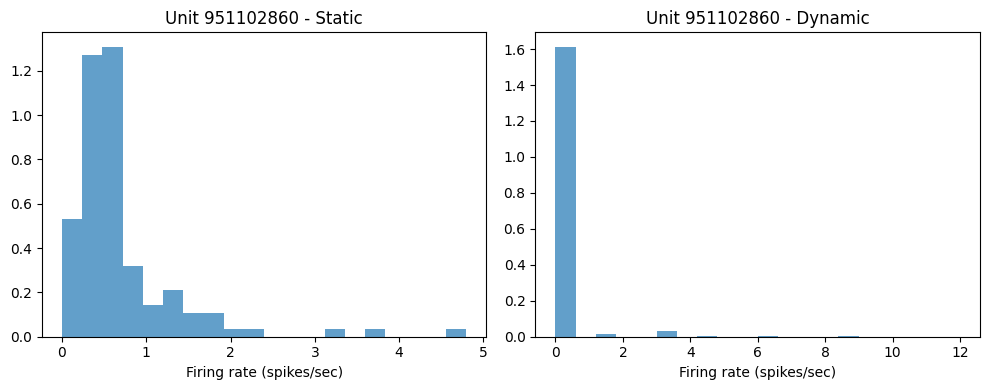

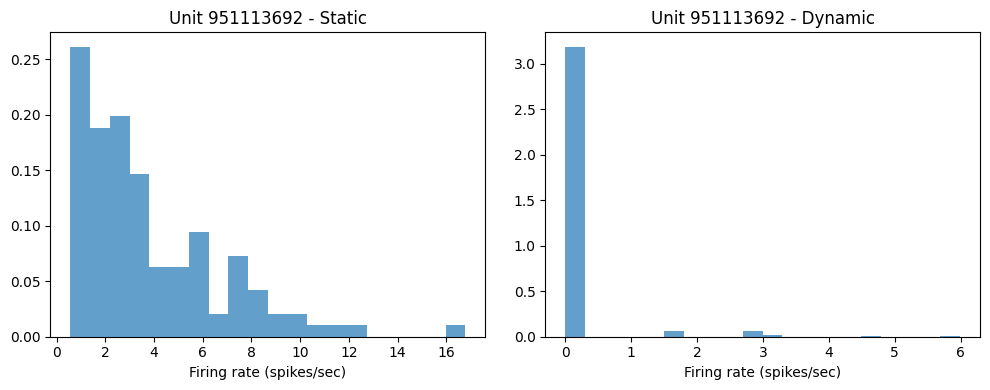

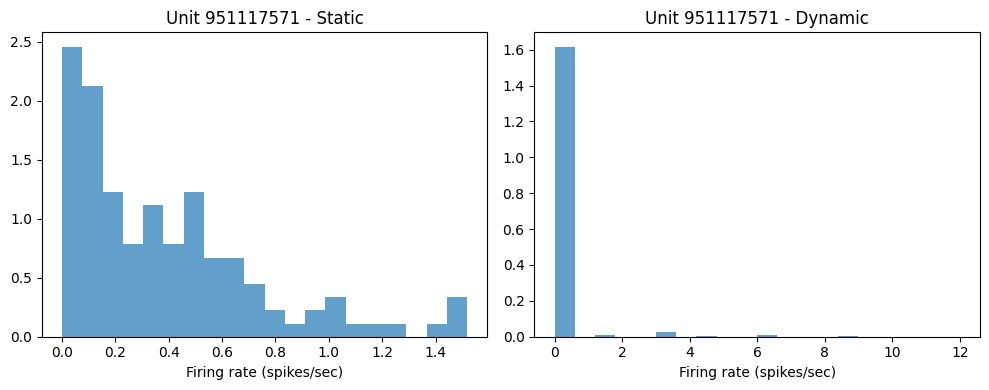

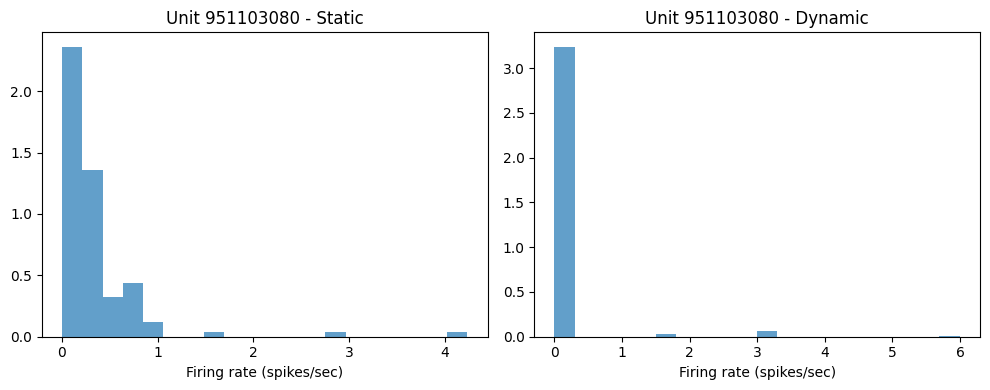

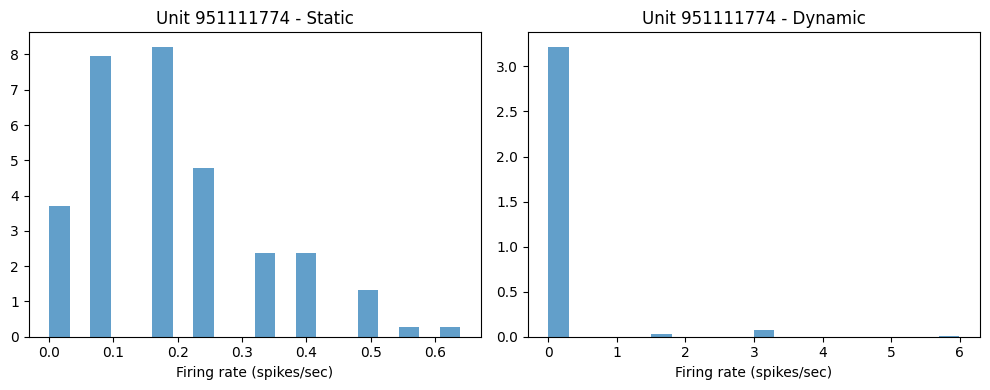

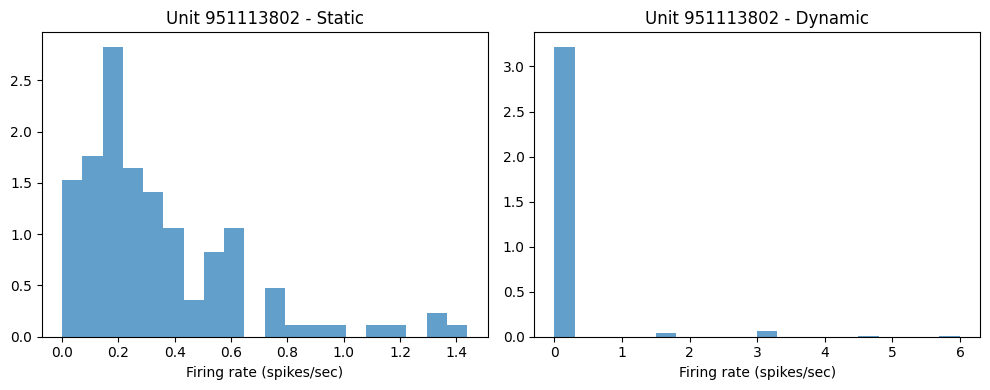

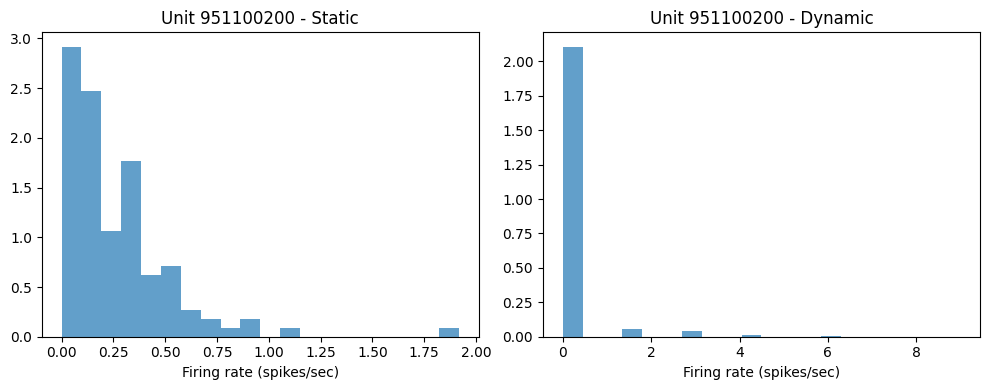

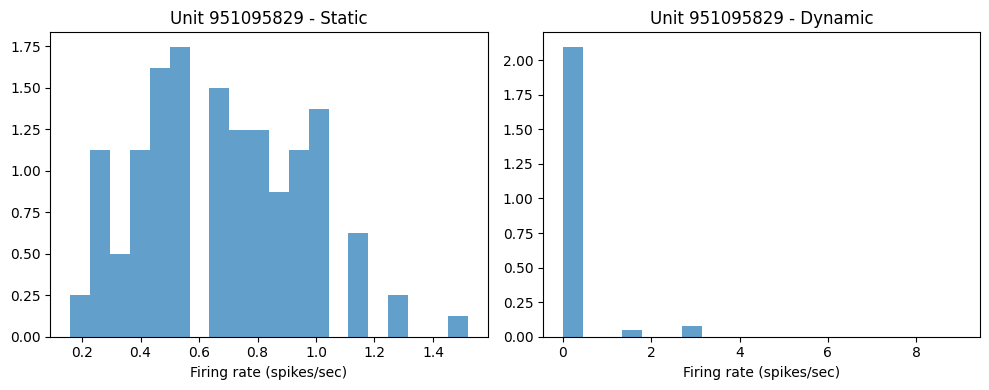

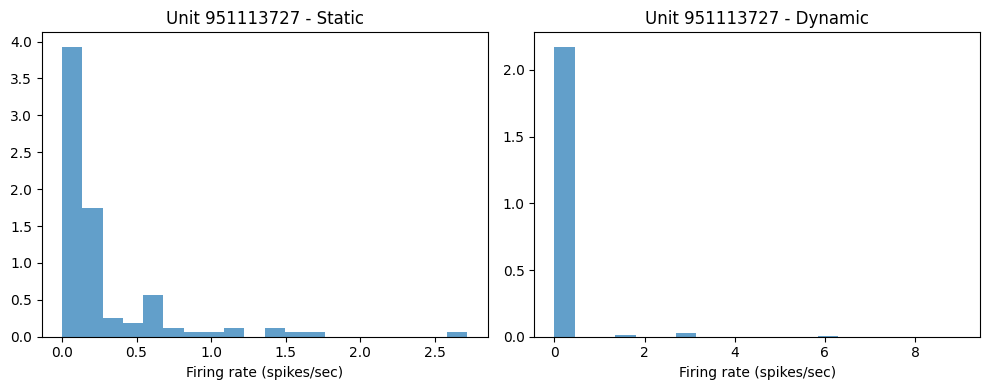

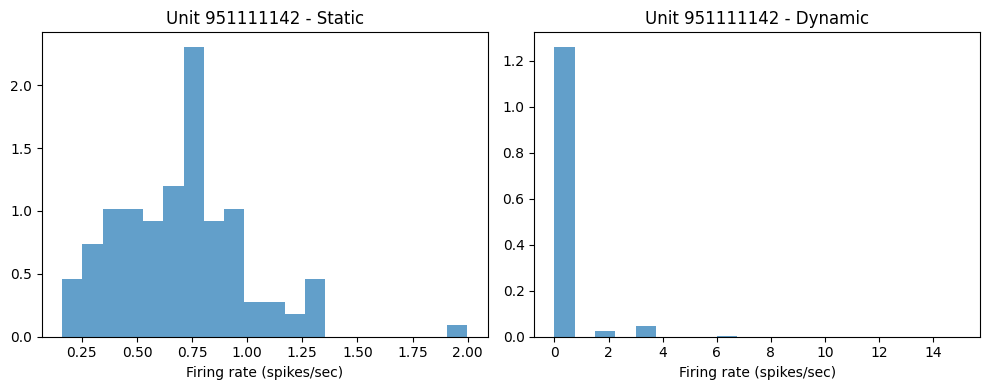

In [ ]:
# Let's analyse feature selectivity in top discriminative neurons
for unit_id in discriminative_neurons[:10]:
    # static responses
    static_resp = np.array([resp.sel(unit_id=unit_id).values.item() 
                          for resp in scene_resp_by_image.values()])
        
    # dynamic responses (movie1 + movie3)
    movie_resp = np.array([resp.sel(unit_id=unit_id).values.item() 
                         for resp in list(movie1_resp_by_frame.values()) +
                         list(movie3_resp_by_frame.values())])
        
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.hist(static_resp, bins=20, alpha=0.7, density=True)
    plt.title(f'Unit {unit_id} - Static')
    plt.xlabel('Firing rate (spikes/sec)')
    
    plt.subplot(1, 2, 2)
    plt.hist(movie_resp, bins=20, alpha=0.7, density=True)
    plt.title(f'Unit {unit_id} - Dynamic')
    plt.xlabel('Firing rate (spikes/sec)')
    
    plt.tight_layout()
    plt.show()

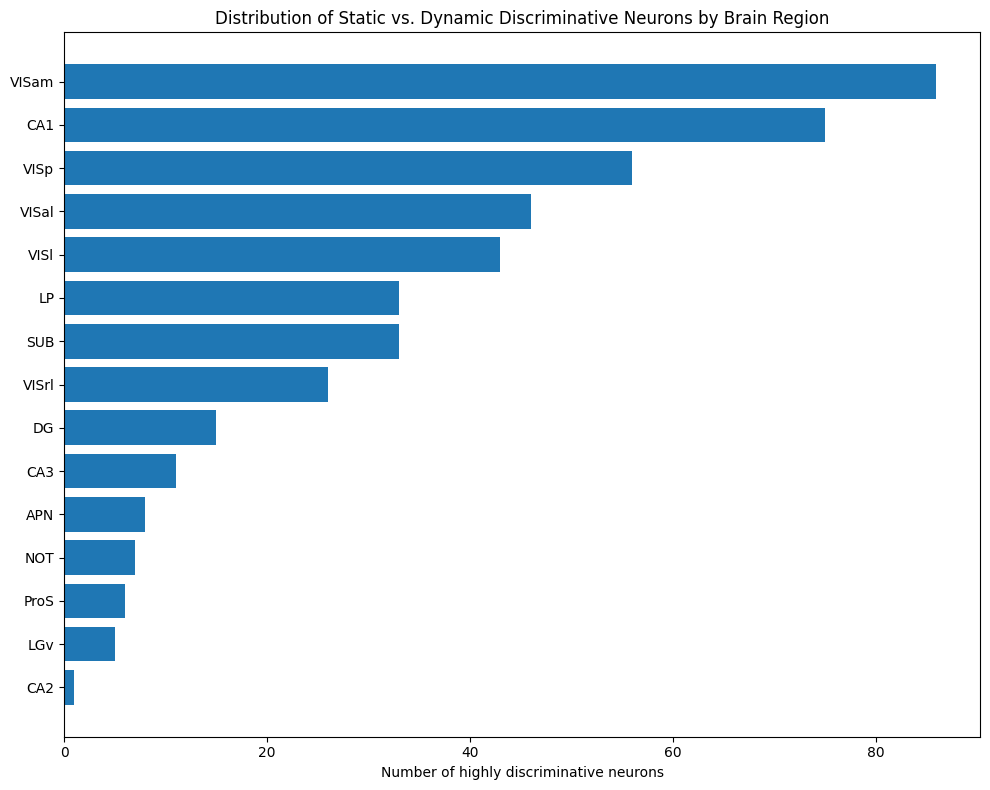

In [69]:
# Let's analyse the brain region distribution of the top discriminative neurons
regional_neurons = [uid for uid in discriminative_neurons if uid in session.units.index]

region_counts = {}
for unit_id in regional_neurons:
    region = session.units.loc[unit_id, 'ecephys_structure_acronym']
    if pd.notna(region):
        region_counts[region] = region_counts.get(region, 0) + 1
        # if region not in region_counts, set to 0 and add 1
        # if region in region_counts, add 1 to the count

regions = list(region_counts.keys())
counts = [region_counts[r] for r in regions]

sorted_idx = np.argsort(counts)
plt.figure(figsize=(10, 8))
plt.barh([regions[i] for i in sorted_idx], [counts[i] for i in sorted_idx])
plt.xlabel('Number of highly discriminative neurons')
plt.title('Distribution of Static vs. Dynamic Discriminative Neurons by Brain Region')
plt.tight_layout()
plt.show()

VISam and CA1 have the most top discriminative neurons. This is interesting, because while the visual cortex areas are expected to be among the top, the strong presence of the hippocampal areas shows that memory and context-related processes have a significant role in encoding the distinction between static and dynamic stimuli, likely important for processing the latter, where continuity and memory play a key role.

Acknowledging that by taking absolute values one is prone to run into the sampling bias, we also look at the proportion of discriminative neurons in each brain region.

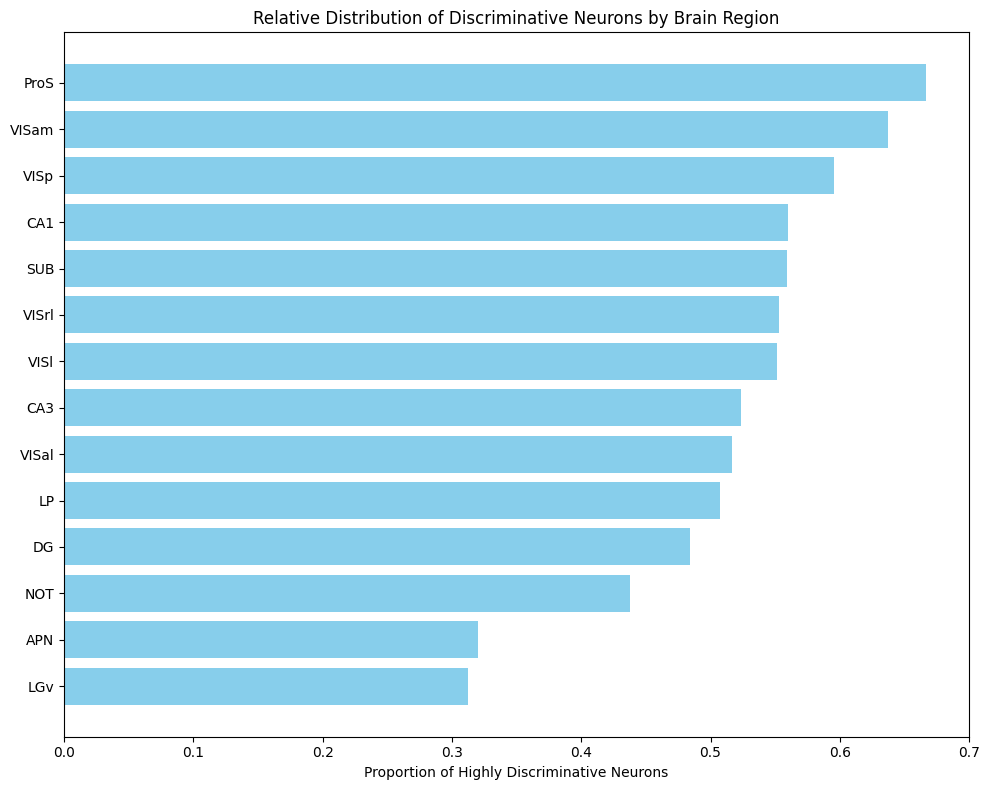

Region	Discriminative	Total	Proportion
ProS		6	9	0.667
VISam		86	135	0.637
VISp		56	94	0.596
CA1		75	134	0.560
SUB		33	59	0.559
VISrl		26	47	0.553
VISl		43	78	0.551
CA3		11	21	0.524
VISal		46	89	0.517
LP		33	65	0.508
DG		15	31	0.484
NOT		7	16	0.438
APN		8	25	0.320
LGv		5	16	0.312


In [70]:
# getting total neurons recorded in each region
total_neurons_by_region = session.units.groupby('ecephys_structure_acronym').size().to_dict()

# proportions of discriminative neurons
region_proportions = {}
for region in region_counts:
    if region in total_neurons_by_region and total_neurons_by_region[region] > 0:
        region_proportions[region] = region_counts[region] / total_neurons_by_region[region]

# only include regions with at least 5 recorded neurons
min_neurons = 5
filtered_proportions = {r: p for r, p in region_proportions.items() 
                       if total_neurons_by_region.get(r, 0) >= min_neurons}

# sorting by proportion for plotting
regions = list(filtered_proportions.keys())
proportions = [filtered_proportions[r] for r in regions]

sorted_idx = np.argsort(proportions)
plt.figure(figsize=(10, 8))
plt.barh([regions[i] for i in sorted_idx], [proportions[i] for i in sorted_idx], color='skyblue')
plt.xlabel('Proportion of Highly Discriminative Neurons')
plt.title('Relative Distribution of Discriminative Neurons by Brain Region')
plt.tight_layout()
plt.show()

print("Region\tDiscriminative\tTotal\tProportion")
for region in sorted(regions, key=lambda r: filtered_proportions[r], reverse=True):
    print(f"{region}\t\t{region_counts[region]}\t{total_neurons_by_region[region]}\t" +
          f"{filtered_proportions[region]:.3f}")

In fact, these statistics show a very different picture if we look at brain regions specifically. CA1 and VISam are still positioned well, but are no longer at the top of the list. However, the presence of hippocampal regions among the top is still notable, and we believe the truth has to lie between these two "counting methods", since also the placing of the probes and the units in which useful activity was recorded was arbitrary and/or casual to some extent.

### Population decoding and complementary analyses

Let's do some population decoding and see how many neurons are actually needed for perfect classification.

In [71]:
unit_id_to_index = {uid: idx for idx, uid in enumerate(unit_ids)}
# unit_ids are the same as session.units.index.values, but we create a mapping for convenience
neurons_ordered_indices = [unit_id_to_index[uid] for uid in discriminative_neurons if uid in unit_id_to_index]

In [72]:
def population_decoding_curve(neurons_ordered, X_train, y_train, X_val, y_val, X_test, y_test):
    accuracies_train = []
    accuracies_val = []
    accuracies_test = []
    num_neurons_list = list(range(1, len(neurons_ordered)+1))

    for n in num_neurons_list:
        selected_neurons = neurons_ordered[:n]
        X_train_sub = X_train[:, selected_neurons]
        X_val_sub = X_val[:, selected_neurons]
        X_test_sub = X_test[:, selected_neurons]

        # parameters from best model
        clf = SVC(kernel='linear', C=0.1, class_weight='balanced', random_state=42)
        clf.fit(X_train_sub, y_train)

        accuracies_train.append(balanced_accuracy_score(y_train, clf.predict(X_train_sub)))
        accuracies_val.append(balanced_accuracy_score(y_val, clf.predict(X_val_sub)))
        accuracies_test.append(balanced_accuracy_score(y_test, clf.predict(X_test_sub)))

    plt.figure(figsize=(10,6))
    plt.plot(num_neurons_list, accuracies_train, label='Train')
    plt.plot(num_neurons_list, accuracies_val, label='Validation')
    plt.plot(num_neurons_list, accuracies_test, label='Test')
    plt.xlabel('Number of Neurons')
    plt.ylabel('Balanced Accuracy')
    plt.title('Population Decoding Curve')
    plt.axhline(1.0, color='k', linestyle='--', label='Perfect Accuracy')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    return num_neurons_list, accuracies_train, accuracies_val, accuracies_test

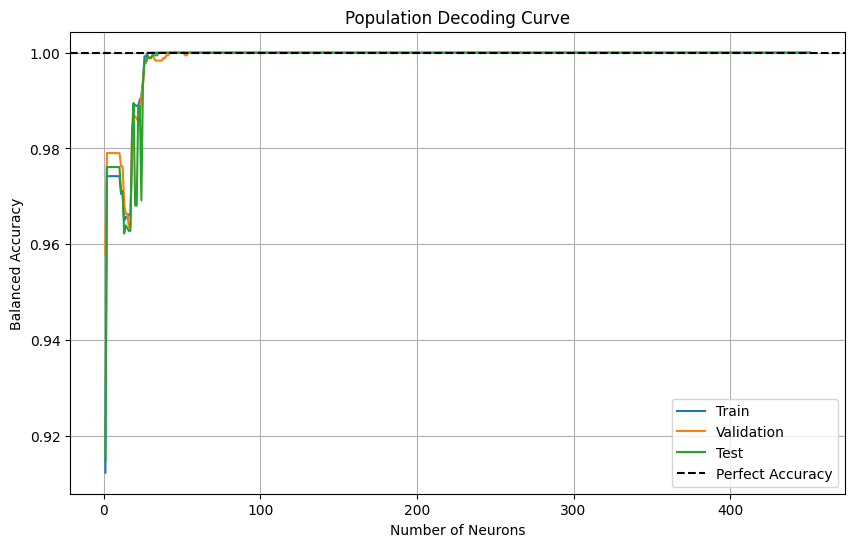

In [73]:
# neurons ordered by discriminative power
results = population_decoding_curve(neurons_ordered_indices, X_train_scaled, y_train, 
                                   X_val_scaled, y_val, X_test_scaled, y_test)

In [74]:
perfect_threshold = np.argmax(np.array(results[3]) == 1.0) + 1
print(f"Minimum neurons for perfect classification: {perfect_threshold}")

Minimum neurons for perfect classification: 35


This is a relatively low number compared to the total of 825 units in this session. It's important to note, that maybe even fewer neurons are enough (since the accuracy even went down in-between), but here we rely on the p-value to tell us, which is based only on the average firing rate, and according to this we need 35 units. So it might be that by taking latency we would need less neurons. Moreover, the Mann-Whitney test used to identify them also has a random factor. The following analysis is to be examined in light of this "bias".

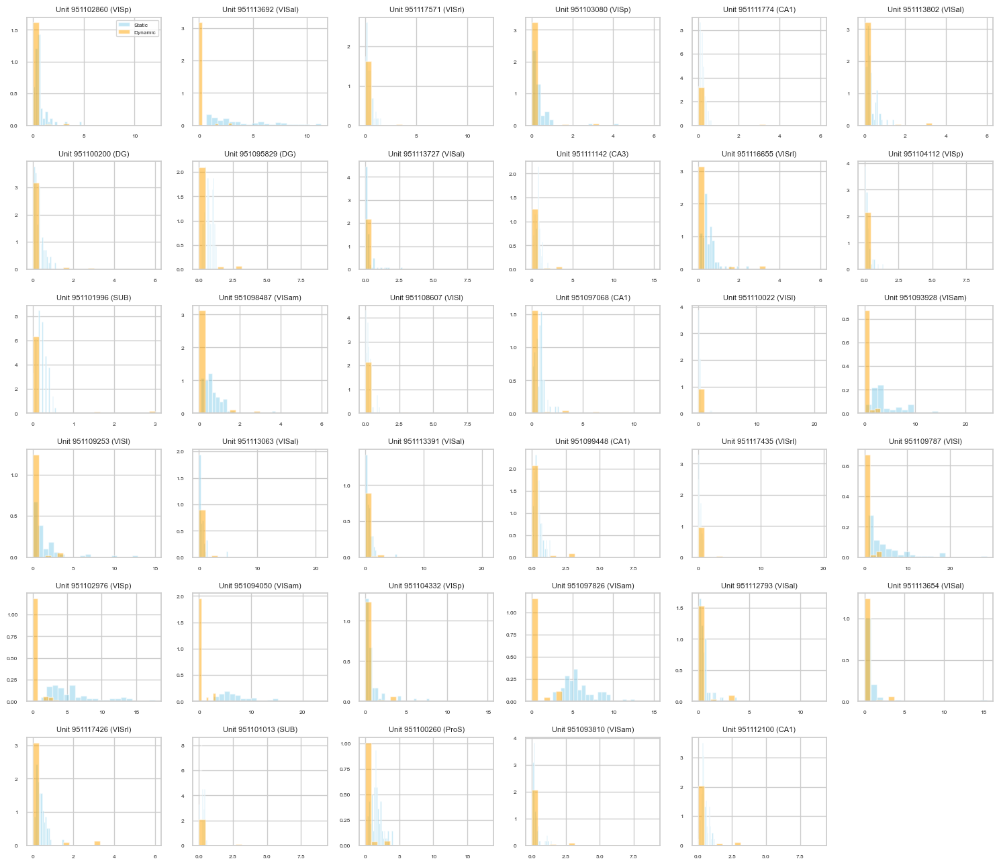

Brain region distribution of top discriminative neurons:
VISal: 7 neurons (20.0%)
VISp: 5 neurons (14.3%)
VISam: 5 neurons (14.3%)
VISrl: 4 neurons (11.4%)
CA1: 4 neurons (11.4%)
VISl: 4 neurons (11.4%)
DG: 2 neurons (5.7%)
SUB: 2 neurons (5.7%)
CA3: 1 neurons (2.9%)
ProS: 1 neurons (2.9%)


In [137]:
num_neurons = 35
neurons_to_plot = discriminative_neurons[:num_neurons]

rows = 7
cols = 6

plt.figure(figsize=(15, 15))

for i, uid in enumerate(neurons_to_plot):
    static = X_train[y_train == 0, unit_id_to_index[uid]]
    dynamic = X_train[y_train == 1, unit_id_to_index[uid]]
    
    # getting brain region for this unit
    region = session.units.loc[uid, 'ecephys_structure_acronym']
    
    plt.subplot(rows, cols, i + 1)
    plt.hist(static, bins=20, alpha=0.5, density=True, label='Static', color='skyblue')
    plt.hist(dynamic, bins=20, alpha=0.5, density=True, label='Dynamic', color='orange')
    plt.title(f'Unit {uid} ({region})', fontsize=8)
    plt.xticks(fontsize=6)
    plt.yticks(fontsize=6)
    if i == 0:
        plt.legend(fontsize=6)

plt.tight_layout()
plt.show()

region_counts = {}
for uid in neurons_to_plot:
    region = session.units.loc[uid, 'ecephys_structure_acronym']
    region_counts[region] = region_counts.get(region, 0) + 1

print("Brain region distribution of top discriminative neurons:")
for region, count in sorted(region_counts.items(), key=lambda x: x[1], reverse=True):
    print(f"{region}: {count} neurons ({count/num_neurons:.1%})")

So we have neurons with extremely significant differences in firing patterns between static and dynamic stimuli (as already identified before with the restrictive p-value). These neurons likely have non-overlapping response distributions for the two classes OR complementary selectivity, and the former might be more accurate based on previous visualisations.

(The firing rate plots above aren't normalised, so we see more firing for dynamic stimuli, because many more movie frames were shown compared to natural scenes.)

In [138]:
# initialising connectivity cache
# here we connect to the Allen Brain Institute's connectivity database
# to access tracer injection experiments that map neural pathways
mcc = MouseConnectivityCache(manifest_file='connectivity/manifest.json')
# and we retrieve a hierarchical list of the mouse brain regions
# complete with IDs, regions, and names
structure_tree = mcc.get_structure_tree()

# getting regions of top discriminative neurons (where they are located)
top_regions = session.units.loc[discriminative_neurons[:35], 'ecephys_structure_acronym'].unique()
print(f"Top regions for discriminative neurons: {top_regions}")

# getting structure IDs and experiments involving the above found regions (where tracers were injected into them)
structures = structure_tree.get_structures_by_acronym(top_regions)
region_ids = [s['id'] for s in structures]
experiments = mcc.get_experiments(injection_structure_ids=region_ids)
print(f"Found {len(experiments)} relevant connectivity experiments")

Top regions for discriminative neurons: ['VISp' 'VISal' 'VISrl' 'CA1' 'DG' 'CA3' 'SUB' 'VISam' 'VISl' 'ProS']
Found 566 relevant connectivity experiments


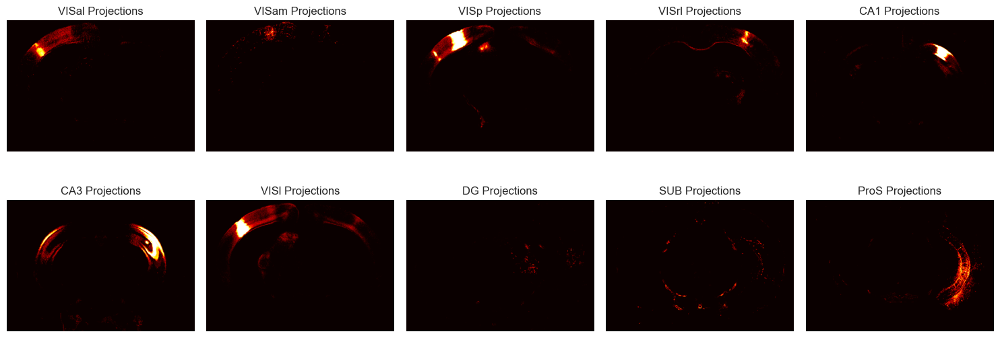

In [145]:
# getting structure IDs for top visual regions
regions = ['VISal', 'VISam', 'VISp', 'VISrl', 'CA1', 'CA3', 'VISl', 'DG', 'SUB', 'ProS']
structures = structure_tree.get_structures_by_acronym(regions)
ids = [s['id'] for s in structures if s is not None]

# figure with subplots for each region
plt.figure(figsize=(15, 6))

for i, region in enumerate(regions):
    # finding "representative slice"
    region_units = session.units[session.units['ecephys_structure_acronym'] == region]
    if len(region_units) == 0:
        continue
        
    region_slice = int((region_units['anterior_posterior_ccf_coordinate'].mean() / 25) - 1)
    
    # retrieving experiments and projections
    structure = next((s for s in structures if s is not None and s['acronym'] == region), None)
    if structure is None:
        continue
        
    experiments = mcc.get_experiments(injection_structure_ids=[structure['id']])
    if len(experiments) == 0:
        continue
    
    projection, header = mcc.get_projection_density(experiments[0]['id'])
    
    plt.subplot(2, 5, i+1)
    plt.imshow(projection[region_slice,:,:], cmap='hot')
    plt.axis('off')
    plt.grid(False)
    plt.title(f'{region} Projections')

plt.tight_layout()
plt.show()

528 slices: Left → Right (mediolateral axis)\
320 slices: Anterior → Posterior (front → back)\
456 slices: Superior → Inferior (top → bottom)

Spatial resolution: 25µm/voxel (1 voxel ≈ 50 neurons)

Coordinate system:
- Left-Right (x-axis):
    - 0 = brain midline
    - 528 = leftmost point
    - values increase leftward
- Anterior-Posterior (y-axis):
    - 0 = front of brain (rostral)
    - 320 = back of brain (caudal)
    - runs top→bottom (in coronal slices)
- Superior-Inferior (z-axis):
    - 0 = top of brain (dorsal)
    - 456 = bottom of brain (ventral)
    - runs front→back (in coronal slices)

## Testing model on static vs. drifting gratings

As mentioned a couple of times, the available data -- both the natural scenes and the movie frames -- are limited, both in nature (as in type) and in number (especially the 'static' stimuli). So we try to see just how robust our model is by looking at its performance on the static vs. drifting gratings from the same session.

Drifting gratings were shown with a spatial frequency of 0.04 cycles/deg, 80% contrast, 8 directions (0o, 45o, 90o, 135o, 180o, 225o, 270o, 315o, clockwise from 0o = right-to-left) and 5 temporal frequencies (1, 2, 4, 8, and 15 Hz), with 15 repeats per condition. Static gratings were shown at 6 different orientations (0o, 30o, 60o, 90o, 120o, 150o, clockwise from 0o = vertical), 5 spatial frequencies (0.02, 0.04, 0.08, 0.16, 0.32 cycles/degree), and 4 phases (0, 0.25, 0.5, 0.75); they are presented for 0.25 seconds, with no intervening gray period.

In [78]:
static_gratings_table = session.get_stimulus_table('static_gratings')
static_gratings_table

,stimulus_block,start_time,stop_time,contrast,spatial_frequency,phase,stimulus_name,size,orientation,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,
49434,8.0,5399.367847,5399.618056,0.8,0.02,0.5,static_gratings,"[250.0, 250.0]",150.0,0.250209,4787
49435,8.0,5399.618056,5399.868265,0.8,0.16,0.5,static_gratings,"[250.0, 250.0]",0.0,0.250209,4788
49436,8.0,5399.868265,5400.118474,0.8,0.04,0.25,static_gratings,"[250.0, 250.0]",30.0,0.250209,4789
49437,8.0,5400.118474,5400.368684,0.8,0.04,0.75,static_gratings,"[250.0, 250.0]",60.0,0.250209,4790
49438,8.0,5400.368684,5400.618889,0.8,0.08,0.0,static_gratings,"[250.0, 250.0]",60.0,0.250206,4791
...,...,...,...,...,...,...,...,...,...,...,...
70385,14.0,9151.253694,9151.503914,0.8,0.08,0.5,static_gratings,"[250.0, 250.0]",150.0,0.250219,4895
70386,14.0,9151.503914,9151.754127,0.8,0.08,0.0,static_gratings,"[250.0, 250.0]",60.0,0.250213,4791
70387,14.0,9151.754127,9152.004340,0.8,0.04,0.75,static_gratings,"[250.0, 250.0]",0.0,0.250213,4800


In [79]:
drifting_gratings_table = session.get_stimulus_table('drifting_gratings')
drifting_gratings_table

,stimulus_block,start_time,stop_time,contrast,spatial_frequency,phase,stimulus_name,size,orientation,temporal_frequency,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,
3798,2.0,1586.180717,1588.182387,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",0.0,15.0,2.00167,246
3799,2.0,1589.183244,1591.184924,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",180.0,2.0,2.00168,247
3800,2.0,1592.185737,1594.187427,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",45.0,1.0,2.00169,248
3801,2.0,1595.188274,1597.189944,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",90.0,8.0,2.00167,249
3802,2.0,1598.190777,1600.192447,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",270.0,2.0,2.00167,250
...,...,...,...,...,...,...,...,...,...,...,...,...
49428,7.0,5384.355314,5386.356974,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",315.0,4.0,2.00166,260
49429,7.0,5387.357797,5389.359487,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",0.0,1.0,2.00169,252
49430,7.0,5390.360334,5392.361994,0.8,0.04,"[5308.98333333, 5308.98333333]",drifting_gratings,"[250.0, 250.0]",90.0,8.0,2.00166,249


- Static Gratings: 120 conditions (6 orientations × 5 spatial freqs × 4 phases)
- Drifting Gratings: 40 conditions (8 orientations × 5 temporal freqs)

In [80]:
print("Static gratings:", static_gratings_table['spatial_frequency'].nunique())
print("Drifting gratings:", drifting_gratings_table['temporal_frequency'].nunique())

Static gratings: 6
Drifting gratings: 6


Again, we hunt.

In [81]:
print("Static gratings:", static_gratings_table['spatial_frequency'].unique())
print("Drifting gratings:", drifting_gratings_table['temporal_frequency'].unique())

Static gratings: [0.02 0.16 0.04 0.08 0.32 'null']
Drifting gratings: [15.0 2.0 1.0 8.0 4.0 'null']


In [82]:
static_gratings_table = static_gratings_table[static_gratings_table['spatial_frequency'] != 'null']
print(static_gratings_table['spatial_frequency'].unique())
drifting_gratings_table = drifting_gratings_table[drifting_gratings_table['temporal_frequency'] != 'null']
print(drifting_gratings_table['temporal_frequency'].unique())

[0.02 0.16 0.04 0.08 0.32]
[15.0 2.0 1.0 8.0 4.0]


In [83]:
print("Static gratings duration:", static_gratings_table['stop_time'] - static_gratings_table['start_time'])
print("\nDrifting gratings duration:", drifting_gratings_table['stop_time'] - drifting_gratings_table['start_time'])

Static gratings duration: stimulus_presentation_id
49434    0.250209
49435    0.250209
49436    0.250209
49437    0.250209
49438    0.250206
           ...   
70385    0.250219
70386    0.250213
70387    0.250213
70388    0.250213
70389    0.250213
Length: 5806, dtype: float64

Drifting gratings duration: stimulus_presentation_id
3798     2.00167
3799     2.00168
3800     2.00169
3801     2.00167
3802     2.00167
          ...   
49428    2.00166
49429    2.00169
49430    2.00166
49431    2.00169
49432    2.00168
Length: 600, dtype: float64


In [84]:
static_presentation_duration = (static_gratings_table['stop_time'] - static_gratings_table['start_time']).mean()
print(f"Static presentation duration: {static_presentation_duration:} seconds")
drifting_presentation_duration = (drifting_gratings_table['stop_time'] - drifting_gratings_table['start_time']).mean()
print(f"Drifting presentation duration: {drifting_presentation_duration:} seconds")

Static presentation duration: 0.2502091308451592 seconds
Drifting presentation duration: 2.0016739666666568 seconds


In [85]:
# static gratings
static_grating_spikes = session.presentationwise_spike_counts(
    stimulus_presentation_ids=static_gratings_table.index.values,
    bin_edges=np.array([0, static_presentation_duration]),
    unit_ids=session.units.index.values
)
static_grating_rates = static_grating_spikes / static_presentation_duration

# drifting gratings
drifting_grating_spikes = session.presentationwise_spike_counts(
    stimulus_presentation_ids=drifting_gratings_table.index.values,
    bin_edges=np.array([0, drifting_presentation_duration]),
    unit_ids=session.units.index.values
)
drifting_grating_rates = drifting_grating_spikes / drifting_presentation_duration

In [86]:
static_grating_groups = static_gratings_table.groupby(['orientation', 'spatial_frequency', 'phase'])
static_grating_resp = {params: get_mean_response(group, static_grating_rates) 
                       for params, group in static_grating_groups}

drifting_grating_groups = drifting_gratings_table.groupby(['temporal_frequency', 'orientation'])
drifting_grating_resp = {params: get_mean_response(group, drifting_grating_rates) 
                          for params, group in drifting_grating_groups}

In [87]:
# loading saved model
saved_model = joblib.load('best_model.pkl')
scaler = saved_model['scaler']
model = saved_model['model']

# preparing grating features
X_static = np.array([resp.values.flatten() for resp in static_grating_resp.values()])
X_drifting = np.array([resp.values.flatten() for resp in drifting_grating_resp.values()])

# labels (0=static, 1=dynamic aka drifting)
y_static = np.zeros(len(X_static))
y_drifting = np.ones(len(X_drifting))

X_gratings = np.vstack([X_static, X_drifting])
y_gratings = np.concatenate([y_static, y_drifting])
X_gratings_scaled = scaler.transform(X_gratings)

print("Number of static gratings:", len(X_static))
print("Number of drifting gratings:", len(X_drifting))

Number of static gratings: 120
Number of drifting gratings: 40


              precision    recall  f1-score   support

      Static       1.00      1.00      1.00       120
     Dynamic       1.00      1.00      1.00        40

    accuracy                           1.00       160
   macro avg       1.00      1.00      1.00       160
weighted avg       1.00      1.00      1.00       160



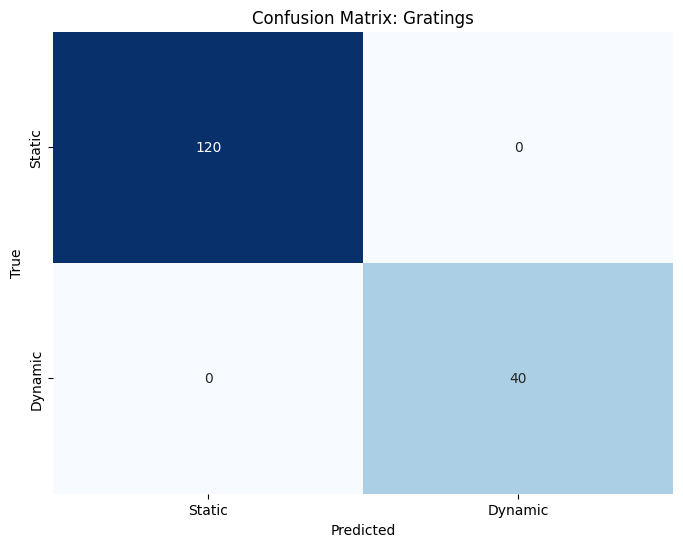

In [88]:
# evaluate
grating_pred = model.predict(X_gratings_scaled)
print(classification_report(y_gratings, grating_pred, target_names=['Static', 'Dynamic']))

cm = confusion_matrix(y_gratings, grating_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['Static', 'Dynamic'], yticklabels=['Static', 'Dynamic'])
plt.title('Confusion Matrix: Gratings')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

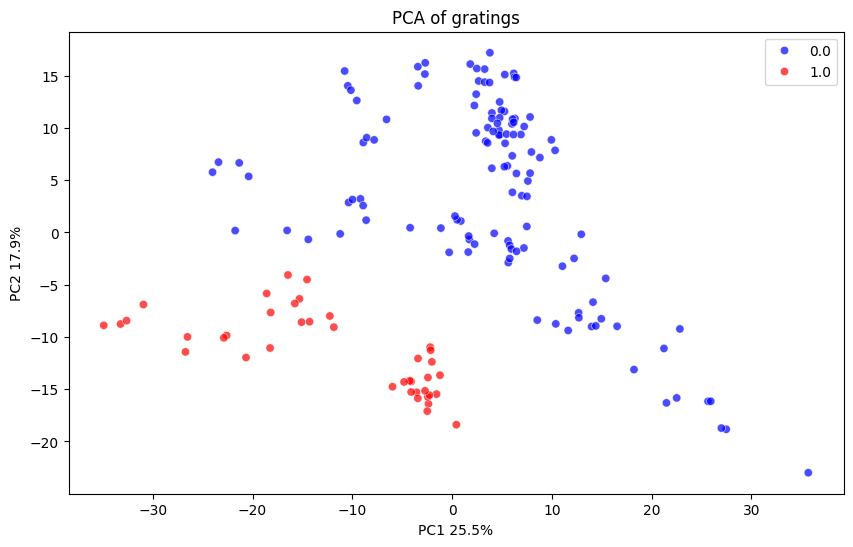

In [89]:
# PCA of static vs drifting gratings
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_gratings_scaled)

plt.figure(figsize=(10,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=y_gratings,
                palette={0:'blue', 1:'red'}, alpha=0.7)
plt.title("PCA of gratings")
plt.xlabel(f'PC1 {pca.explained_variance_ratio_[0]:.1%}'); plt.ylabel(f'PC2 {pca.explained_variance_ratio_[1]:.1%}')
plt.show

The fact that static vs. drifting stimuli were classified perfectly provides strong evidence that brain processes motion in a fundamentally different way than static images, regardless of specific content.



## Investigating different areas of the brain

We proceed our investigation by looking for statistical differences among different areas of the brain. In particular we are interest in three metrics:
- average firing rate
- Fano factor
- latency of response

In [90]:
print(session.units.columns)

Index(['waveform_PT_ratio', 'waveform_amplitude', 'amplitude_cutoff',
       'cluster_id', 'cumulative_drift', 'd_prime', 'firing_rate',
       'isi_violations', 'isolation_distance', 'L_ratio', 'local_index',
       'max_drift', 'nn_hit_rate', 'nn_miss_rate', 'peak_channel_id',
       'presence_ratio', 'waveform_recovery_slope',
       'waveform_repolarization_slope', 'silhouette_score', 'snr',
       'waveform_spread', 'waveform_velocity_above', 'waveform_velocity_below',
       'waveform_duration', 'filtering', 'probe_channel_number',
       'probe_horizontal_position', 'probe_id', 'probe_vertical_position',
       'structure_acronym', 'ecephys_structure_id',
       'ecephys_structure_acronym', 'anterior_posterior_ccf_coordinate',
       'dorsal_ventral_ccf_coordinate', 'left_right_ccf_coordinate',
       'probe_description', 'location', 'probe_sampling_rate',
       'probe_lfp_sampling_rate', 'probe_has_lfp_data'],
      dtype='object')


In [91]:
# stimuli = {
#     'natural_scenes': session.stimulus_presentations.query("stimulus_name == 'natural_scenes' and duration > 0"),
#     'natural_movie_one': session.stimulus_presentations.query("stimulus_name == 'natural_movie_one' and duration > 0")
# }

# units = session.units
# results = []

# # Loop on stimuli
# for stim_name, stim_df in stimuli.items():
#     for unit_id, unit in tqdm(units.iterrows(), total=len(units)):
#         spike_times = session.spike_times[unit_id]
#         area = unit['structure_acronym']

#         spike_counts = []
#         latencies = []

#         for _, row in stim_df.iterrows():
#             start = row['start_time']
#             end = row['stop_time']
#             spikes = spike_times[(spike_times >= start) & (spike_times <= end)]
#             spike_counts.append(len(spikes))
#             if len(spikes) > 0:
#                 latencies.append(spikes[0] - start)

#         spike_counts = np.array(spike_counts)
#         duration = stim_df['duration'].sum()

#         firing_rate = spike_counts.sum() / duration if duration > 0 else np.nan
#         fano = np.var(spike_counts) / np.mean(spike_counts) if np.mean(spike_counts) > 0 else np.nan
#         latency = np.mean(latencies) if len(latencies) > 0 else np.nan

#         results.append({
#             'unit_id': unit_id,
#             'area': area,
#             'stimulus': stim_name,
#             'firing_rate': firing_rate,
#             'fano_factor': fano,
#             'latency': latency
#         })

# df_metrics = pd.DataFrame(results)
# df_metrics.to_csv("metrics_per_unit.csv", index=False)

In [92]:
df_metrics = pd.read_csv("metrics_per_unit.csv")
df_metrics.head()

,unit_id,area,stimulus,firing_rate,fano_factor,latency
0,951088679,APN,natural_scenes,7.858972,0.925408,0.077806
1,951088664,APN,natural_scenes,7.735378,1.330950,0.087440
2,951088734,APN,natural_scenes,0.964571,3.453642,0.114430
3,951088721,APN,natural_scenes,11.750170,2.634859,0.061264
4,951088862,APN,natural_scenes,16.460180,0.884288,0.050528


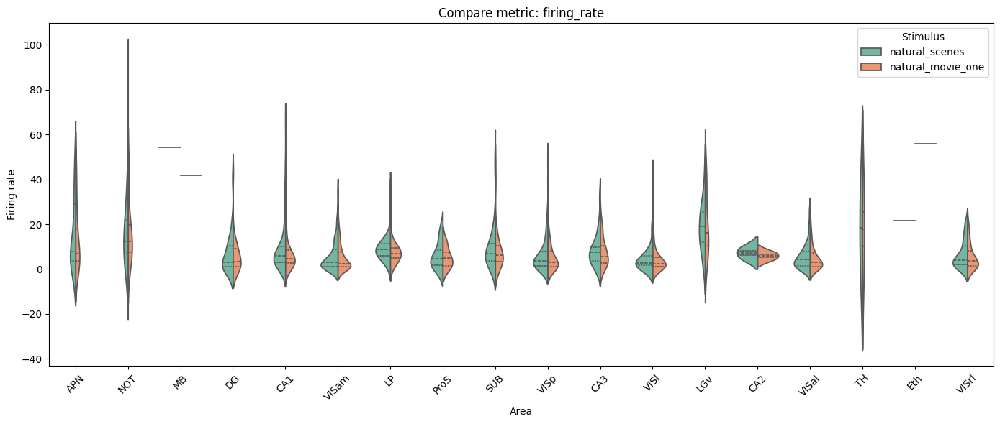

In [93]:
# visualise metrics: firing rate
metric = "firing_rate"  

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

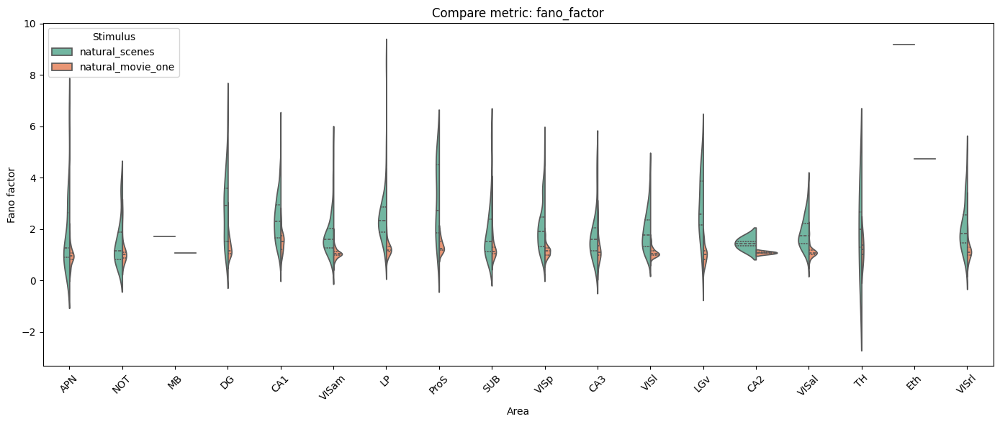

In [94]:
# visualise metrics: fano factor
metric = "fano_factor" 

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

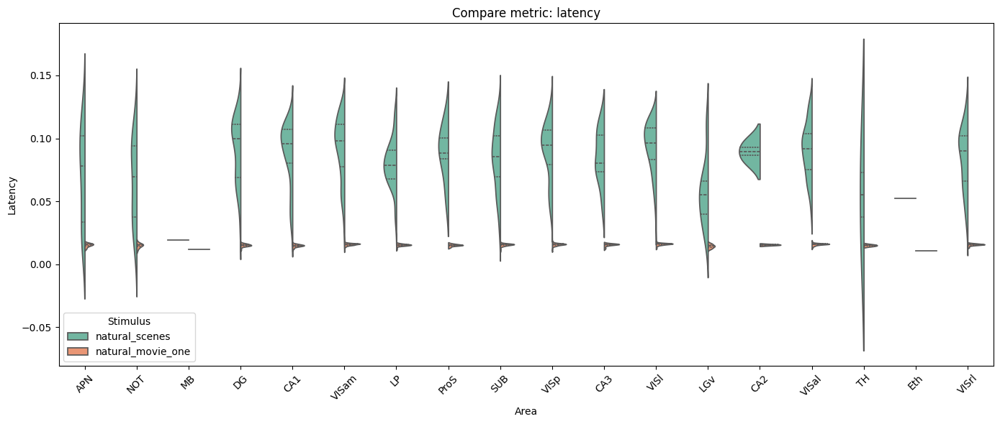

In [95]:
# visualise metrics: latency
metric = "latency"  

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

We continue our investingation by performing ANOVA to assess if there are relevant statistical differences among different brain areas. Before digging into ANOVA, we first check the distribution of our metrics is normal with Shapiro-Wilk and homogeneity of variance with Levene tests. 

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.001120060682296753
Area: NOT, p-value: 0.0011944979196414351
Area: MB, p-value: nan
Area: DG, p-value: 3.950374320993433e-06
Area: CA1, p-value: 6.977609238827381e-15
Area: VISam, p-value: 1.3676205350490744e-12
Area: LP, p-value: 1.2575779919643537e-06
Area: ProS, p-value: 0.13988427817821503
Area: SUB, p-value: 3.94660970570726e-09
Area: VISp, p-value: 1.879920264596935e-12
Area: CA3, p-value: 0.0031696578953415155
Area: VISl, p-value: 7.824652926459452e-13
Area: LGv, p-value: 0.7948164939880371
Area: CA2, p-value: nan
Area: VISal, p-value: 7.443658578409895e-09
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 3.537560405675322e-05

Risult of homogeneity of variance (Levene): p-value = 6.447509593754999e-06

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 96.24261219688614, p-value = 4.397821992105568e-13


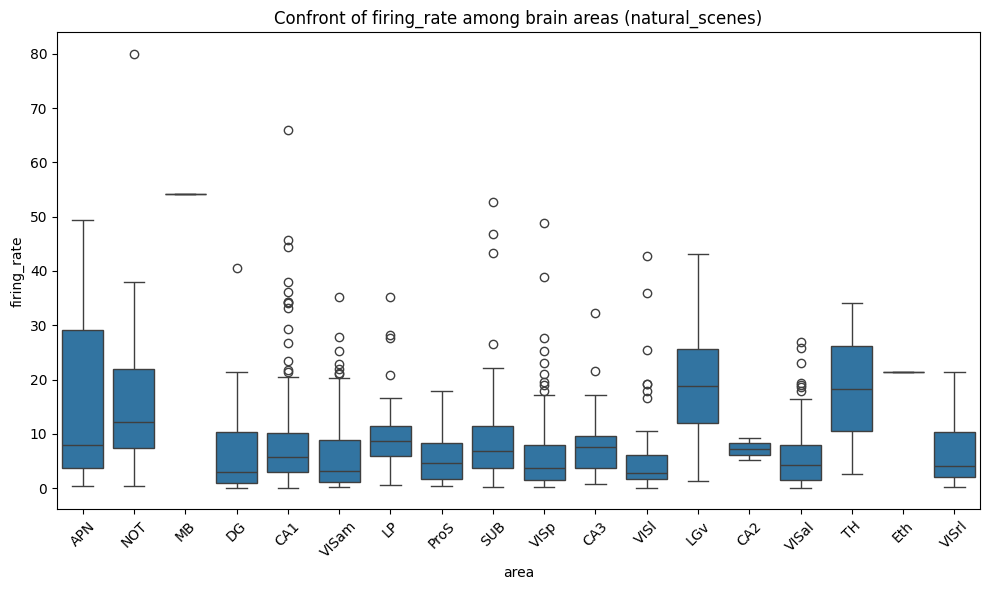

In [96]:
# ANOVA: firing rate
metric = 'firing_rate'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:  # for Shapiro-Wilk at least 3 samples needed
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# hmogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.0004919525817967951
Area: NOT, p-value: 0.012971310876309872
Area: MB, p-value: nan
Area: DG, p-value: 2.7880156494575203e-07
Area: CA1, p-value: 1.118546986804414e-14
Area: VISam, p-value: 1.1698595651227217e-12
Area: LP, p-value: 2.0039638837232587e-09
Area: ProS, p-value: 0.3803427517414093
Area: SUB, p-value: 1.9158767905480545e-09
Area: VISp, p-value: 1.4151019765706874e-12
Area: CA3, p-value: 0.033109381794929504
Area: VISl, p-value: 1.3950560324993422e-11
Area: LGv, p-value: 0.1018877923488617
Area: CA2, p-value: nan
Area: VISal, p-value: 1.6227189592044056e-09
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 1.6001995390979573e-05

Risult of homogeneity of variance (Levene): p-value = 1.6214597458019401e-06

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 93.71915219893356, p-value = 1.2785100623106481e-12


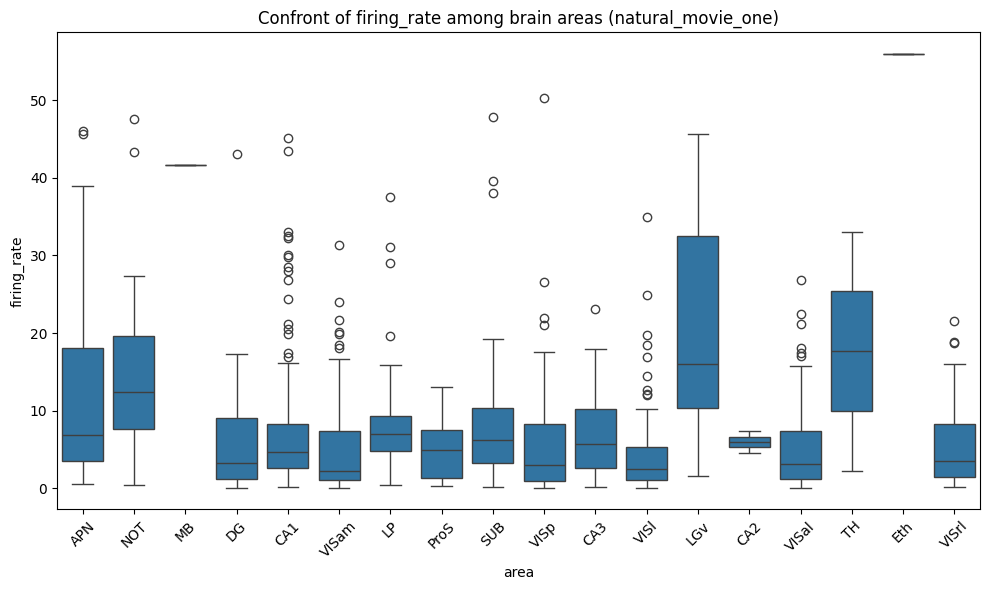

In [97]:
# ANOVA: firing rate
metric = 'firing_rate'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 9.639006020734087e-05
Area: NOT, p-value: 0.002228301949799061
Area: MB, p-value: nan
Area: DG, p-value: 0.06560005992650986
Area: CA1, p-value: 0.008183485828340054
Area: VISam, p-value: 2.1380389125802424e-10
Area: LP, p-value: 4.144419030183144e-09
Area: ProS, p-value: 0.056048836559057236
Area: SUB, p-value: 4.1325019850546596e-08
Area: VISp, p-value: 5.037818482378498e-05
Area: CA3, p-value: 0.0012597101740539074
Area: VISl, p-value: 0.0019793794490396976
Area: LGv, p-value: 0.9224371910095215
Area: CA2, p-value: nan
Area: VISal, p-value: 0.012056630104780197
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.01609935238957405

Risult of homogeneity of variance (Levene): p-value = 0.0008268567241009212

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 108.02719616126342, p-value = 2.8330960819798197e-15


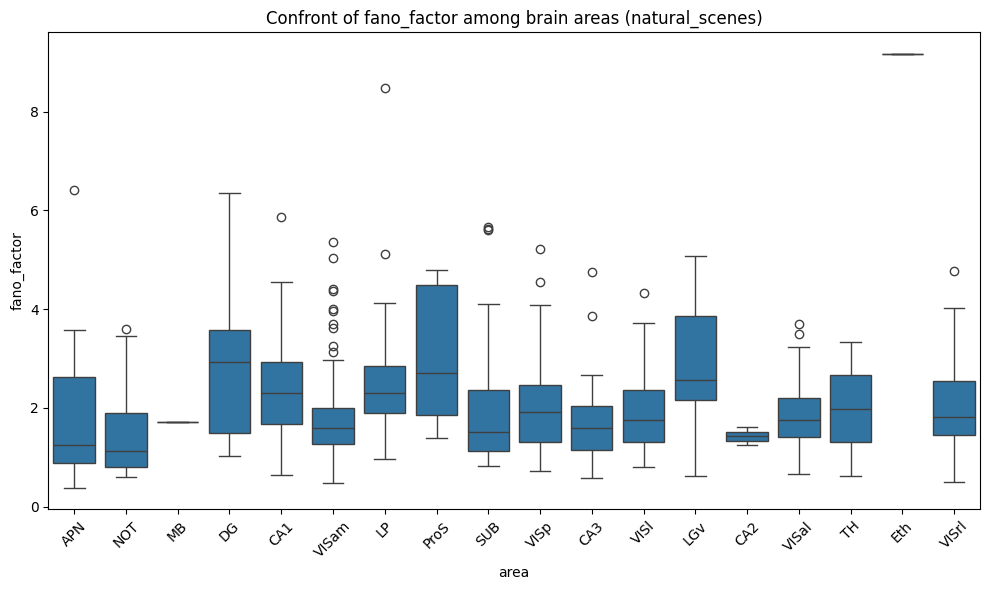

In [98]:
# ANOVA: fano_factor
metric = 'fano_factor'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.18725551664829254
Area: NOT, p-value: 1.2578685527842026e-05
Area: MB, p-value: nan
Area: DG, p-value: 0.0007225159788504243
Area: CA1, p-value: 0.17784184217453003
Area: VISam, p-value: 4.382961265037011e-07
Area: LP, p-value: 1.7604693744455169e-12
Area: ProS, p-value: 0.3193879723548889
Area: SUB, p-value: 1.7432234544756398e-09
Area: VISp, p-value: 0.003548408392816782
Area: CA3, p-value: 0.0011609061621129513
Area: VISl, p-value: 2.2160467779031023e-05
Area: LGv, p-value: 0.6695823073387146
Area: CA2, p-value: nan
Area: VISal, p-value: 2.7268589608553384e-09
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 4.07676361646736e-06

Risult of homogeneity of variance (Levene): p-value = 1.7503390647239305e-06

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 166.80541287244932, p-value = 1.2041909067924769e-26


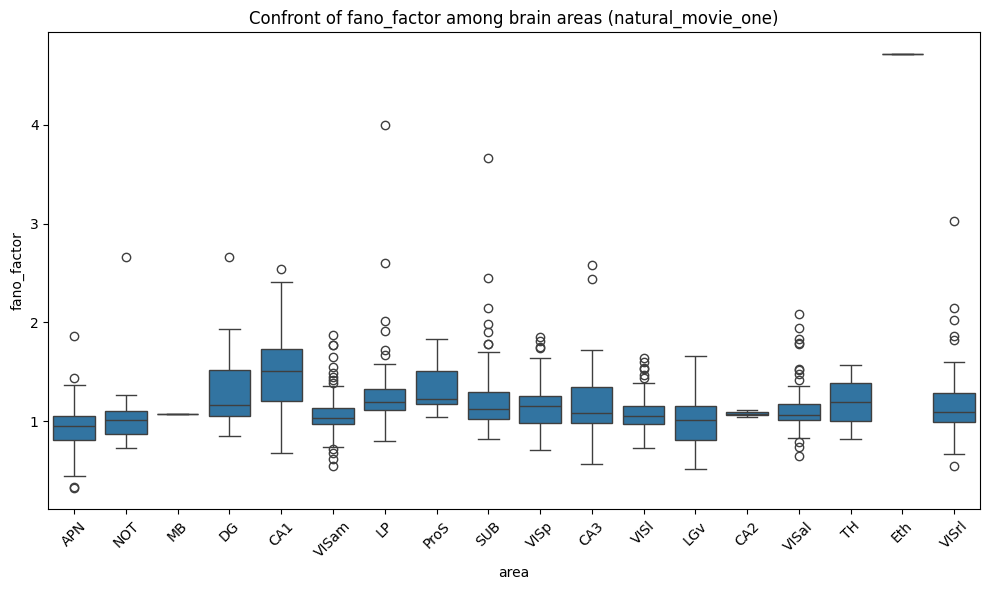

In [99]:
# ANOVA: fano factor
metric = 'fano_factor'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.09121230989694595
Area: NOT, p-value: 0.37719377875328064
Area: MB, p-value: nan
Area: DG, p-value: 0.02943469025194645
Area: CA1, p-value: 1.34367601489771e-08
Area: VISam, p-value: 2.412891626590863e-05
Area: LP, p-value: 0.33839553594589233
Area: ProS, p-value: 0.8066890835762024
Area: SUB, p-value: 0.18394532799720764
Area: VISp, p-value: 0.0005549552151933312
Area: CA3, p-value: 0.30007389187812805
Area: VISl, p-value: 0.0007593195186927915
Area: LGv, p-value: 0.14453592896461487
Area: CA2, p-value: nan
Area: VISal, p-value: 0.3135572671890259
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.12435044348239899

Risult of homogeneity of variance (Levene): p-value = 0.00021108727301163136

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 64.61952522737647, p-value = 1.7814673674795633e-07


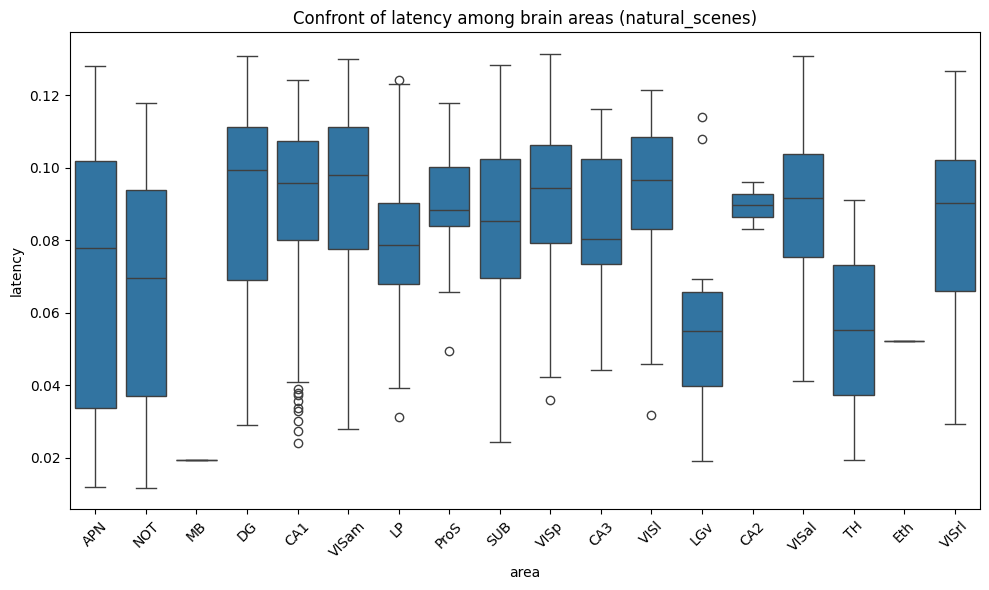

In [100]:
# ANOVA: latency
metric = 'latency'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.03798286244273186
Area: NOT, p-value: 0.4493917226791382
Area: MB, p-value: nan
Area: DG, p-value: 0.015163087286055088
Area: CA1, p-value: 0.00044968121801503
Area: VISam, p-value: 0.0016482298960909247
Area: LP, p-value: 7.341699983953731e-06
Area: ProS, p-value: 0.41151466965675354
Area: SUB, p-value: 6.464281909757119e-08
Area: VISp, p-value: 1.8262783214595402e-06
Area: CA3, p-value: 9.980497998185456e-05
Area: VISl, p-value: 2.972170477733016e-06
Area: LGv, p-value: 0.25454866886138916
Area: CA2, p-value: nan
Area: VISal, p-value: 1.2147665074735414e-05
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.00037734719808213413

Risult of omogeneity of variance (Levene): p-value = 0.004322553517074821

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 155.4945757115638, p-value = 2.047119042085101e-24


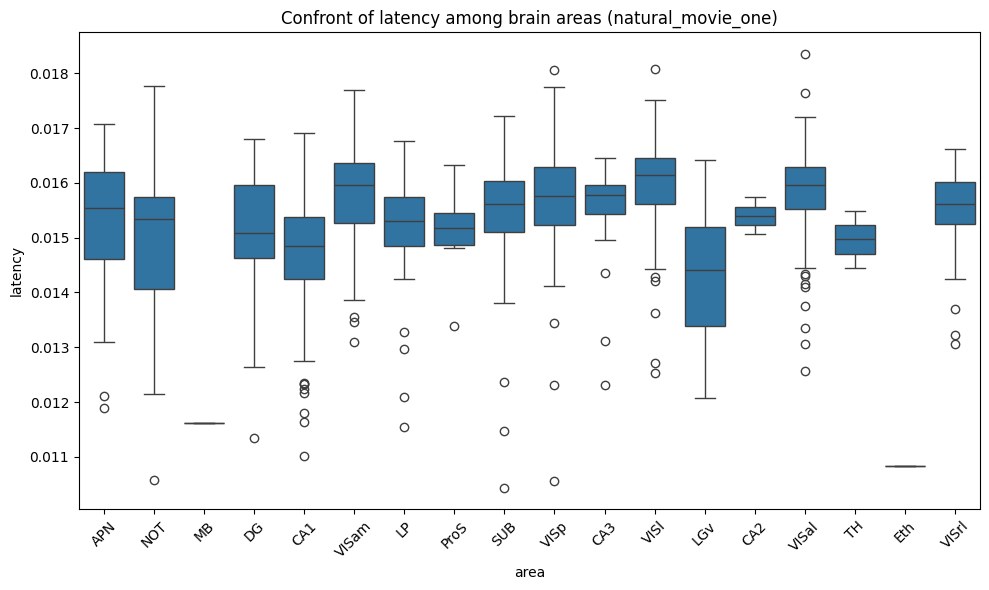

In [101]:
# ANOVA: latency
metric = 'latency'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics[df_metrics['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of omogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

We repeat this process by taking only the first time a stimulus is shown. We do this to assess if any adaptation or learning effect has occurred. 

In [102]:
stimuli = {
    'natural_scenes': session.stimulus_presentations
                              .query("stimulus_name == 'natural_scenes' and duration > 0")
                              [lambda df: df['frame'] != -1]  # boolean indexing to exclude -1
                              .groupby('frame')
                              .first()
                              .reset_index(),
    'natural_movie_one': session.stimulus_presentations
                                 .query("stimulus_name == 'natural_movie_one' and duration > 0")
                                 [lambda df: df['frame'] != -1]  # boolean indexing to exclude -1
                                 .groupby('frame')
                                 .first()
                                 .reset_index()
}


units = session.units
results = []

# Loop on stimuli
for stim_name, stim_df in stimuli.items():
    for unit_id, unit in tqdm(units.iterrows(), total=len(units)):
        spike_times = session.spike_times[unit_id]
        area = unit['structure_acronym']

        spike_counts = []
        latencies = []

        for _, row in stim_df.iterrows():
            start = row['start_time']
            end = row['stop_time']
            spikes = spike_times[(spike_times >= start) & (spike_times <= end)]
            spike_counts.append(len(spikes))
            if len(spikes) > 0:
                latencies.append(spikes[0] - start)

        spike_counts = np.array(spike_counts)
        duration = stim_df['duration'].sum()

        firing_rate = spike_counts.sum() / duration if duration > 0 else np.nan
        fano = np.var(spike_counts) / np.mean(spike_counts) if np.mean(spike_counts) > 0 else np.nan
        latency = np.mean(latencies) if len(latencies) > 0 else np.nan

        results.append({
            'unit_id': unit_id,
            'area': area,
            'stimulus': stim_name,
            'firing_rate': firing_rate,
            'fano_factor': fano,
            'latency': latency
        })

df_metrics1 = pd.DataFrame(results)

100%|██████████| 825/825 [02:38<00:00,  5.21it/s]


In [103]:
df_metrics1.head()

,unit_id,area,stimulus,firing_rate,fano_factor,latency
0,951088679,APN,natural_scenes,12.159307,0.848992,0.057333
1,951088664,APN,natural_scenes,11.075469,0.999456,0.069690
2,951088734,APN,natural_scenes,0.575789,1.679462,0.095080
3,951088721,APN,natural_scenes,10.296460,1.292150,0.069147
4,951088862,APN,natural_scenes,20.017132,0.590510,0.043055


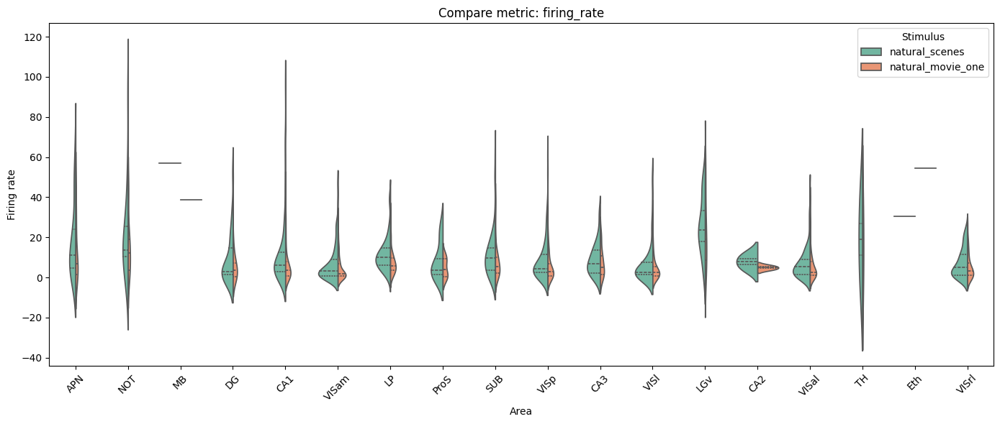

In [104]:
# visualise metrics: firing rate
metric = "firing_rate"  

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics1,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

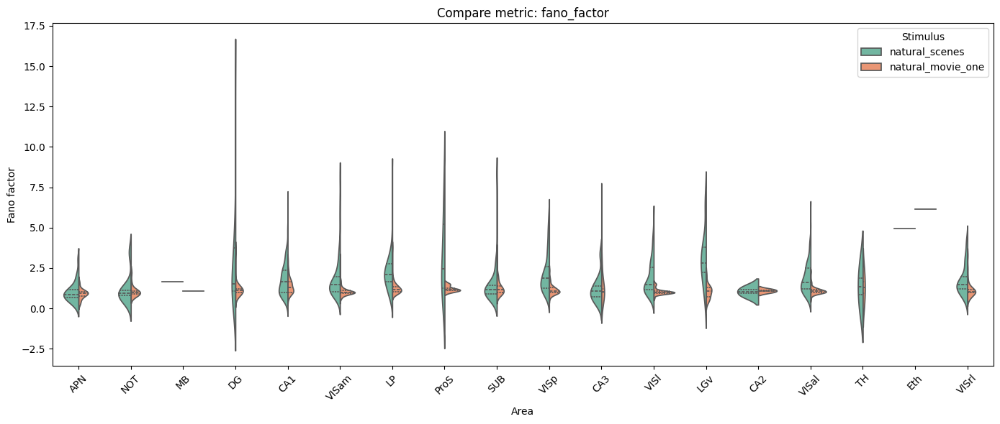

In [105]:
# visualise metrics: fano factor
metric = "fano_factor"  

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics1,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

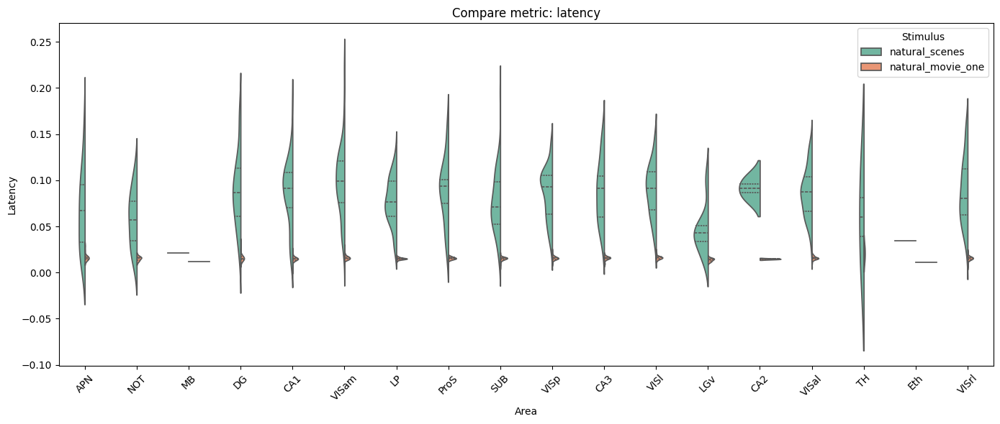

In [106]:
# visualise metrics: latency
metric = "latency"  

plt.figure(figsize=(14, 6))
sns.violinplot(
    data=df_metrics1,
    x="area",
    y=metric,
    hue="stimulus",
    split=True,
    inner="quartile",
    palette="Set2"
)
plt.title(f'Compare metric: {metric}')
plt.xticks(rotation=45)
plt.ylabel(metric.replace("_", " ").capitalize())
plt.xlabel("Area")
plt.legend(title="Stimulus")
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.0013350116787478328
Area: NOT, p-value: 0.0014529003528878093
Area: MB, p-value: nan
Area: DG, p-value: 2.6691645871324e-06
Area: CA1, p-value: 3.594925883364274e-16
Area: VISam, p-value: 5.886577439688165e-14
Area: LP, p-value: 1.8282897826793487e-06
Area: ProS, p-value: 0.03697650507092476
Area: SUB, p-value: 7.118941169892423e-08
Area: VISp, p-value: 6.492562130283597e-12
Area: CA3, p-value: 0.01447729580104351
Area: VISl, p-value: 7.734998080412281e-13
Area: LGv, p-value: 0.39144665002822876
Area: CA2, p-value: nan
Area: VISal, p-value: 2.4996929526288625e-10
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.00010475389717612416

Risult of homogeneity of variance (Levene): p-value = 0.0011652666177936716

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 98.86953163651158, p-value = 1.4404846561064935e-13


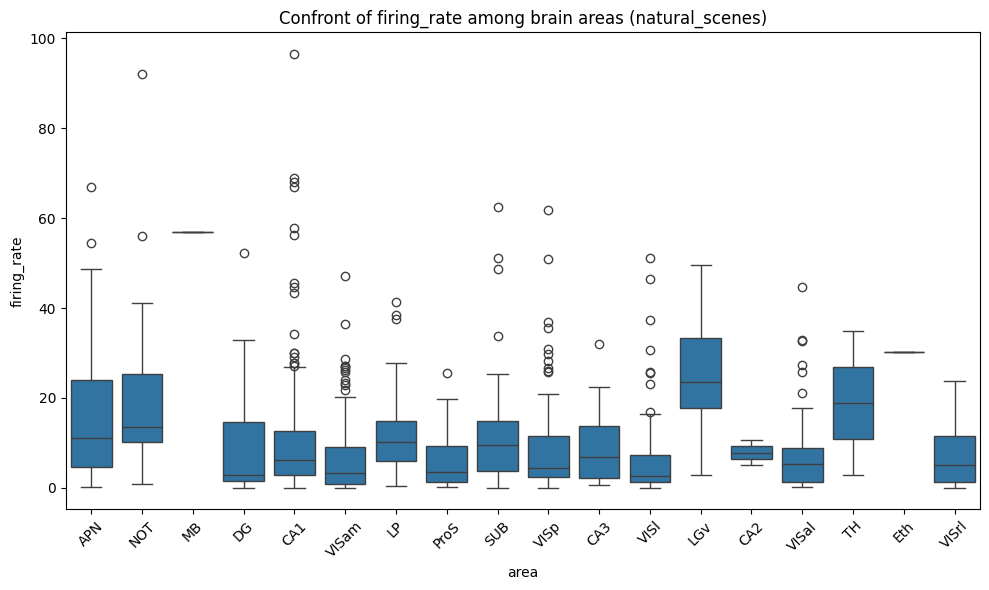

In [107]:
# ANOVA: firing rate
metric = 'firing_rate'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.00031305509037338197
Area: NOT, p-value: 0.015187811106443405
Area: MB, p-value: nan
Area: DG, p-value: 5.891801535540253e-08
Area: CA1, p-value: 1.480949525067398e-14
Area: VISam, p-value: 4.065278387359317e-14
Area: LP, p-value: 2.1009723241149914e-06
Area: ProS, p-value: 0.05722038447856903
Area: SUB, p-value: 6.383348516436627e-09
Area: VISp, p-value: 2.4922005106321754e-13
Area: CA3, p-value: 0.013995381072163582
Area: VISl, p-value: 1.797514220802654e-11
Area: LGv, p-value: 0.07741835713386536
Area: CA2, p-value: nan
Area: VISal, p-value: 6.026103227529944e-12
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 1.6880112525541335e-06

Risult of omogeneity of variance (Levene): p-value = 8.290669856045199e-09

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 73.34257961154009, p-value = 5.68800786780726e-09


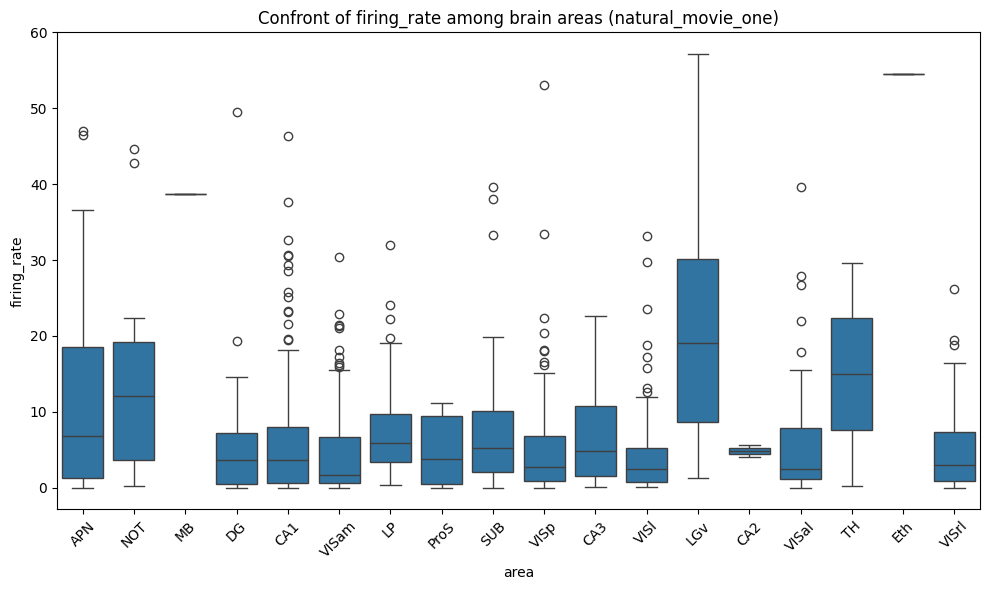

In [108]:
# ANOVA: firing rate
metric = 'firing_rate'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of omogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.006388855632394552
Area: NOT, p-value: 7.936984911793843e-05
Area: MB, p-value: nan
Area: DG, p-value: 1.5532942825302598e-06
Area: CA1, p-value: 1.3552609345879318e-07
Area: VISam, p-value: 1.2710814930975978e-13
Area: LP, p-value: 1.8921313937880768e-07
Area: ProS, p-value: 0.24184827506542206
Area: SUB, p-value: 4.30694412426047e-12
Area: VISp, p-value: 5.7221349436531455e-08
Area: CA3, p-value: 0.0036477544344961643
Area: VISl, p-value: 1.1080720696554636e-06
Area: LGv, p-value: 0.20590758323669434
Area: CA2, p-value: nan
Area: VISal, p-value: 5.978895842417842e-06
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.0002497974783182144

Risult of homogeneity of variance (Levene): p-value = 2.3131952535762583e-06

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 104.05647459024338, p-value = 1.5669895991824123e-14


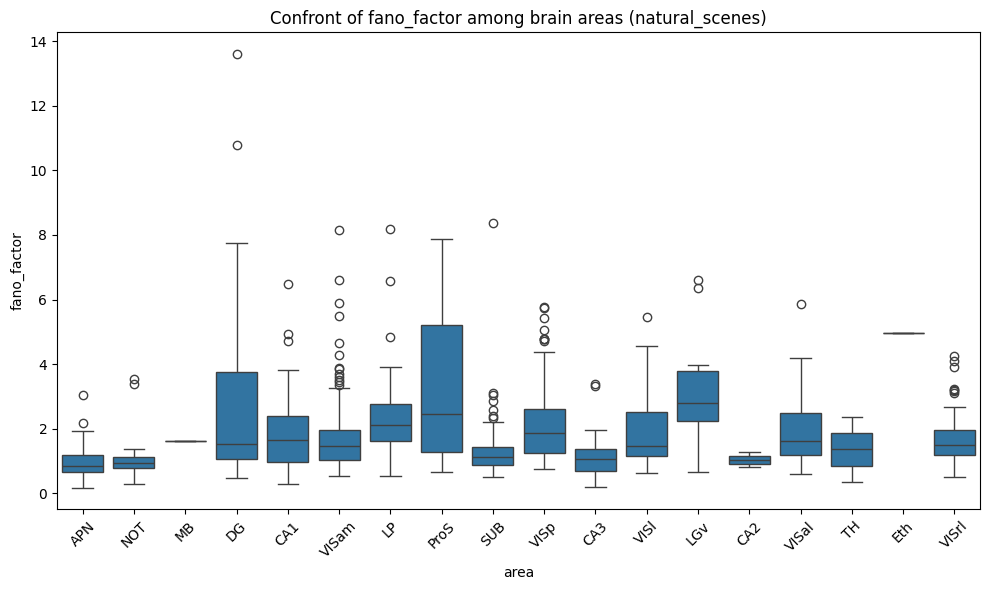

In [109]:
# ANOVA: fano factor
metric = 'fano_factor'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:  
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.23996976017951965
Area: NOT, p-value: 0.0001688184420345351
Area: MB, p-value: nan
Area: DG, p-value: 3.526768210804221e-08
Area: CA1, p-value: 5.9036128732259385e-06
Area: VISam, p-value: 4.809988399332582e-15
Area: LP, p-value: 1.809176419786951e-11
Area: ProS, p-value: 0.015015877783298492
Area: SUB, p-value: 1.1564368662675406e-07
Area: VISp, p-value: 6.972164356966459e-08
Area: CA3, p-value: 1.596592028363375e-06
Area: VISl, p-value: 5.540990244412569e-08
Area: LGv, p-value: 0.43515026569366455
Area: CA2, p-value: nan
Area: VISal, p-value: 9.939419953752804e-09
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 2.6466704383665274e-08

Risult of homogeneity of variance (Levene): p-value = 5.031573791484934e-10

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 112.430361611582, p-value = 4.2038229447797107e-16


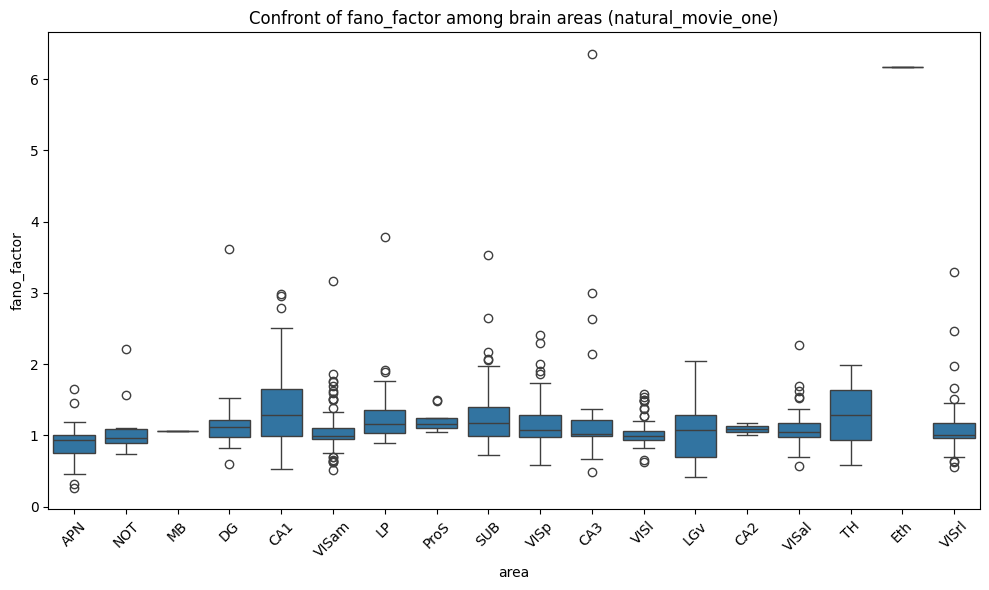

In [110]:
# ANOVA: fano factor
metric = 'fano_factor'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.16916242241859436
Area: NOT, p-value: 0.8233872652053833
Area: MB, p-value: nan
Area: DG, p-value: 0.5696642994880676
Area: CA1, p-value: 0.006896483711898327
Area: VISam, p-value: 0.009470601566135883
Area: LP, p-value: 0.48512697219848633
Area: ProS, p-value: 0.45601147413253784
Area: SUB, p-value: 0.05409747362136841
Area: VISp, p-value: 0.012440145015716553
Area: CA3, p-value: 0.6221176981925964
Area: VISl, p-value: 0.6739703416824341
Area: LGv, p-value: 0.015085340477526188
Area: CA2, p-value: nan
Area: VISal, p-value: 0.5963364243507385
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.1392711102962494

Risult of homogeneity of variance (Levene): p-value = 0.008200673023876231

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 72.82521548016484, p-value = 6.9980977188822245e-09


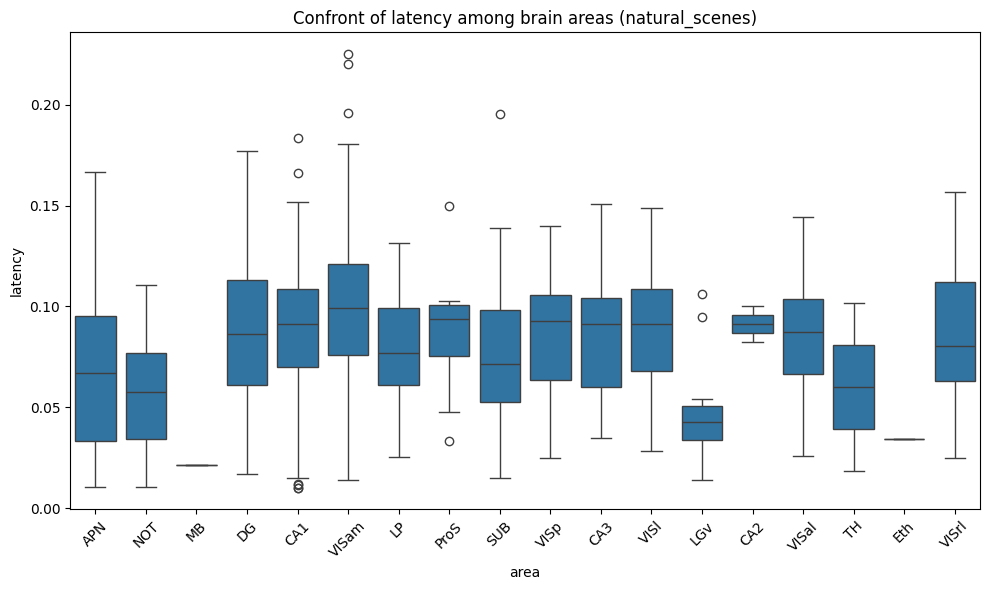

In [111]:
# ANOVA: latency
metric = 'latency'  

stimulus_type = 'natural_scenes'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality test with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Result of normality test: (Shapiro-Wilk):
Area: APN, p-value: 0.0001507808337919414
Area: NOT, p-value: 0.9003393054008484
Area: MB, p-value: nan
Area: DG, p-value: 5.269607754598837e-06
Area: CA1, p-value: 2.5804455461297948e-08
Area: VISam, p-value: 1.7141633890105368e-08
Area: LP, p-value: 0.3995231091976166
Area: ProS, p-value: 0.9942065477371216
Area: SUB, p-value: 2.7315772399560956e-07
Area: VISp, p-value: 0.0006038944120518863
Area: CA3, p-value: 0.002228868892416358
Area: VISl, p-value: 4.5000462705502287e-05
Area: LGv, p-value: 0.6860644221305847
Area: CA2, p-value: nan
Area: VISal, p-value: 4.0782153519103304e-05
Area: TH, p-value: nan
Area: Eth, p-value: nan
Area: VISrl, p-value: 0.00010359155567130074

Risult of homogeneity of variance (Levene): p-value = 0.006006157808158662

We proceed with Kruskal-Wallis.
Statistics Kruskal-Wallis: H = 55.59727848879629, p-value = 5.492475933883837e-06


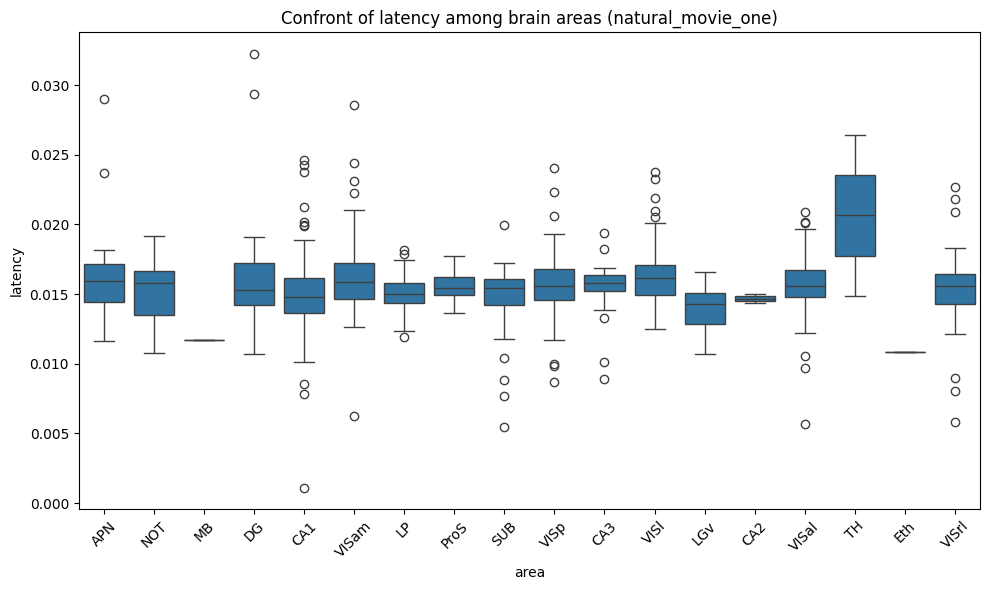

In [112]:
# ANOVA: latency
metric = 'latency'  

stimulus_type = 'natural_movie_one'
df_filtered = df_metrics1[df_metrics1['stimulus'] == stimulus_type]

df_filtered = df_filtered.dropna(subset=[metric])


# normality with Shapiro-Wilk
normality_results = {}
for area in df_filtered['area'].unique():
    data = df_filtered[df_filtered['area'] == area][metric]
    if len(data) >= 3:  # Shapiro-Wilk richiede almeno 3 valori
        stat, p = stats.shapiro(data)
        normality_results[area] = p
    else:
        normality_results[area] = np.nan

# homogeneity of variance with Levene
grouped_data = [df_filtered[df_filtered['area'] == area][metric] for area in df_filtered['area'].unique()]
stat, p_levene = stats.levene(*grouped_data)


normality_pass = all(p > 0.05 for p in normality_results.values() if not np.isnan(p))
homogeneity_pass = p_levene > 0.05

print("Result of normality test: (Shapiro-Wilk):")
for area, p in normality_results.items():
    print(f"Area: {area}, p-value: {p}")

print(f"\nRisult of homogeneity of variance (Levene): p-value = {p_levene}")

# statistical analysis
if normality_pass and homogeneity_pass:
    print("\nWe can proceed with ANOVA.")
    anova_stat, anova_p = stats.f_oneway(*grouped_data)
    print(f"Statistics ANOVA: F = {anova_stat}, p-value = {anova_p}")
else:
    print("\nWe proceed with Kruskal-Wallis.")
    kw_stat, kw_p = stats.kruskal(*grouped_data)
    print(f"Statistics Kruskal-Wallis: H = {kw_stat}, p-value = {kw_p}")

# plots
plt.figure(figsize=(10, 6))
sns.boxplot(x='area', y=metric, data=df_filtered)
plt.title(f'Confront of {metric} among brain areas ({stimulus_type})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The results are similar and don't show any evident difference between taking all the stimuli or the first time they are shown only. However, all Kruskal-Wallis tests show that there is a statistical difference in how different areas of the brain react to the stimuli. We continue or analysis by investigating the difference between static images and movies in the areas of the brain. We use the metrics we computed before. We perform Wilcoxon test to assess if there's a difference in the distribution of the metrics.

In [113]:
metrics = ['firing_rate', 'fano_factor', 'latency']
areas = df_metrics['area'].unique()

wilcoxon_results = []

for metric in metrics:
    for area in areas:
        data_area = df_metrics[df_metrics['area'] == area]
        scenes = data_area[data_area['stimulus'] == 'natural_scenes']
        movie = data_area[data_area['stimulus'] == 'natural_movie_one']

        common_units = np.intersect1d(scenes['unit_id'], movie['unit_id'])
        scenes_vals = scenes[scenes['unit_id'].isin(common_units)].sort_values('unit_id')[metric].values
        movie_vals = movie[movie['unit_id'].isin(common_units)].sort_values('unit_id')[metric].values

        if len(common_units) < 5:
            continue

        stat, p = wilcoxon(scenes_vals, movie_vals, zero_method='wilcox', correction=False)

        wilcoxon_results.append({
            'area': area,
            'metric': metric,
            'statistic': stat,
            'p_value': p,
            'n_units': len(common_units)
        })

df_wilcoxon = pd.DataFrame(wilcoxon_results)
df_wilcoxon.sort_values('p_value', inplace=True)
display(df_wilcoxon)

,area,metric,statistic,p_value,n_units
32,VISam,latency,0.0,6.714005e-24,135
31,CA1,latency,0.0,9.804435e-24,134
18,VISam,fano_factor,119.0,9.280410e-23,135
17,CA1,fano_factor,188.0,6.205511e-22,134
36,VISp,latency,0.0,3.809732e-17,94
22,VISp,fano_factor,31.0,1.026215e-16,94
40,VISal,latency,0.0,2.550973e-16,89
26,VISal,fano_factor,35.0,8.302371e-16,89
41,VISrl,latency,0.0,1.421085e-14,47
38,VISl,latency,0.0,1.682175e-14,78


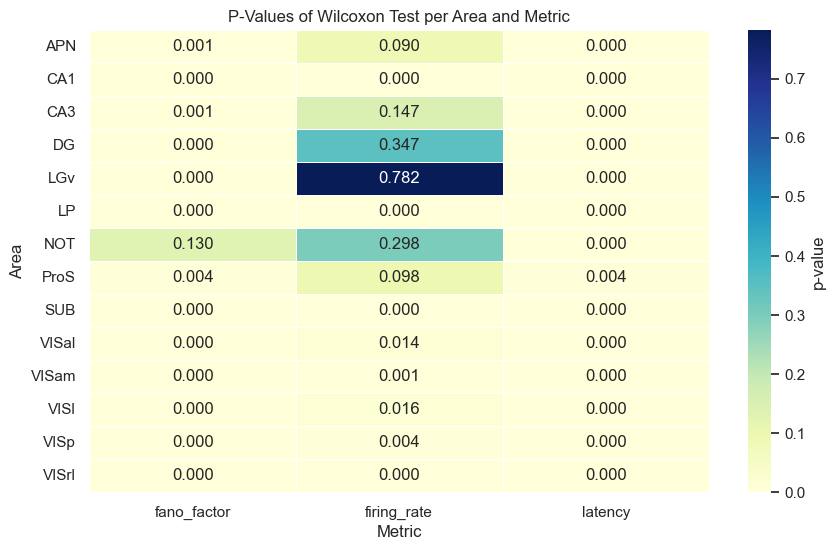

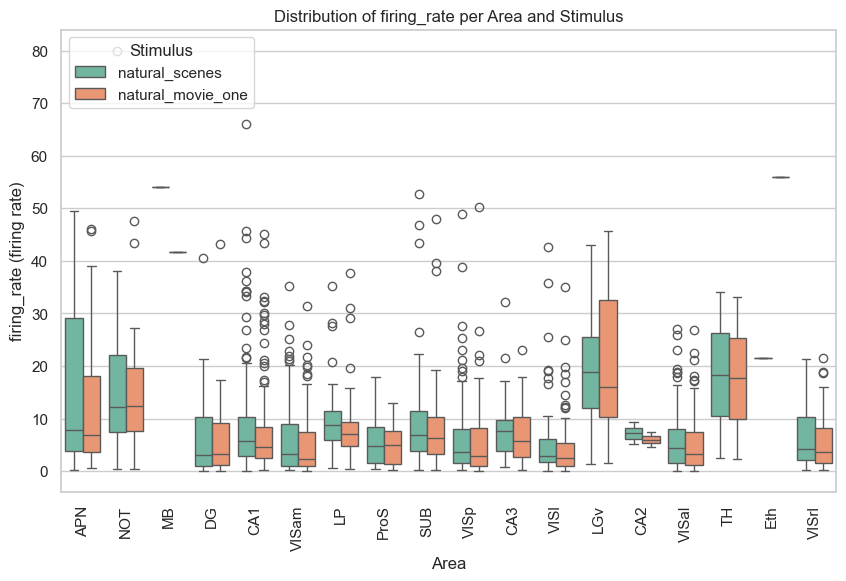

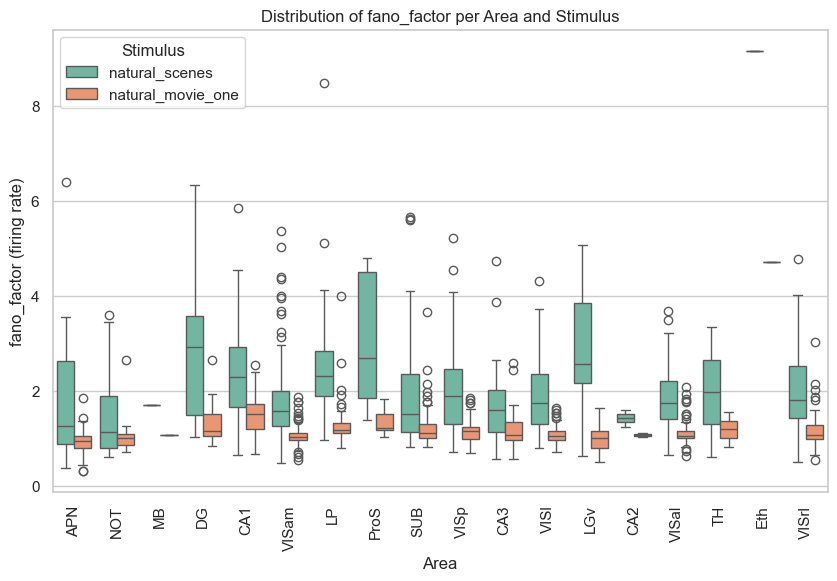

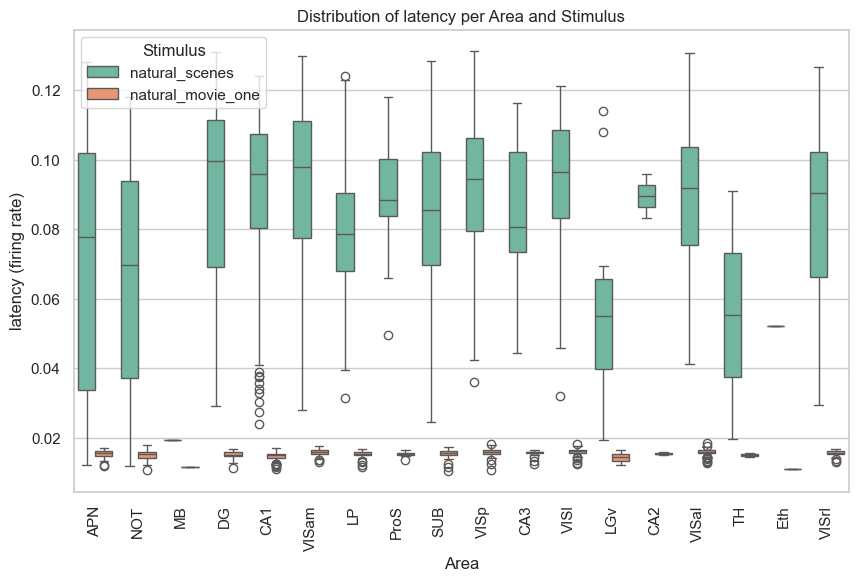

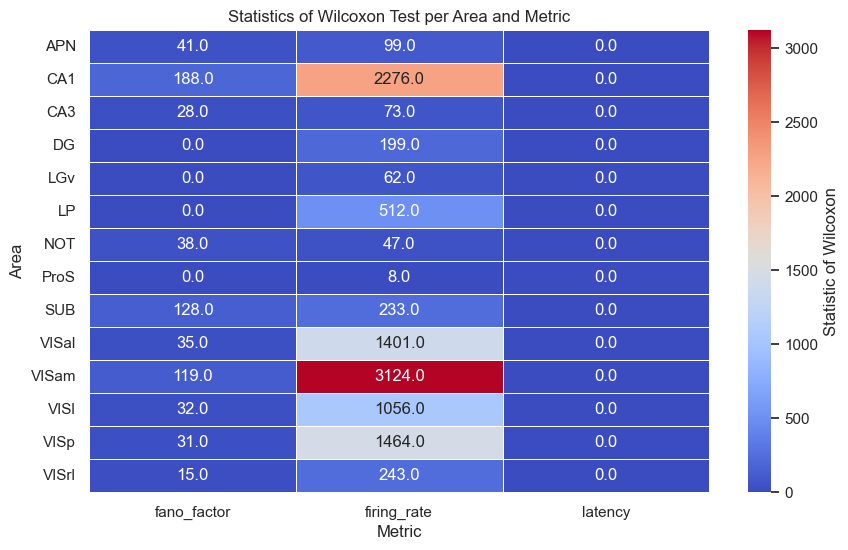

In [114]:
sns.set_theme(style="whitegrid")

# Visualize P-value
df_p_values = df_wilcoxon.pivot_table(index='area', columns='metric', values='p_value')

plt.figure(figsize=(10, 6))
sns.heatmap(df_p_values, annot=True, cmap='YlGnBu', cbar_kws={'label': 'p-value'}, fmt='.3f', linewidths=0.5)
plt.title('P-Values of Wilcoxon Test per Area and Metric')
plt.xlabel('Metric')
plt.ylabel('Area')
plt.show()

# Boxplot for the distributions
metric = 'firing_rate'
for metric in metrics:
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_metrics, x='area', y=metric, hue='stimulus', palette='Set2')
    plt.title(f'Distribution of {metric} per Area and Stimulus')
    plt.xlabel('Area')
    plt.ylabel(f'{metric} (firing rate)')
    plt.legend(title='Stimulus', loc='upper left')
    plt.xticks(rotation=90)
    plt.show()

# Heatmap of Wilcoxon statistics
df_statistic = df_wilcoxon.pivot_table(index='area', columns='metric', values='statistic')

plt.figure(figsize=(10, 6))
sns.heatmap(df_statistic, annot=True, cmap='coolwarm', fmt='.1f', cbar_kws={'label': 'Statistic of Wilcoxon'}, linewidths=0.5)
plt.title('Statistics of Wilcoxon Test per Area and Metric')
plt.xlabel('Metric')
plt.ylabel('Area')
plt.show()

Our interpretation of these results is the following:
- **firing rate**: the differences are less visible then in the other metrics. However in *CA1*, *VISam* and *VISp* we observe a p-value < 0.01, which indicates a statistical difference. Hence, there seems to be a difference in the intensity of the neural response but more area-specific.
- **fano factor**: the effects seem more widespread. Areas including *VISam*, *VISp*, *VISal*, *CA1*, and *SUB* showed highly significant difference.This suggests that visual movies tend to alter not just the magnitude but also the consistency or reliability of neural responses. Dynamic stimuli seem to reduce response variability.
- **latency**: in nearly all cases, latency values were significantly different between the two stimulus types, indicating that temporal dynamics of the stimulus may profoundly shift the timing of neuronal activation.

Neuronal responses to static images and dynamic movies differ significantly across multiple brain areas. The most pronounced effect were observed in visual and associative regions. These findings suggest that dynamic stimuli modulate not only the strength but also the timing and reliability of neural responses, highlighting the importance of temporal structure in sensory processing. 

We continue our analysis on different resposes to the stimuli with some visualization.

In [115]:
df_metrics['area'].unique()

array(['APN', 'NOT', 'MB', 'DG', 'CA1', 'VISam', 'LP', 'ProS', 'SUB',
       'VISp', 'CA3', 'VISl', 'LGv', 'CA2', 'VISal', 'TH', 'Eth', 'VISrl'],
      dtype=object)

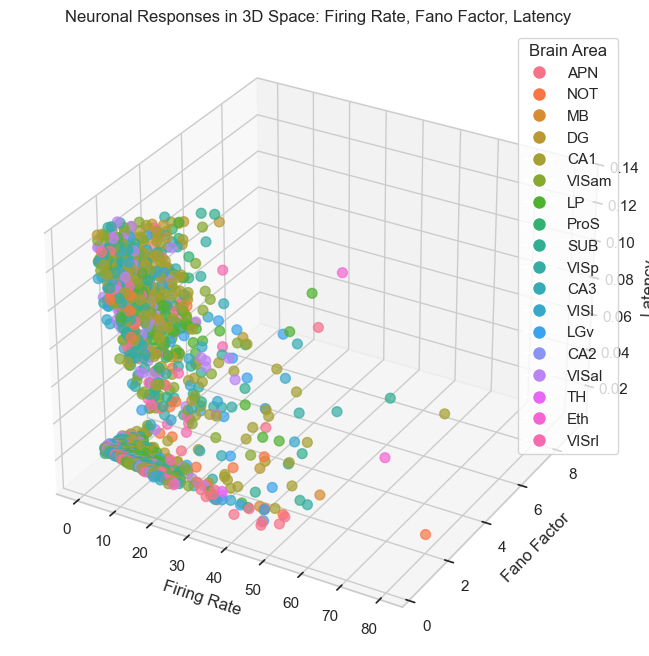

In [116]:
x = df_metrics['firing_rate']
y = df_metrics['fano_factor']
z = df_metrics['latency']

areas = df_metrics['area'].unique()
colors = sns.color_palette("husl", n_colors=len(areas))
area_palette = {area: colors[i] for i, area in enumerate(areas)}

df_metrics['area_color'] = df_metrics['area'].map(area_palette)
colors = df_metrics['area_color']

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(x, y, z, c=colors, s=50, alpha=0.7)

ax.set_xlabel('Firing Rate')
ax.set_ylabel('Fano Factor')
ax.set_zlabel('Latency')


handles = [plt.Line2D([0], [0], marker='o', color='w', label=area, markerfacecolor=area_palette[area], markersize=10) for area in areas]
ax.legend(handles=handles, title="Brain Area")

plt.title('Neuronal Responses in 3D Space: Firing Rate, Fano Factor, Latency')
plt.show()

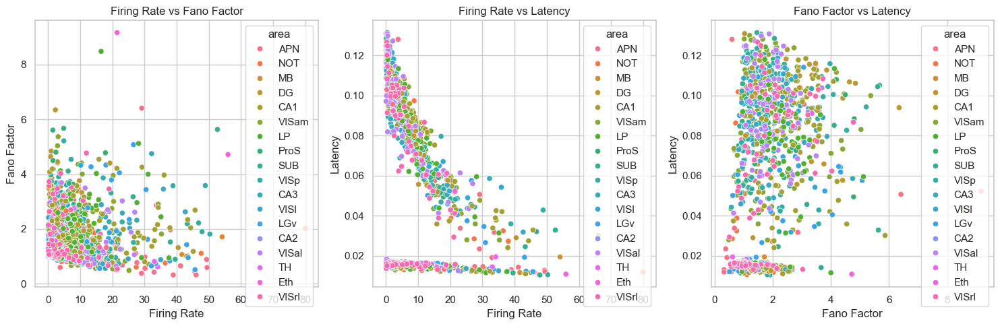

In [148]:
sns.set_theme(style="whitegrid")
areas = df_metrics['area'].unique()
colors = sns.color_palette("husl", n_colors=len(areas))
area_palette = {area: colors[i] for i, area in enumerate(areas)}

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Firing rate vs Fano factor
sns.scatterplot(data=df_metrics, x='firing_rate', y='fano_factor', hue='area', palette=area_palette, ax=axes[0])
axes[0].set_title("Firing Rate vs Fano Factor")
axes[0].set_xlabel("Firing Rate")
axes[0].set_ylabel("Fano Factor")

# Firing rate vs Latency
sns.scatterplot(data=df_metrics, x='firing_rate', y='latency', hue='area', palette=area_palette, ax=axes[1])
axes[1].set_title("Firing Rate vs Latency")
axes[1].set_xlabel("Firing Rate")
axes[1].set_ylabel("Latency")

# Fano factor vs Latency
sns.scatterplot(data=df_metrics, x='fano_factor', y='latency', hue='area', palette=area_palette, ax=axes[2])
axes[2].set_title("Fano Factor vs Latency")
axes[2].set_xlabel("Fano Factor")
axes[2].set_ylabel("Latency")

plt.tight_layout()
plt.show()

In [118]:
grouped_areas = {
    'Visual Cortex': ['VISam', 'VISp', 'VISl', 'VISrl', 'VISal'],
    'Hippocampal Formation': ['CA1', 'CA2', 'CA3', 'DG'],
    'Subcortical Areas': ['LP', 'APN', 'SUB', 'ProS'],
    'Other': ['NOT', 'MB', 'TH', 'Eth', 'LGv']
}

area_to_group = {}
for group, areas in grouped_areas.items():
    for area in areas:
        area_to_group[area] = group
        
df_metrics['group'] = df_metrics['area'].map(area_to_group)

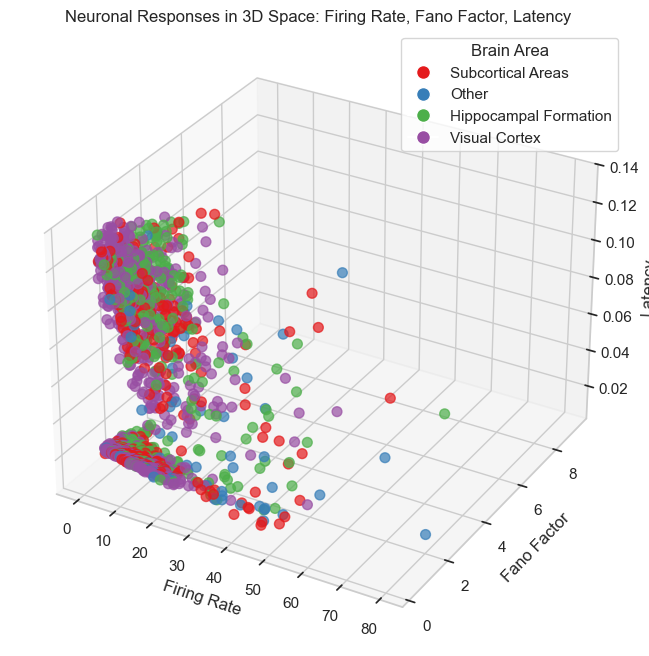

In [119]:
x = df_metrics['firing_rate']
y = df_metrics['fano_factor']
z = df_metrics['latency']

group_areas = df_metrics['group'].unique()
group_colors = sns.color_palette("Set1", n_colors=len(group_areas))
group_palette = {group: group_colors[i] for i, group in enumerate(group_areas)}

df_metrics['group_color'] = df_metrics['group'].map(group_palette)
colors = df_metrics['group_color']

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(x, y, z, c=colors, s=50, alpha=0.7)

ax.set_xlabel('Firing Rate')
ax.set_ylabel('Fano Factor')
ax.set_zlabel('Latency')

handles = [plt.Line2D([0], [0], marker='o', color='w', label=area, markerfacecolor=group_palette[area], markersize=10) for area in group_areas]
ax.legend(handles=handles, title="Brain Area")

plt.title('Neuronal Responses in 3D Space: Firing Rate, Fano Factor, Latency')
plt.show()

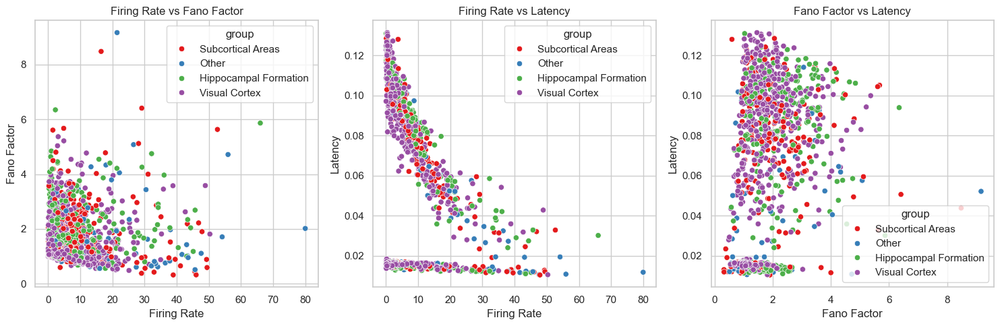

In [147]:
sns.set_theme(style="whitegrid")
group_areas = df_metrics['group'].unique()
group_colors = sns.color_palette("Set1", n_colors=len(group_areas))
group_palette = {group: group_colors[i] for i, group in enumerate(group_areas)}

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Firing rate vs Fano factor
sns.scatterplot(data=df_metrics, x='firing_rate', y='fano_factor', hue='group', palette=group_palette, ax=axes[0])
axes[0].set_title("Firing Rate vs Fano Factor")
axes[0].set_xlabel("Firing Rate")
axes[0].set_ylabel("Fano Factor")

# Firing rate vs Latency
sns.scatterplot(data=df_metrics, x='firing_rate', y='latency', hue='group', palette=group_palette, ax=axes[1])
axes[1].set_title("Firing Rate vs Latency")
axes[1].set_xlabel("Firing Rate")
axes[1].set_ylabel("Latency")

# Fano factor vs Latency
sns.scatterplot(data=df_metrics, x='fano_factor', y='latency', hue='group', palette=group_palette, ax=axes[2])
axes[2].set_title("Fano Factor vs Latency")
axes[2].set_xlabel("Fano Factor")
axes[2].set_ylabel("Latency")

plt.tight_layout()
plt.show()

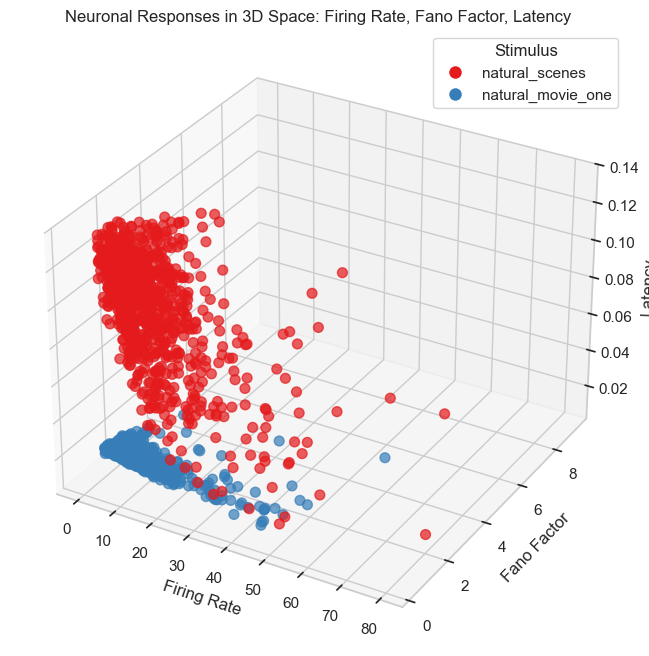

In [121]:
x = df_metrics['firing_rate']
y = df_metrics['fano_factor']
z = df_metrics['latency']

stimulus_type = df_metrics['stimulus'].unique()
stimulus_colors = sns.color_palette("Set1", n_colors=len(stimulus_type))
stimulus_palette = {stimulus: stimulus_colors[i] for i, stimulus in enumerate(stimulus_type)}

df_metrics['stimulus_color'] = df_metrics['stimulus'].map(stimulus_palette)
colors = df_metrics['stimulus_color']

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(x, y, z, c=colors, s=50, alpha=0.7)

ax.set_xlabel('Firing Rate')
ax.set_ylabel('Fano Factor')
ax.set_zlabel('Latency')

handles = [plt.Line2D([0], [0], marker='o', color='w', label=stimulus, markerfacecolor=stimulus_palette[stimulus], markersize=10) for stimulus in stimulus_type]
ax.legend(handles=handles, title="Stimulus")

plt.title('Neuronal Responses in 3D Space: Firing Rate, Fano Factor, Latency')
plt.show()

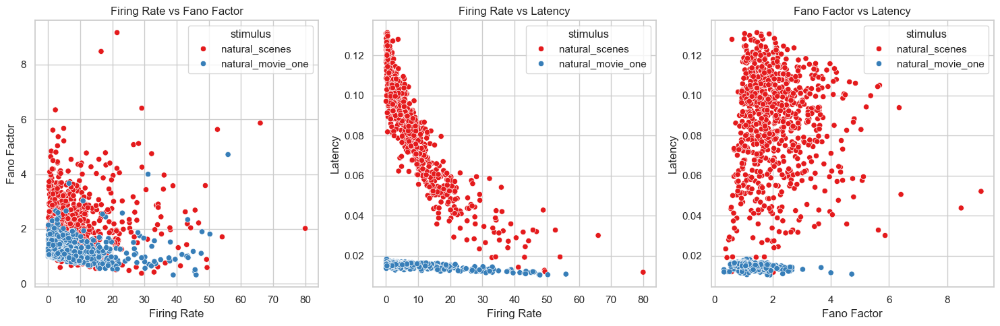

In [ ]:
sns.set_theme(style="whitegrid")
stimulus_type = df_metrics['stimulus'].unique()
stimulus_colors = sns.color_palette("Set1", n_colors=len(stimulus_type))
stimulus_palette = {stimulus: stimulus_colors[i] for i, stimulus in enumerate(stimulus_type)}

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Firing rate vs Fano factor
sns.scatterplot(data=df_metrics, x='firing_rate', y='fano_factor', hue='stimulus', palette=stimulus_palette, ax=axes[0])
axes[0].set_title("Firing Rate vs Fano Factor")
axes[0].set_xlabel("Firing Rate")
axes[0].set_ylabel("Fano Factor")

# Firing rate vs Latency
sns.scatterplot(data=df_metrics, x='firing_rate', y='latency', hue='stimulus', palette=stimulus_palette, ax=axes[1])
axes[1].set_title("Firing Rate vs Latency")
axes[1].set_xlabel("Firing Rate")
axes[1].set_ylabel("Latency")

# Fano factor vs Latency
sns.scatterplot(data=df_metrics, x='fano_factor', y='latency', hue='stimulus', palette=stimulus_palette, ax=axes[2])
axes[2].set_title("Fano Factor vs Latency")
axes[2].set_xlabel("Fano Factor")
axes[2].set_ylabel("Latency")

plt.tight_layout()
plt.show()

From these plots we see that neurons in the same area tend to cluster together. However we observe two clusters. We project by coloring basing on the stimulus type and observe this is the reason why. As we calculated before, the differences in response to the different types of stimuli are more evident for latency and fano factor. 

## Compare session 766640955 data

Now we move our attention to another session from the functional connectivity dataset. We care about this dataset because the movie one is shown tothe subject in two different ways: one is normal and the other has the frame shuffled. We believe this can give us interesting insights.

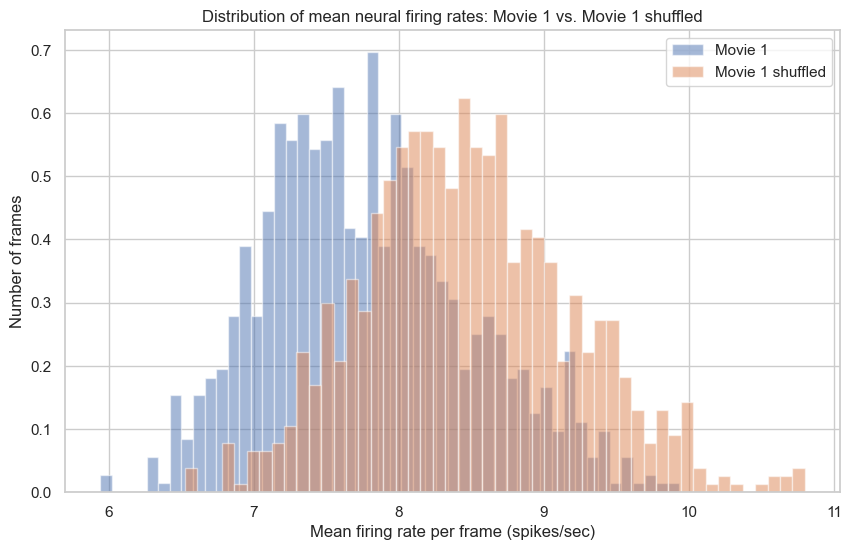

In [123]:
# average responses (across all units) for each frame
movie1rep_frame_rates = np.array([resp.values.flatten().mean() for resp in movie1rep_resp_by_frame.values()])
movie1shu_frame_rates = np.array([resp.values.flatten().mean() for resp in movie1shu_resp_by_frame.values()])

plt.figure(figsize=(10, 6))
plt.hist(movie1rep_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 1')
plt.hist(movie1shu_frame_rates, bins=50, alpha=0.5, density=True, label='Movie 1 shuffled')
plt.xlabel('Mean firing rate per frame (spikes/sec)')
plt.ylabel('Number of frames')
plt.title('Distribution of mean neural firing rates: Movie 1 vs. Movie 1 shuffled')
plt.legend()
plt.show()

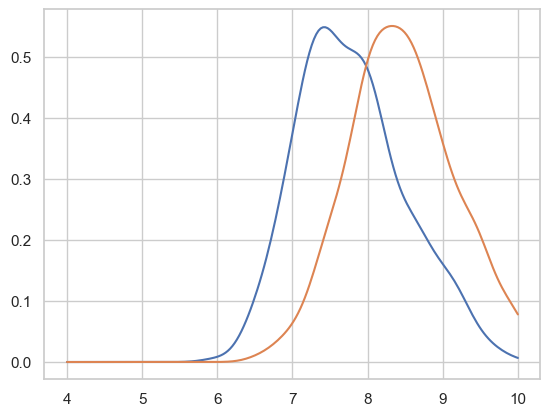

In [124]:
# using kernel density estimation instead of histogram
movie1rep_density = gaussian_kde(movie1rep_frame_rates)
movie1shu_density = gaussian_kde(movie1shu_frame_rates)
x = np.linspace(4, 10, 200)
plt.plot(x, movie1rep_density(x), label='Movie 1')
plt.plot(x, movie1shu_density(x), label='Movie 1 shuffled')

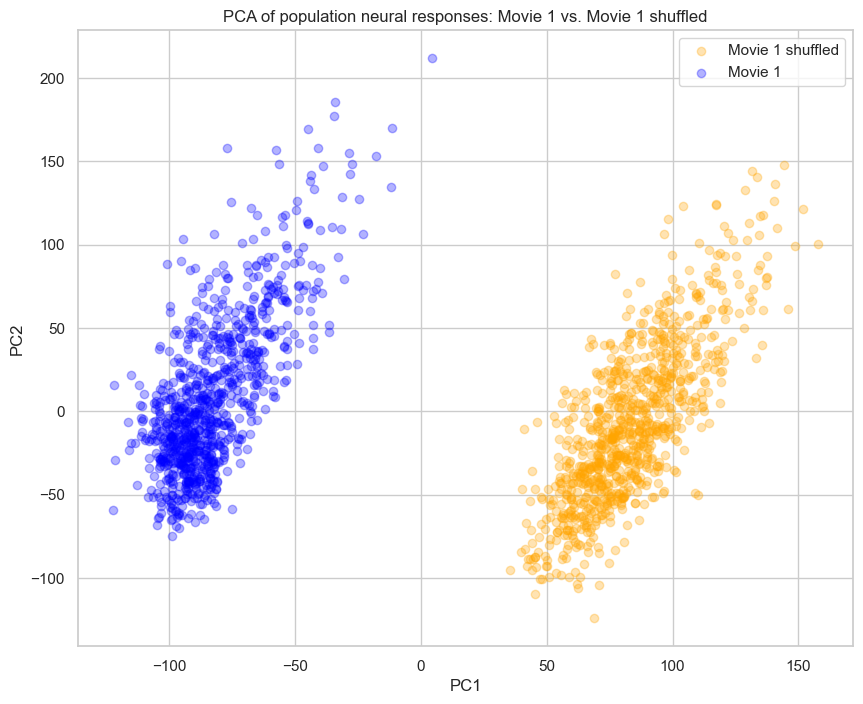

In [125]:
# feature matrices
X_movie1rep = np.array([resp.values.flatten() for resp in movie1rep_resp_by_frame.values()])
# we have a list of arrays, each array is the response of a unit to a frame
# we convert the list of arrays to a 2D array (number of frames x number of units)
X_movie1shu = np.array([resp.values.flatten() for resp in movie1shu_resp_by_frame.values()])

X = np.vstack([X_movie1rep, X_movie1shu])
y = np.array([1]*len(X_movie1rep) + [3]*len(X_movie1shu))  # 1 = movie 1, 3 = movie 3

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(10, 8))
plt.scatter(X_pca[y==3, 0], X_pca[y==3, 1], alpha=0.3, label='Movie 1 shuffled', color='orange')
plt.scatter(X_pca[y==1, 0], X_pca[y==1, 1], alpha=0.3, label='Movie 1', color='blue')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA of population neural responses: Movie 1 vs. Movie 1 shuffled')
plt.legend()
plt.show()

We observe from the PCA plot that there are two cluster based on the type of stimulus. This flags for a different response to the order the frames are shown. Neural populations encode both the content of the stimuli and the temporal structure. The similar distriibution is due to the overall content essentially being the same, however, the temporal order of how they are shown is completely disrupted in the shuffled stimuli.

In [126]:
session1.stimulus_presentations.query("stimulus_name == 'natural_movie_one_more_repeats' and duration > 0").iloc[:18000]

,stimulus_block,start_time,stop_time,contrast,spatial_frequency,coherence,y_position,phase,stimulus_name,size,Speed,orientation,color,x_position,frame,temporal_frequency,Dir,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,,,,,,
4339,3.0,2297.212884,2297.246246,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,0.0,null,null,0.033361,282
4340,3.0,2297.246246,2297.279607,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033361,283
4341,3.0,2297.279607,2297.312968,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,2.0,null,null,0.033361,284
4342,3.0,2297.312968,2297.346330,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,3.0,null,null,0.033361,285
4343,3.0,2297.346330,2297.379691,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,4.0,null,null,0.033361,286
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22334,3.0,2897.547885,2897.581247,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,895.0,null,null,0.033362,1177
22335,3.0,2897.581247,2897.614608,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,896.0,null,null,0.033362,1178
22336,3.0,2897.614608,2897.647970,1.0,null,null,null,null,natural_movie_one_more_repeats,"[1920.0, 1080.0]",null,0.0,null,null,897.0,null,null,0.033362,1179


In [127]:
session1.stimulus_presentations.query("stimulus_name == 'natural_movie_one_shuffled' and duration > 0")

,stimulus_block,start_time,stop_time,contrast,spatial_frequency,coherence,y_position,phase,stimulus_name,size,Speed,orientation,color,x_position,frame,temporal_frequency,Dir,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,,,,,,
31339,4.0,3197.965544,3197.998907,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,0.0,null,null,0.033362,1182
31340,4.0,3197.998907,3198.032269,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
31341,4.0,3198.032269,3198.065631,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,2.0,null,null,0.033362,1184
31342,4.0,3198.065631,3198.098994,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,3.0,null,null,0.033362,1185
31343,4.0,3198.098994,3198.132356,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,4.0,null,null,0.033362,1186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49936,7.0,7401.311110,7401.344471,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,895.0,null,null,0.033361,2077
49937,7.0,7401.344471,7401.377831,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,896.0,null,null,0.033361,2078
49938,7.0,7401.377831,7401.411192,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,897.0,null,null,0.033361,2079


In [128]:
stim_df = session1.stimulus_presentations.query("stimulus_name == 'natural_movie_one_shuffled' and duration > 0")
frame_presentations = stim_df[stim_df["frame"] == 1.0]
frame_presentations

,stimulus_block,start_time,stop_time,contrast,spatial_frequency,coherence,y_position,phase,stimulus_name,size,Speed,orientation,color,x_position,frame,temporal_frequency,Dir,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,,,,,,
31340,4.0,3197.998907,3198.032269,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
32240,4.0,3228.024025,3228.057386,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033361,1183
33140,4.0,3258.049096,3258.082458,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
34040,4.0,3288.074186,3288.107548,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
34940,4.0,3318.099285,3318.132646,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033361,1183
35840,4.0,3348.124385,3348.157745,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033360,1183
36740,4.0,3378.149456,3378.182818,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
37640,4.0,3408.174517,3408.207879,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033362,1183
38540,4.0,3438.199635,3438.232996,1.0,null,null,null,null,natural_movie_one_shuffled,"[1920.0, 1080.0]",null,0.0,null,null,1.0,null,null,0.033361,1183


In [129]:
# stimuli = {
#     "natural_movie_one": session1.stimulus_presentations.query("stimulus_name == 'natural_movie_one_more_repeats' and duration > 0").iloc[:18000],
#     "natural_movie_shuffled": session1.stimulus_presentations.query("stimulus_name == 'natural_movie_one_shuffled' and duration > 0")
# }
# frames_per_repeat = 900
# repeats = 20  

# units = session1.units

# results = []

# for stim_name, stim_df in stimuli.items():
    
#     for unit_id, unit in tqdm(units.iterrows(), total=len(units), desc=stim_name):
#         spike_times = session1.spike_times[unit_id]
#         area = unit['structure_acronym']

#         for frame in range(frames_per_repeat):
#             frame_presentations = stim_df[stim_df["frame"] == frame]
#             spike_counts = []
#             latencies = []

#             for _, row in frame_presentations.iterrows():
#                 start = row["start_time"]
#                 stop = row["stop_time"]
#                 spikes = spike_times[(spike_times >= start) & (spike_times <= stop)]
#                 spike_counts.append(len(spikes))
#                 if len(spikes) > 0:
#                     latencies.append(spikes[0] - start)

#             duration = frame_presentations["duration"].mean() * len(frame_presentations)
#             firing_rate = np.sum(spike_counts) / duration if duration > 0 else np.nan
#             fano = np.var(spike_counts) / np.mean(spike_counts) if np.mean(spike_counts) > 0 else np.nan
#             latency = np.mean(latencies) if latencies else np.nan

#             results.append({
#                 "unit_id": unit_id,
#                 "area": area,
#                 "stimulus": stim_name,
#                 "frame": frame,
#                 "firing_rate": firing_rate,
#                 "fano_factor": fano,
#                 "latency": latency
#             })

# df_time_metrics = pd.DataFrame(results)
# df_time_metrics.to_csv("metrics_per_frame.csv", index=False)

In [130]:
df_time_metrics = pd.read_csv("metrics_per_frame.csv")
df_time_metrics.head()

,unit_id,area,stimulus,frame,firing_rate,fano_factor,latency
0,950911624,MB,natural_movie_one,0,7.493786,0.75,0.018599
1,950911624,MB,natural_movie_one,1,8.992543,0.70,0.016988
2,950911624,MB,natural_movie_one,2,8.992543,0.70,0.014372
3,950911624,MB,natural_movie_one,3,10.491300,0.65,0.017429
4,950911624,MB,natural_movie_one,4,7.493786,0.75,0.020038


In [131]:
df_time_metrics.shape

(1515600, 7)

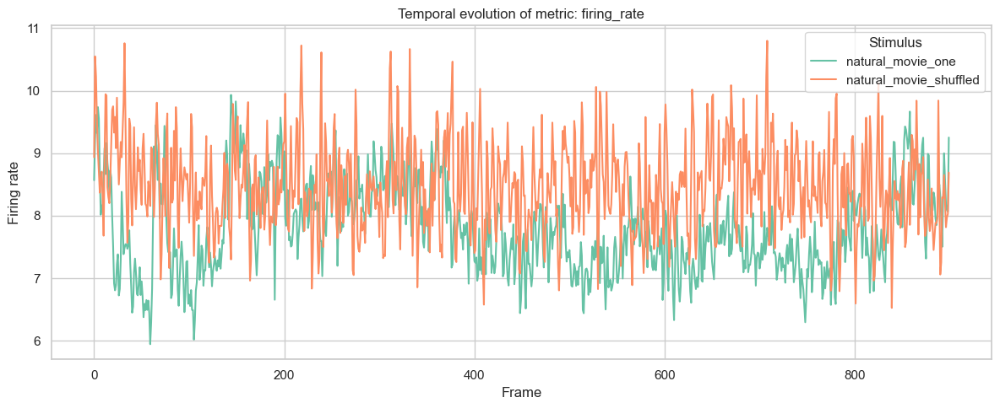

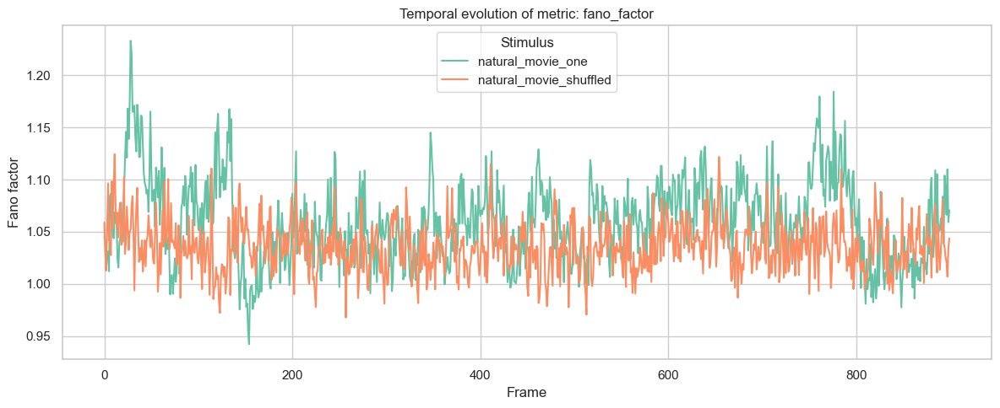

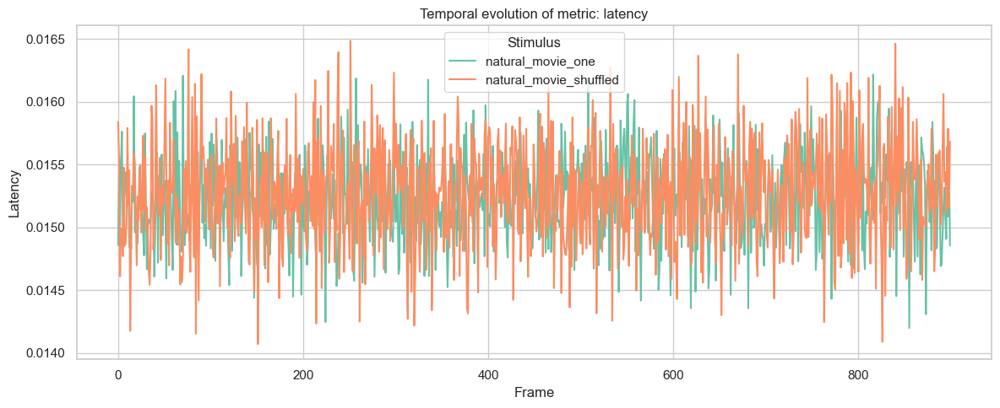

In [132]:
mean_metrics = df_time_metrics.groupby(["stimulus", "frame"])[["firing_rate", "fano_factor", "latency"]].mean().reset_index()

# Plotting
metrics = ["firing_rate", "fano_factor", "latency"]

for metric in metrics:
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=mean_metrics, x="frame", y=metric, hue="stimulus", palette="Set2")
    plt.title(f"Temporal evolution of metric: {metric}")
    plt.xlabel("Frame")
    plt.ylabel(metric.replace("_", " ").capitalize())
    plt.legend(title="Stimulus")
    plt.tight_layout()
    plt.show()

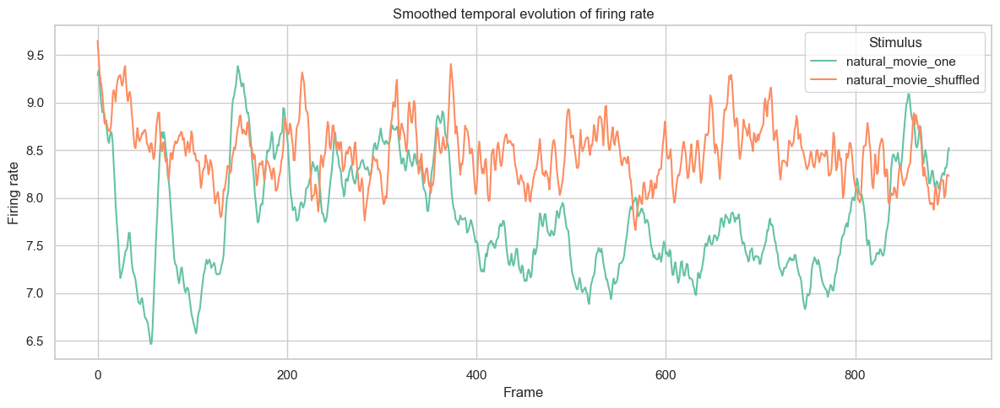

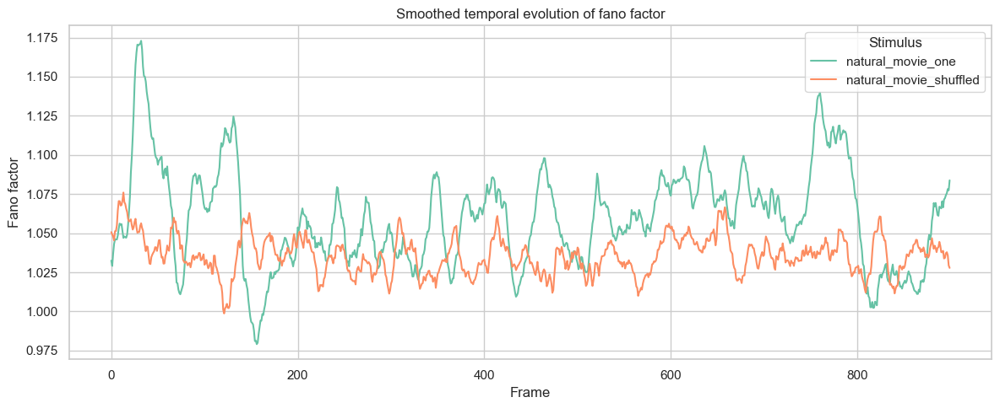

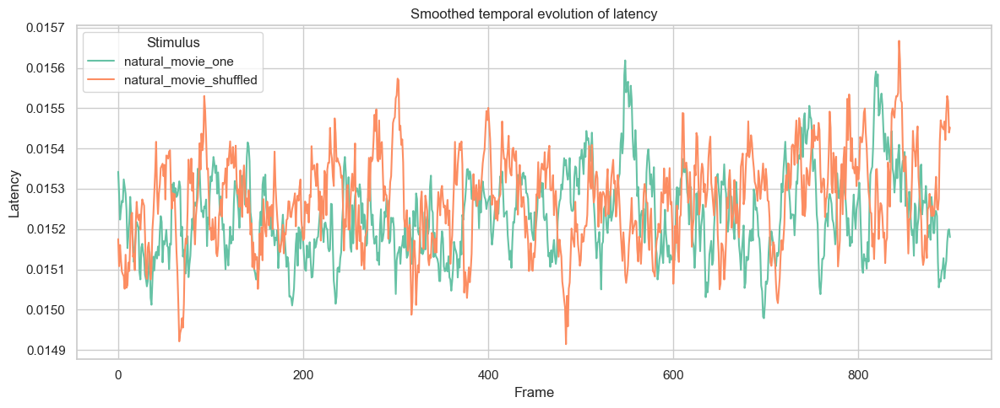

In [133]:
smoothed_metrics = []
window = 10  

for stim in mean_metrics["stimulus"].unique():
    stim_df = mean_metrics[mean_metrics["stimulus"] == stim].sort_values("frame")
    for metric in ["firing_rate", "fano_factor", "latency"]:
        smoothed = stim_df[[metric]].rolling(window=window, center=True, min_periods=1).mean()
        stim_df[f"{metric}_smoothed"] = smoothed
    smoothed_metrics.append(stim_df)

smoothed_df = pd.concat(smoothed_metrics)

# Plotting
metrics = ["firing_rate", "fano_factor", "latency"]

for metric in metrics:
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=smoothed_df, x="frame", y=f"{metric}_smoothed", hue="stimulus", palette="Set2")
    plt.title(f"Smoothed temporal evolution of {metric.replace('_', ' ')}")
    plt.xlabel("Frame")
    plt.ylabel(metric.replace("_", " ").capitalize())
    plt.legend(title="Stimulus")
    plt.tight_layout()
    plt.show()

We look more detail how this behavior changes in each area of the brain.

In [ ]:
mean_metrics = df_time_metrics.groupby(["stimulus", "frame", "area"])[["firing_rate", "fano_factor", "latency"]].mean().reset_index()

metrics = ["firing_rate", "fano_factor", "latency"]

# Plotting
for metric in metrics:
    areas = mean_metrics['area'].unique()
    for area in areas:
        plt.figure(figsize=(12, 5)) 
        
        area_data = mean_metrics[mean_metrics['area'] == area]
        sns.lineplot(data=area_data, x="frame", y=metric, hue="stimulus", palette="Set2", linewidth=2)
        plt.title(f"Comparison of {metric} for different stimuli in {area} area")
        plt.xlabel("Frame")  
        plt.ylabel(metric.replace("_", " ").capitalize())  
        plt.legend(title="Stimulus")  
        plt.tight_layout()
        plt.show()

In [ ]:
window = 10
mean_metrics_smooth = (
    mean_metrics
    .sort_values(["area", "stimulus", "frame"])
    .groupby(["area", "stimulus"])[["firing_rate", "fano_factor", "latency"]]
    .transform(lambda x: x.rolling(window, min_periods=1).mean())
)
mean_metrics_rolled = mean_metrics.copy()
mean_metrics_rolled[["firing_rate", "fano_factor", "latency"]] = mean_metrics_smooth

for metric in metrics:
    areas = mean_metrics_rolled["area"].unique()
    for area in areas:
        plt.figure(figsize=(12, 5)) 
        
        area_data = mean_metrics_rolled[mean_metrics_rolled['area'] == area]
        sns.lineplot(data=area_data, x="frame", y=metric, hue="stimulus", palette="Set2", linewidth=2)
        plt.title(f"Comparison of {metric} (smoothed) for different stimuli in {area} area")
        plt.xlabel("Frame")  
        plt.ylabel(metric.replace("_", " ").capitalize())  
        plt.legend(title="Stimulus")  
        plt.tight_layout()
        plt.show()

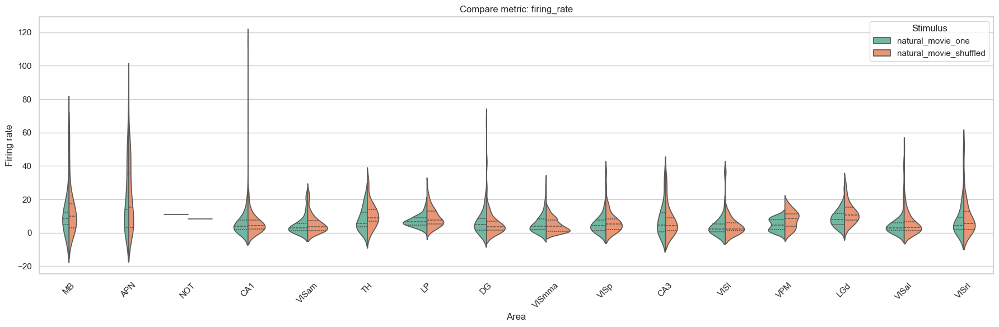

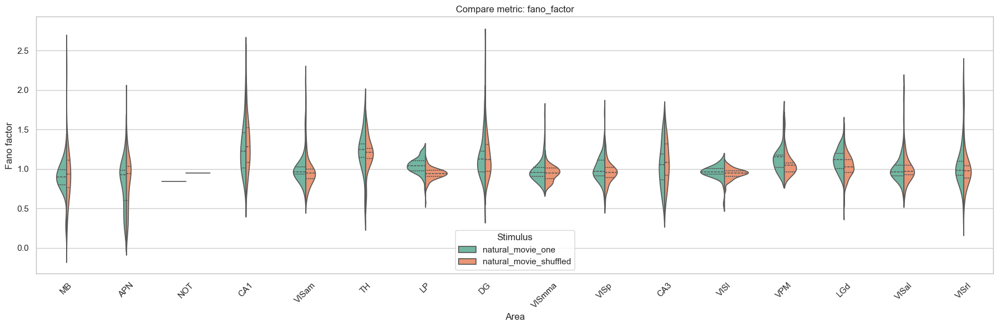

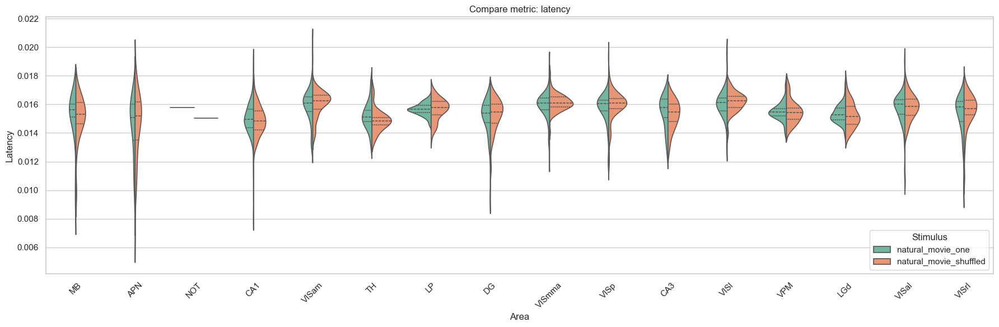

In [136]:
df_violin_area = (
    df_time_metrics
    .groupby(["unit_id", "stimulus", "area"])[["firing_rate", "fano_factor", "latency"]]
    .mean()
    .reset_index()
)
metrics = ["firing_rate", "fano_factor", "latency"]

for metric in metrics:
    plt.figure(figsize=(18, 6))
    sns.violinplot(
        data=df_violin_area,
        x="area",
        y=metric,
        hue="stimulus",
        split=True,
        inner="quartile",
        palette="Set2"
    )
    plt.title(f"Compare metric: {metric}")
    plt.xlabel("Area")
    plt.ylabel(metric.replace("_", " ").capitalize())
    plt.xticks(rotation=45)
    plt.legend(title="Stimulus")
    plt.tight_layout()
    plt.show()

We observe that, differently from before, the scores are distributed in a much similar way.